---

_You are currently looking at **version 1.1** of this notebook. To download notebooks and datafiles, as well as get help on Jupyter notebooks in the Coursera platform, visit the [Jupyter Notebook FAQ](https://www.coursera.org/learn/python-machine-learning/resources/bANLa) course resource._

---

# Applied Machine Learning: Module 2 (Supervised Learning, Part I)

## Preamble and Review

In the previous module, you saw a basic sample of supervised machine learning using a k-nearest neighbor classifier, classifying different types of fruit based on their various physical properties. Machine learning algorithms of this type are called supervised learning algorithms because they use labeled examples in the training set to learn how to predict the labels for new, previously unseen examples. The supervised aspect refers to the need for each training example to have a label in order for the algorithm to learn how to make accurate predictions on future examples. This is in contrast to unsupervised machine learning where we don't have labels for the training data examples, and we'll cover unsupervised learning in a later part of this course.

This week, we'll explore supervised learning in a bit more depth, going beyond k-nearest neighbors classifiers to several other widely used supervised learning algorithms. Because this is an applied machine learning course, we're not going to cover too much of the mathematical derivation or the detailed innerworkings of these algorithms. For that, you can check out a number of more technical machine learning courses such as Andrew Ng's excellent course on Machine Learning on Coursera.

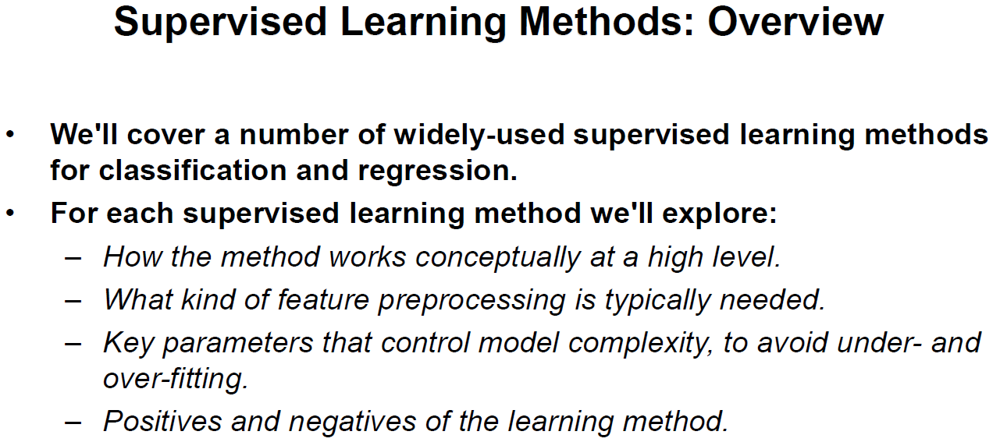

Instead, we'll focus on some higher-level goals. How to apply a number of specific supervised machine learning algorithms and how to interpret their results for important tasks. This will include understanding how supervised learning algorithms estimate their parameters from data, how the train model makes predictions for new instances, the strengths, weaknesses and best scenarios to apply a particular method and how to use the method with its parameter settings in Python programs using scikit-learn. Across all of these algorithms we'll discuss some general principles that are critical to machine learning, like the issue of overfitting and how overfitting relates to a models complexity. And which parameters typically can be used to control model complexity in order to obtain good performance on previously unseen data.

In this module we won't have time to cover all the different parameters for the various supervise learning methods. So we'll focus on a small number of the most important parameters. The full details of all the supervised algorithms we'll cover this week are in the excellent online documentation that's provided with scikit learn to which we've included links in the supplemental material for this course.

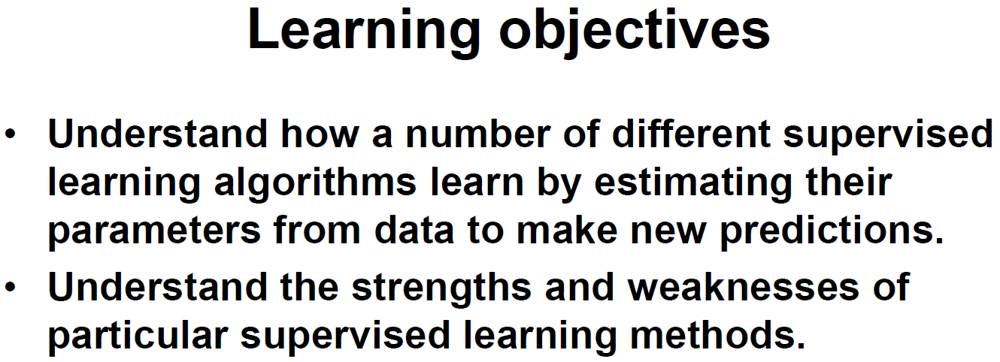

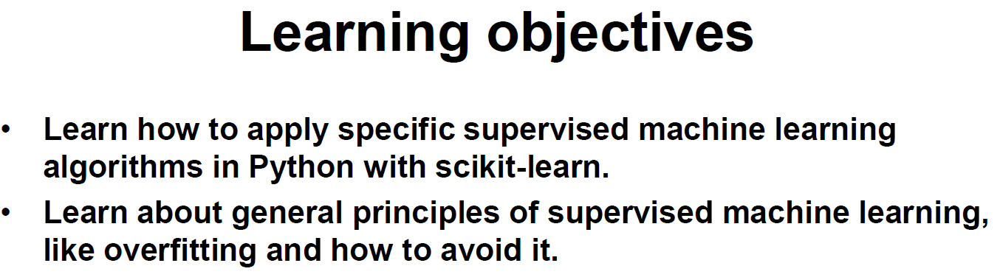

Before we continue, let's review some basic terms. So, on the right, here I'm showing the dump of the first few rows of the fruit dataset that you worked with last week. The first term that we will be using a lot is feature representation. And as you might recall what that means is taking an object like a piece of fruit and converting it into numbers that the computer can understand. So in this dataset, the feature representation for a piece of fruit consists of these columns, the mass, width, height, and color_score. These are the things that will be used as the features in the various machine learning algorithms that we'll be applying to try to predict the label of a piece of fruit. So typically each column in the dataset here corresponds to a different feature that's associated with each instance.

I use the term instance or sample or example somewhat interchangeably. Most of the time I'll be talking about instances or samples. So each row of this dataset corresponds to one piece of fruit or one specific data instance per sample. When we work with these instances in Python, the convention we'll be using is that we'll put the all the variables that represent the features in this variable capital X here. So capital X refers to all the feature columns that will be going into as the inputs for the predictor.

And then we have the very important concept of a label. So each instance here, each piece of fruit has a label that's been assigned by a human in this case, and the label is an example of a target value. So in classification, the target value is label of an object and in regression, it's the particular continuous value you might want to predict from the inputs. And we use lower case y in Python for the variable name to hold the target values associated with each instance. 

So if you look at the dataset as being say this big block here. Typically that'll be a column of labels and then a matrix of multiple columns holding the features that we will be using. And then we have a couple of columns in here: the fruit name and the fruit subtype that are used only for labeling purposes to make things like plots, more readable for humans. The things that go into the actual machine learning algorithms are the label for training through the Y variable and the features, the mass with height and color score that are in the X variable.

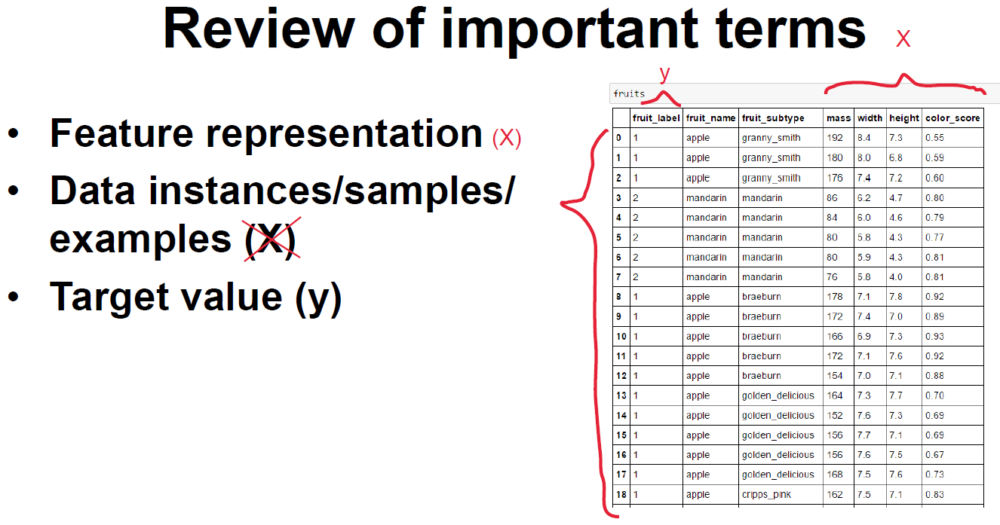

Another concept that we saw from our first example. The concept of training and test sets. So by that we mean a just to recap we think of the entire data said here is a rectangle So this could be the fruit which is showed previously. We typically sign a chunk of the original dataset and make that the training set, and then we reserve typically a smaller portion, that's the test set. So the default split in scikit learn is typically 75, 25.

The function train_test_split here is a very handy function in scikit learn that takes the original set of features X and the labels y and does the partitioning into a training and test set. The variables that we'll be using to denote training and test set are X_train for the training set features and y_train for the training set labels. And then X_test for the test set features and y_test for the test set labels. Once we pass the training data into a classifier, so as you recall, we can create here KNeighborsClassifier by invoking this constructor and passing it the number of neighbors that we want the algorithm to use. The training set is used to estimate the parameters for a model.

In scikit learn, there's an object called an estimator, which is either classify or regressor for example. And the goal of this estimator, this model, is to learn how to classify or predict target values for new data instances. So the procedure where we pass in a training set to learn those parameters that are internal to the estimator, is called a model fitting, and the result of model fitting is a trained model.

An example of that in the code here is after we create the knn variable that has the knn neighbors classifier object, we use the fit method on the training data and the training labels to update the internal state of the knn object, and that's the training process. So after that line of code is finished running, the internal state of the knn classifier has been updated to reflect the training data's influence on the internal parameters of the knn classifier, and now it's ready to be used.

Evaluation methods are typically the next step where after we've fit the model, we want to see how well it actually does on the test data. So in week 3 of the course we're going to cover in detail different ways of evaluating classifiers and regressions. But for now, we'll look at accuracy. The score method applied to the classifier will take the test data in X_test and y_test and output the accuracy score of this particular classifier on the test set. And finally we can also apply the predict method to the knn object to get the predicted label for previously unseen instances.

So these are the terms that would be using throughout the course and we will also be maintaining a fairly consistent use of these variable names throughout all the Python code that we use.

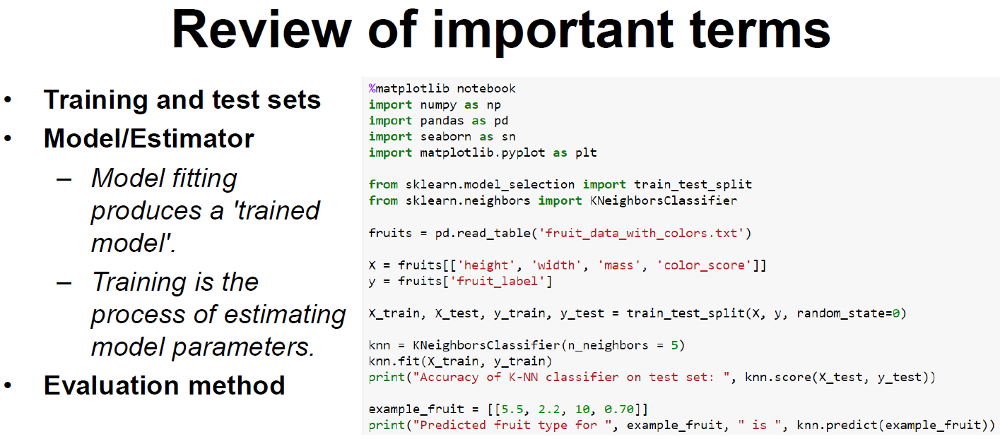

In [34]:
# %matplotlib inline 
%matplotlib notebook  
import numpy as np
import pandas as pd
import seaborn as sn
import matplotlib.pyplot as plt
plt.style.use('seaborn')

from sklearn.model_selection import train_test_split
from sklearn.neighbors import KNeighborsClassifier

np.set_printoptions(precision=2)


fruits = pd.read_table('../readonly/fruit_data_with_colors.txt')

feature_names_fruits = ['height', 'width', 'mass', 'color_score']
X_fruits = fruits[feature_names_fruits]
y_fruits = fruits['fruit_label']
target_names_fruits = ['apple', 'mandarin', 'orange', 'lemon']

X_fruits_2d = fruits[['height', 'width']]
y_fruits_2d = fruits['fruit_label']

X_train, X_test, y_train, y_test = train_test_split(X_fruits, y_fruits, random_state=0)

from sklearn.preprocessing import MinMaxScaler
scaler = MinMaxScaler()
X_train_scaled = scaler.fit_transform(X_train)
# we must apply the scaling to the test set that we computed for the training set
X_test_scaled = scaler.transform(X_test)

knn = KNeighborsClassifier(n_neighbors = 5)
knn.fit(X_train_scaled, y_train)
print('Accuracy of K-NN classifier on training set: {:.2f}'
     .format(knn.score(X_train_scaled, y_train)))
print('Accuracy of K-NN classifier on test set: {:.2f}'
     .format(knn.score(X_test_scaled, y_test)))

example_fruit = [[5.5, 2.2, 10, 0.70]]
example_fruit_scaled = scaler.transform(example_fruit)
print('Predicted fruit type for ', example_fruit, ' is ', 
          target_names_fruits[knn.predict(example_fruit_scaled)[0]-1])

Accuracy of K-NN classifier on training set: 0.95
Accuracy of K-NN classifier on test set: 1.00
Predicted fruit type for  [[5.5, 2.2, 10, 0.7]]  is  mandarin


Supervised learning can be divided into two different types of tasks, classification and regression. Both classification and regression take a set of training instances and learn a mapping to a target value.

For classification, the target value is a discrete class value. For example, a binary classification problem has a two types of target values. A 0 representing the negative class or 1 representing the positive class. An example of binary classification might be trying to detect a fraudulent credit card transaction. The transaction is either valid or invalid.

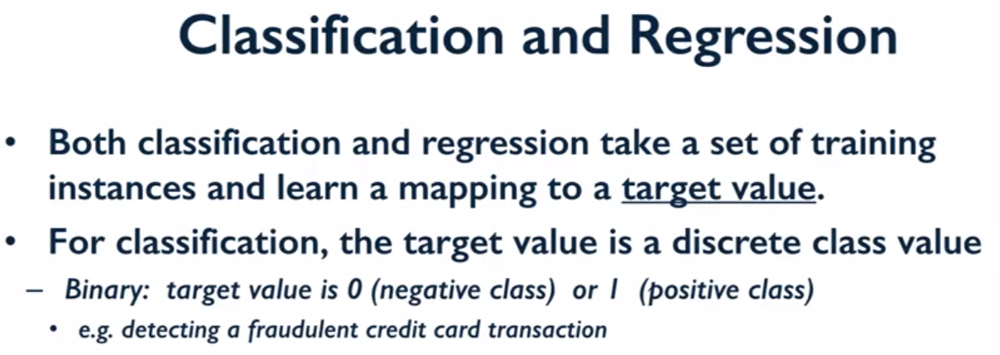

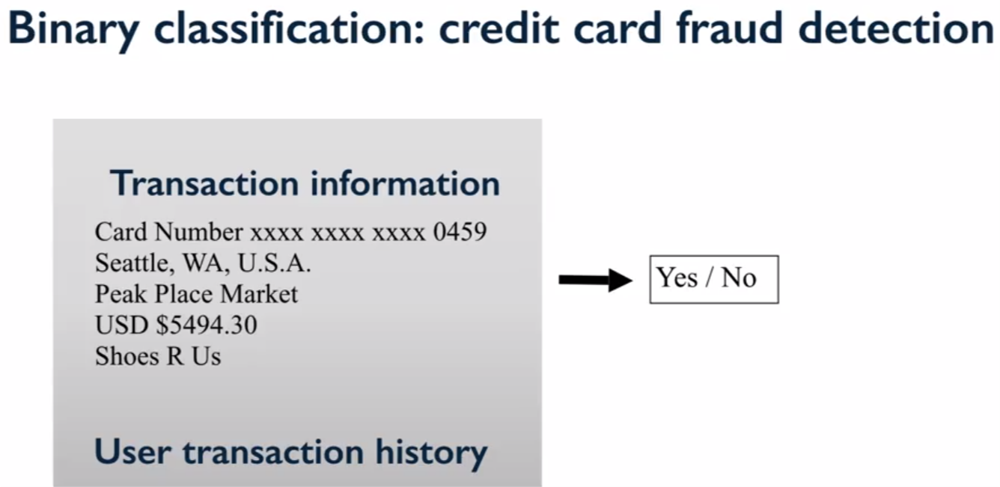

The second type of classification problem is known as multi-class classification, where the target value is more then just a yes or no, or 1 or 0, it could be one of a set of discrete values. For example, the labeling fruit example that we saw from the first part of the course is an example of multi-class classification because the object that we're trying to predict the label for can only have 1 of the possible label types. Something couldn't be, for example, both an apple and an orange.

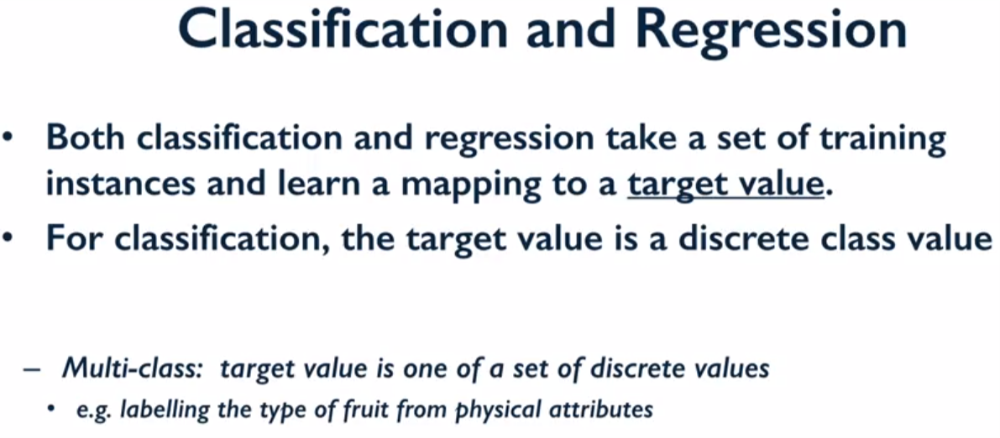

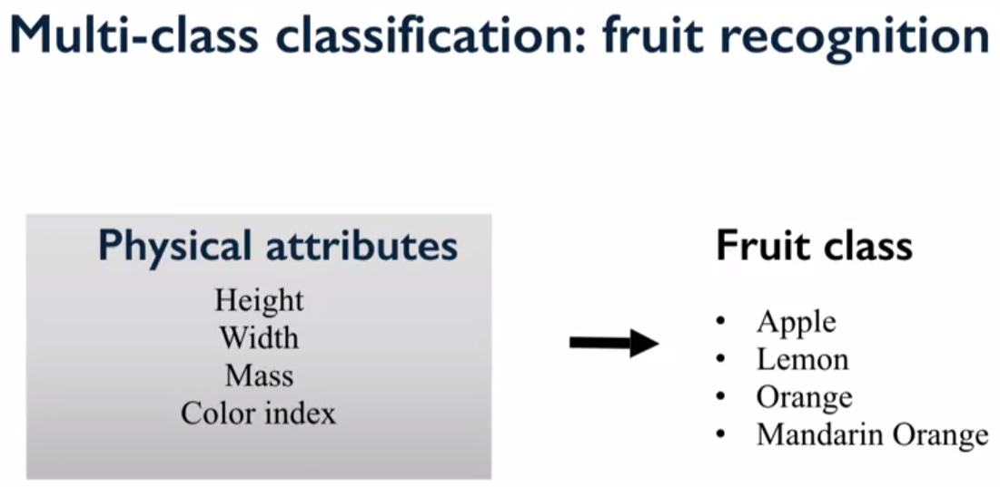

The third category of classification is called multi label classification with our multiple target values. For example, we might want to take a web page and label all the different topics discussed on that page as shown in this example.

Here we see a page from Microsoft research where the multi-label classification has decided that the labels computing, science, and so forth are applicable.

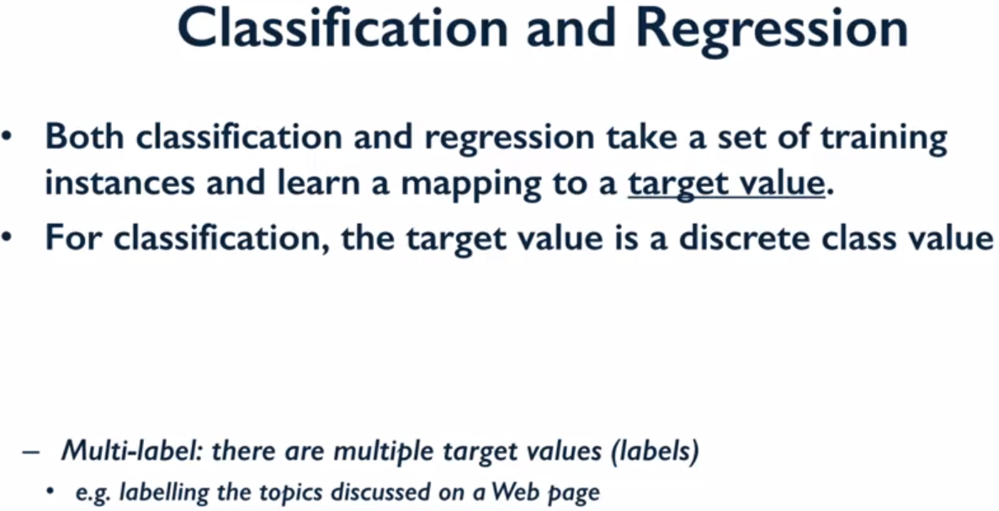

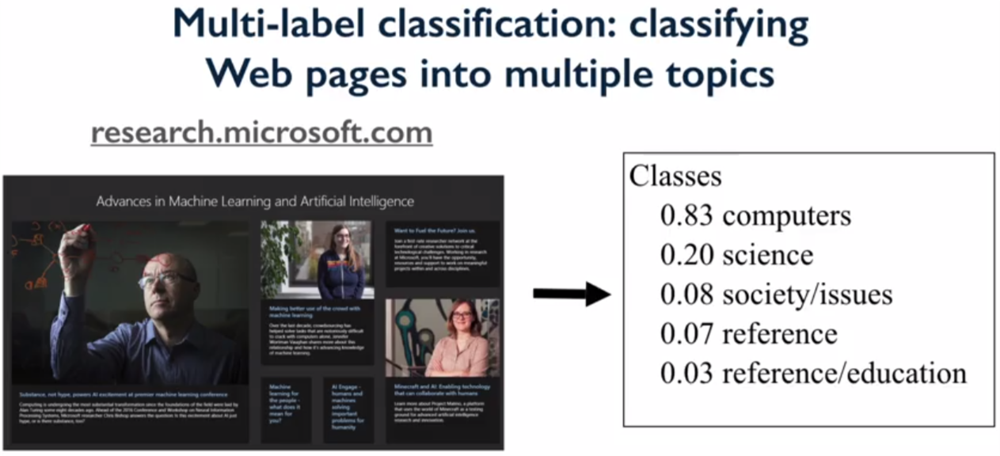

In contrast to classification, for regression, the target we're trying to predict is a continuous value. For example, a model that predicts the market price of a house, given how many rooms it has, where its located, the size of the land that it sits on and so forth, would be a regression problem. Because the market price is continuous, otherwise known as a real value variable.

You can tell what type of supervisor learning method you should apply to a given problem by thinking about the meaning of the target value. Does the target value represent something that's one of a set of mutually exclusive class values as in the case of assigning a label to a piece of fruit? Or whether or not a transaction is fraudulent? If so, it's a classification problem.

On the other hand, if the target is a real value quantity like cost, or income, or height then it can be treated as a regression problem.

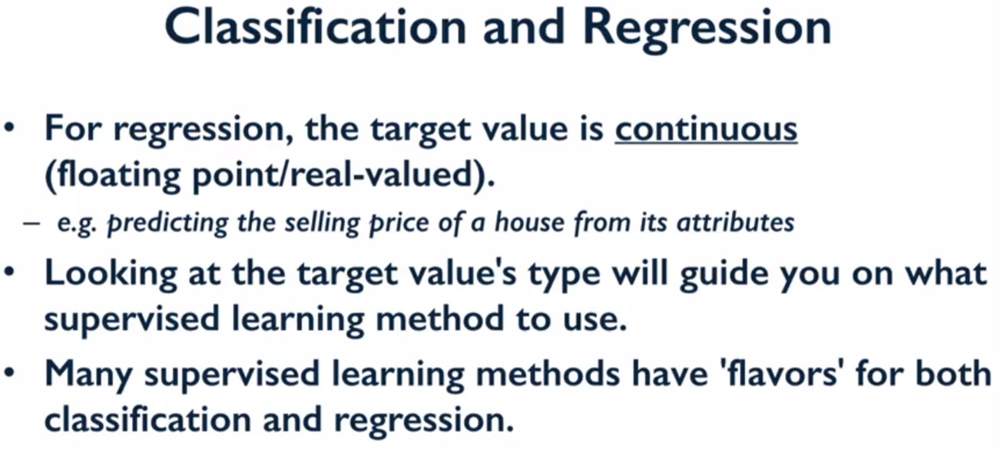

Finally, we'll see that many supervised learning methods come in both flavors of classification and regression. For example, support vector classifiers which we'll cover shortly also has a regression version called not surprisingly support vector regression.

In this course, we'll cover both classification and regression methods, although we'll spend the majority of our time on classification since that represents a big set of important machine learning tasks, and because classification involves some additional concepts and methods especially in areas like evaluation that aren't needed as much for regression. 

To start with, we'll look at two simple but powerful prediction algorithms. K-nearest neighbors, which we saw in week 1 and linear model fitting using least-squares. These two prediction methods represent two complimentary approaches to supervised learning. K-nearest neighbors doesn't make a lot of assumptions about the structure of the data and gives potentially accurate, but sometimes unstable predictions. And by unstable I mean that it can be sensitive to small changes in the training data.

On the other hand, linear models make strong assumptions about the structure of the data. In other words, that the target value can be predicted just using a weighted sum of the input variables, a linear function. It can give stable, but potentially inaccurate predictions.

In addition to k-nearest neighbors and linear models, we'll cover a variety of widely used supervised learning methods for classification and regression. Including decision trees, kernelized support vector machines and neural networks. For each method we'll explore how it works at a high level without going into too much mathematical details.

We'll also look at what kind of feature preprocessing is typically needed. And for almost all of the supervised learning algorithms we'll look at, there are 1 or more parameters that control its model complexity, so we'll see how to set these parameters to help avoid under and over fitting.

Finally, we'll discuss the positives and negatives of each supervised learning approach to help understand what are the best scenarios in which to apply or not apply that particular method.

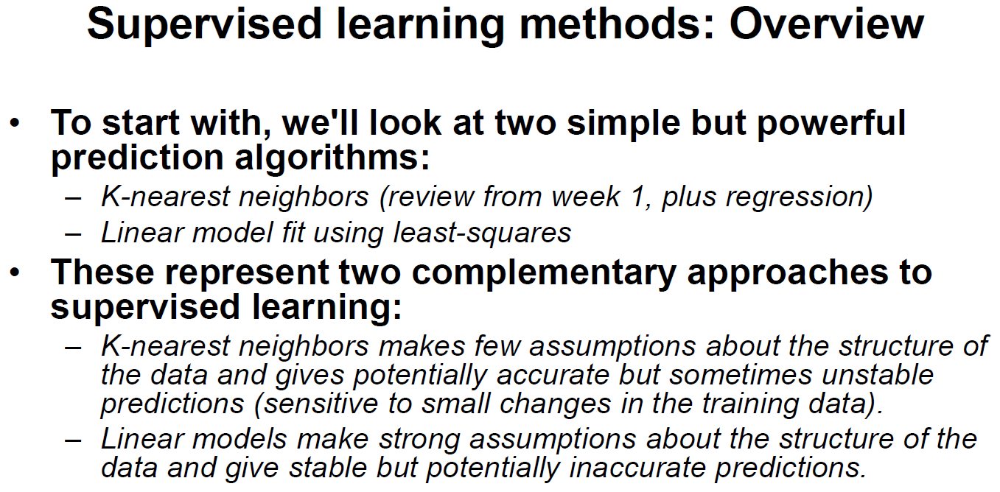

One consistent pattern you'll see as we look at all these different methods, is the relationship between model complexity and model accuracy, as shown in this plot.

The relationship is different depending on whether the classifier performance is measured on the training set, what is labeled here as Training Set score, or in the test set labeled here as Test Set score. When measuring performance against the training set, the same one that was used to train the classifier, this plot shows that as a model's complexity increases (think of the knn classifier with k decreasing and with more and more highly variable and a detailed decision boundaries), the model's accuracy on the training set trends upward as the more complex models fit the training data better and better.

However, when the same trained model is evaluated on the held out test set, there's typically an initial accuracy gain from the increasing model complexity up to some optimal point. But then a decrease in test set accuracy as the increasingly complex models begin to overfit too specifically to the training data, and don't capture more global patterns that help it generalize well to unseen testing. Now the specifics of these trends will vary from situation to situation, but overall we'll see this pattern across the supervised learning methods that we'll examine.

You'll be hearing a lot about models in this course. What is a model? Well, it's a specific mathematical or computational description that expresses the relationship between a set of input variables and one or more outcome variables that are being studied or predicted. In statistical terms the input variables are called independent variables and the outcome variables are termed dependent variables. In Machine Learning we use the term features to refer to the input, or independent variables. And target value or target label to refer to the output, dependent variables.

Models can be either used to understand and explore the structure within a given dataset, as we'll see in unsupervised learning, or in the case of supervised learning methods, our goal is to develop predictive models that can accurately predict the outcome, in other words, the target value or label for previously unseen input data.

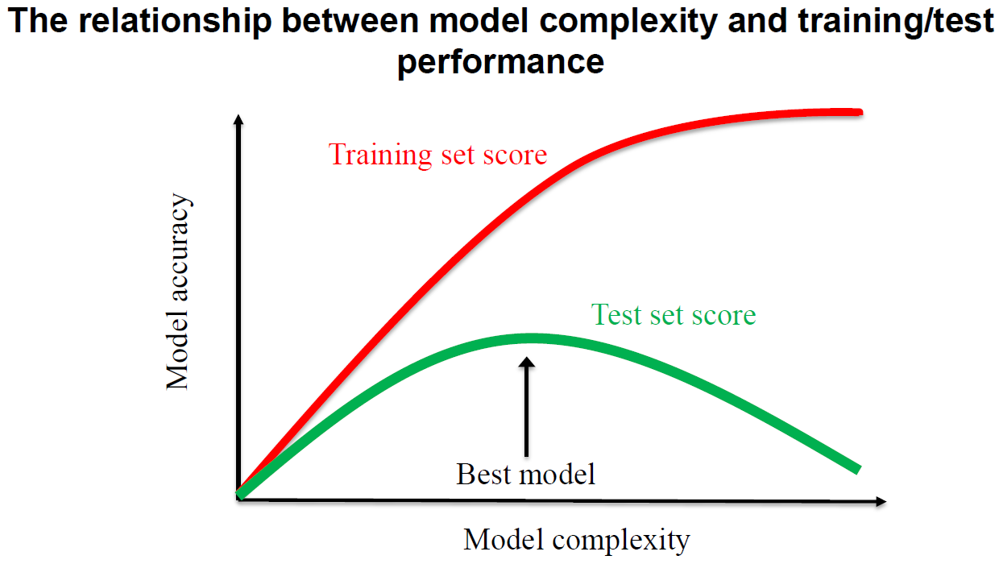

When we build the supervised learning model, whether it's for classification or regression, it's not only important for the model to make correct predictions on the examples it saw in the training data. If that were the only definition of success, then supervised learning algorithms could simply memorize all of the training data and always have a 100 percent accuracy. Of course, that's not what happens in the real world. What we actually want from a supervised machine learning algorithm is the ability to predict a class or target value correctly on a test set of future examples that haven't been seen before. This ability to perform well on a held out test set is the algorithms ability to generalize. 

How do we know that our trained supervised model will generalize well? In other words, perform well on an unseen test set. Well, typically machine learning makes an important assumption that the future test set has the same properties, or, more technically, is drawn from the same underlying distribution as the training set. This means that if we observe our model has good accuracy on the training set, and the training set and test sets are similar, we can also expect that it will do well on the test set. Unfortunately, sometimes this doesn't happen due to an important problem known as 'overfitting'. Informally, overfitting typically occurs when we try to fit a complex model with an inadequate amount of training data. And overfitting model uses its ability to capture complex patterns by being great at predicting lots of specific data samples or areas of local variation in the training set. But it often misses seeing global patterns in the training set that would help it generalize well on the unseen test set. 

It can't see these more global patterns because, intuitively, there's not enough data to constrain the model to respect these global trends. As a result, the training set accuracy is a hopelessly optimistic indicator for the likely test set accuracy if the model is overfitting. Understanding, detecting, and avoiding overfitting is perhaps the most important aspect of applying supervised machine learning algorithms that you should master. There are serious real world consequences to overfitting. The reading for this week contains one example from the medical world you might find interesting. 

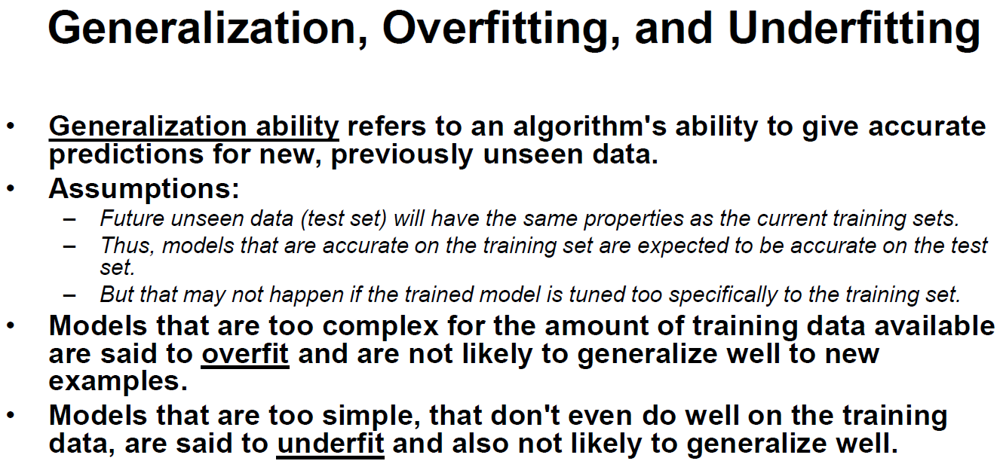

To understand the phenomenon of overfitting better, let's look at a few visual examples. The first example that we'll look at for overfitting involves regression. In this chart on the x axis, we have a single input variable that might be, for example, the size of a piece of property. And we have a target variable on the y axis. For example, this might be that market selling price of a house that sits on that piece of property. So in regression, we're looking to find the relationship between the input variable and the target variable. And we start off with the idea of a model that we want to fit that might explain this relationship. 

So, one example of a model that we could try to fit would be a linear model. So trying to predict that there's a linear relationship between the input variable and the target variable. So, the regression model might fit a straight line to these points. In this case the model has under-fit the data. The model is too simple for the actual trends that are present in the data. It doesn't even do well on the training points. So these blue points would represent the training points, the input to the training process for the regression. And when we underfit, we have a model that's too simple, doesn't even do well on the training data and thus, is not at all likely to generalize well to test data. 

On the other hand, if we pick a better model, for example, the idea that this might be a quadratic relationship, we might actually be able to apply that and get what looks like a much better fit. So this would be example of a reasonably good model fit. We've captured both the general trend of the points while also ignoring the little variations that might exist due to noise. 

A third example might be, we might hypothesize that the relationship between the input variable and the target variable is a function of several different parameters. Let's say, a polynomial so something that's very bumpy. If we try to fit a more complex model to this set of training data, we might end up with something that looks like this. So, this more complex model has more parameters so it's able to capture more subtle behavior. But it's also much higher variance here as you can see so it's more focused on capturing the more local variations in the training data rather than trying to find the more global trend that we can see as humans in the data. So, this is an example of overfitting. In this case there's not enough data to really constrain the parameters of the model enough so that it can recognize the global trend. 

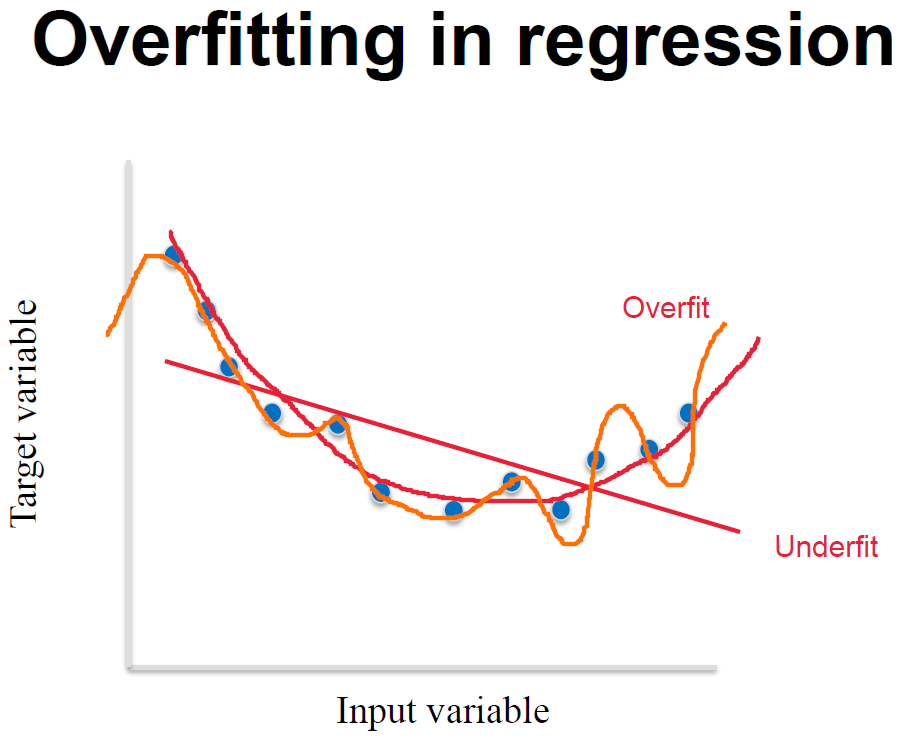

The second example will look at overfitting is classification. So, this diagram shows a simple two dimensional classification problem where each data instance is represented by a point, and where there are two features associated with each data instance. This is a binary classification problem so points are labeled either red or blue. And the problem in classification is to find a decision boundary. So as we saw with K nearest neighbors, we want to take this feature space and find regions that are associated with the different labels. So, one type of classifier that we'll look at shortly is called the linear classifier where we try to find a decision boundary that's essentially a straight line through the space. So just as in regression, we can have underfitting models, good fitting models, and overfitting models. 

An example of an underfitting model would be something that really didn't look much at the data. Maybe something like this that only looked at one feature for example. So again, this is an overly simplistic model. It doesn't even capture the patterns, or the division between the classes in the training data well and so would be unlikely to generalize, so this in an underfitting model. 

A reasonably good model that fits well would be a linear model that finds this general difference between the positive class over here and the negative class over here. So you can see that it's aware of this sort of global pattern of having most of the blue negative points in the upper left and most of the red positive points more toward the lower right. And it's robust enough in the sense that it ignores the fact that there may be occasionally a blue point in the red region or red point in the blue region. Instead, it's found this sort of more global separation between these two classes. So, this is a reasonably well fitting model. 

An overfitting model on the other hand would typically be a model that has lots of parameters so it can capture complex behavior. And so, it would try to find something very clever, where it tried to completely separate the red points from the blue points in a way that resulted in a highly variable decision boundary. So this has the advantage that, a questionable advantage, that it does capture the training data classes very well. It predicts the training data classes almost perfectly. But as you can see, if the actual division between the classes is captured by this linear model, the overfit model is going to make lots of mistakes in the regions where it's trying to be too perfect in some sense. So, you'll see this typically with overfitting. The overfit model is highly variable. And again, it's trying to capture too many of the local fluctuations and does not have enough data to see the global trend that would result in better overall generalization performance on new unseen data. 

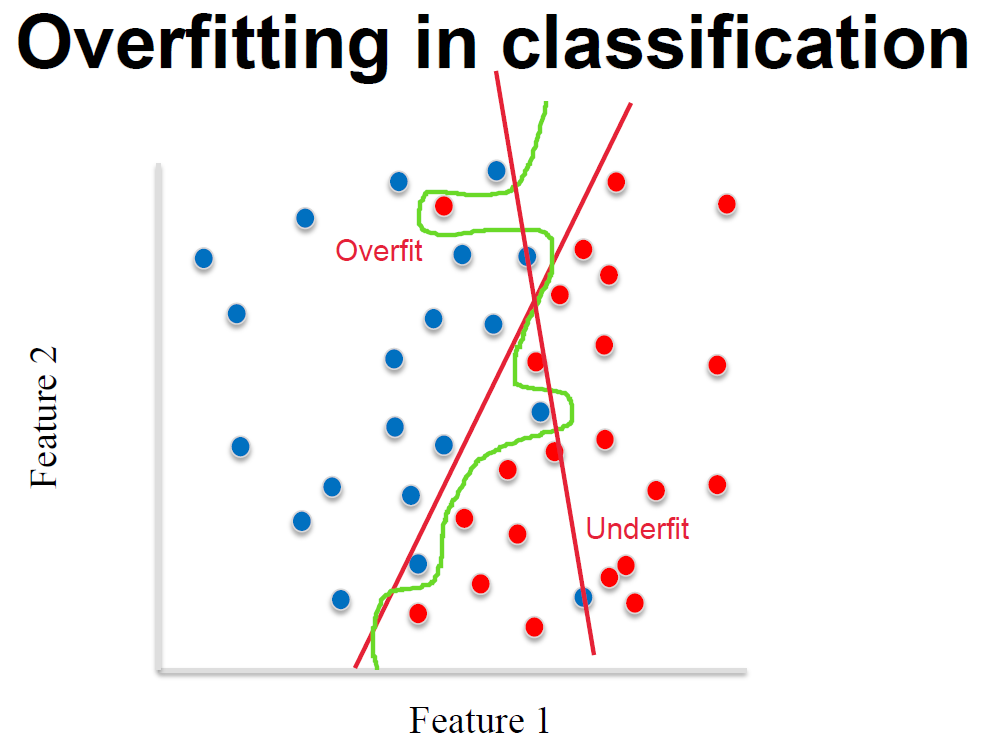

This third example shows the effect of modifying the K parameter in the K nearest neighbors classifier that we saw previously. The three plots shown here show the decision boundaries for K=10, K=5, and K=1. And here we're using the fruit dataset again with the height of a piece of fruit on the x axis and the width on the y axis. 

So the K=10 case, as you recall, K=10 means that, for each query point that we want to get a prediction for, let's say over here, we have to look at the 10 nearest points to the query point and we'll take those. We won't go through all 10 here, but let's just say there are several here that are nearby and will average or combine their votes to predict the label for this point. So in the K=10 case, we need the votes from 10 different data instances in the training set to make our prediction. And as we reduce K, so K=5, we only need 5 neighbors to make a prediction. So for example, if the query point was here, we'd look at these four and then possibly whatever was the closest in this let's say, that one or this one. And then finally, in the K=1 case, that's the most unstable in the sense that for any query point, we only look at the single nearest neighbor to that point. 

And so, the effect of reducing K in the k-nearest neighbors classifier is to increase the variance of the decision boundaries, because the decision boundary can be affected by outliers. If there's a point far, far away, it might have, it has much greater effect on the decision boundary in the K=1 case, than it would in the K=10 case, when the votes of 9 other neighbors are also needed. 

And so, you can see that by adjusting the value of K for the k-nearest neighbors classifier, we can control in some sense, the degree of model fitting that's appropriate for a dataset. Now, the actual value of k that works best can only be determined by evaluating on a test set. But the general idea is that as we decrease K for k-NN classifiers, we increase the risk of overfitting. Because, for the reasons I mentioned before, where K=1 for example, we're trying to capture very local changes in the decision boundary that may not lead to good generalization behavior for future data.

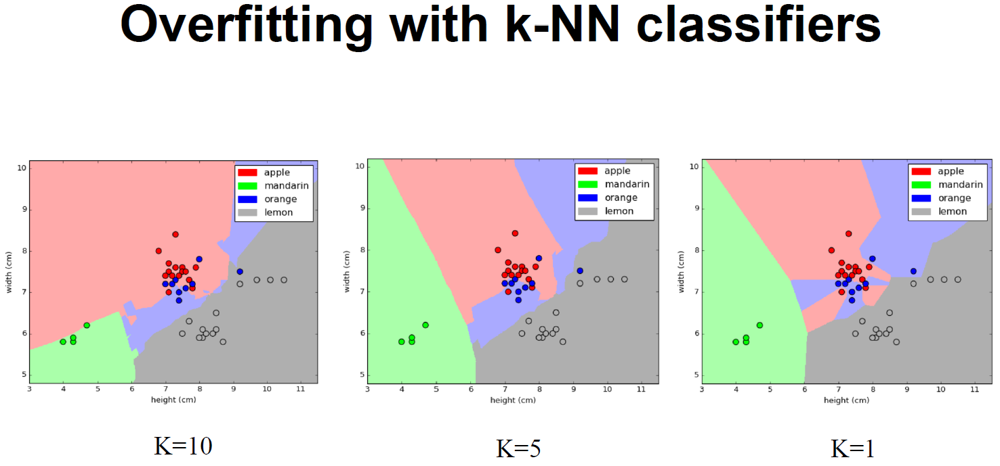

## Datasets

To explore different supervised learning algorithms, we're going to use a combination of small synthetic or artificial datasets as examples, together with some larger real world datasets. scikit learn has a variety of methods in the SK learn datasets library to create synthetic datasets. The synthetic dataset we'll use for illustration purposes are typically low dimensional examples. Because they only use a small number of features, typically one or two, this makes them easy to explain and visualize.

Many real world datasets, on the other hand have a higher dimensional feature space. In other words they have dozens, hundreds, or even thousands, or millions of features. So some of the intuition we gain from looking at low dimensional examples doesn't always translate to high dimensional datasets, and we'll discuss that a bit more later. For example, high dimensional data sets in some sense have most of their data in corners with lots of empty space and that's kind of difficult to visualize. We'll go through some examples later in the course. But the low dimensional examples are still useful so that we can understand things like how a model's complexity changes with changes in some key parameters.

So for basic regression we'll start with the simple problem that has one informative input variable. One noisy linear output and 100 data set samples. Here's a plot of a data set using scatter plot with each point represented by one dot. The x-axis shows the feature value, and the y-axis shows the regression target. To create this we use the make regression function in SK learn data sets. Here is the code in the notebook.

<IPython.core.display.Javascript object>


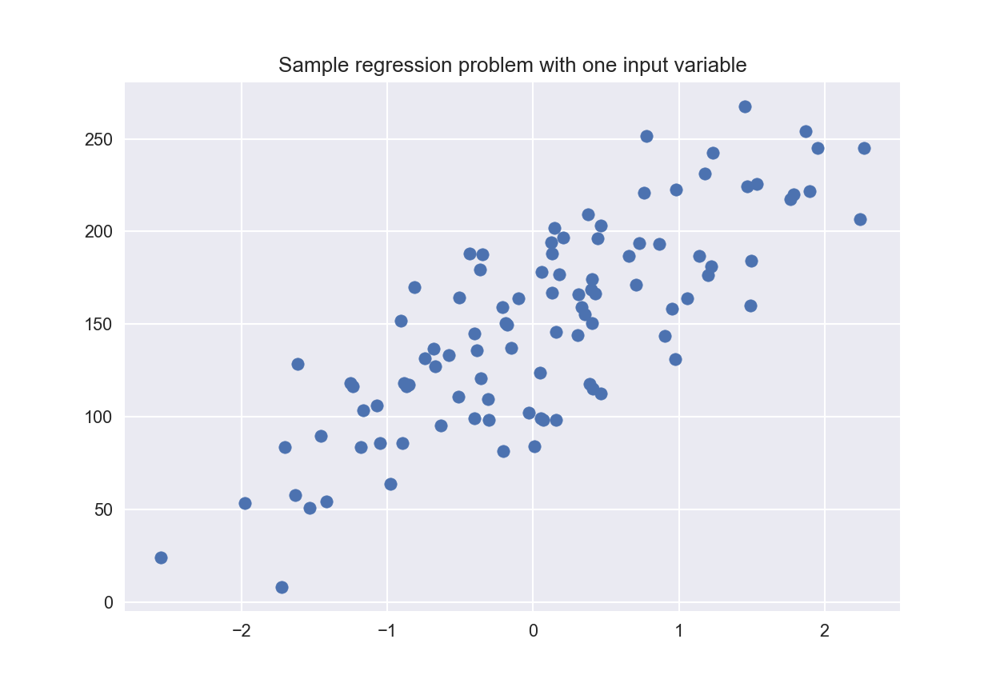

In [35]:
from sklearn.datasets import make_regression
from sklearn.datasets import make_friedman1
from sklearn.datasets import make_classification, make_blobs
from sklearn.datasets import load_breast_cancer
from adspy_shared_utilities import load_crime_dataset

from matplotlib.colors import ListedColormap

cmap_bold = ListedColormap(['#FFFF00', '#00FF00', '#0000FF','#000000'])


# synthetic dataset for simple regression
X_R1, y_R1 = make_regression(n_samples = 100, n_features=1,
                            n_informative=1, bias = 150.0,
                            noise = 30, random_state=0)
plt.figure()
plt.title('Sample regression problem with one input variable')
plt.scatter(X_R1, y_R1, marker= 'o', s=50)
plt.show()

<IPython.core.display.Javascript object>


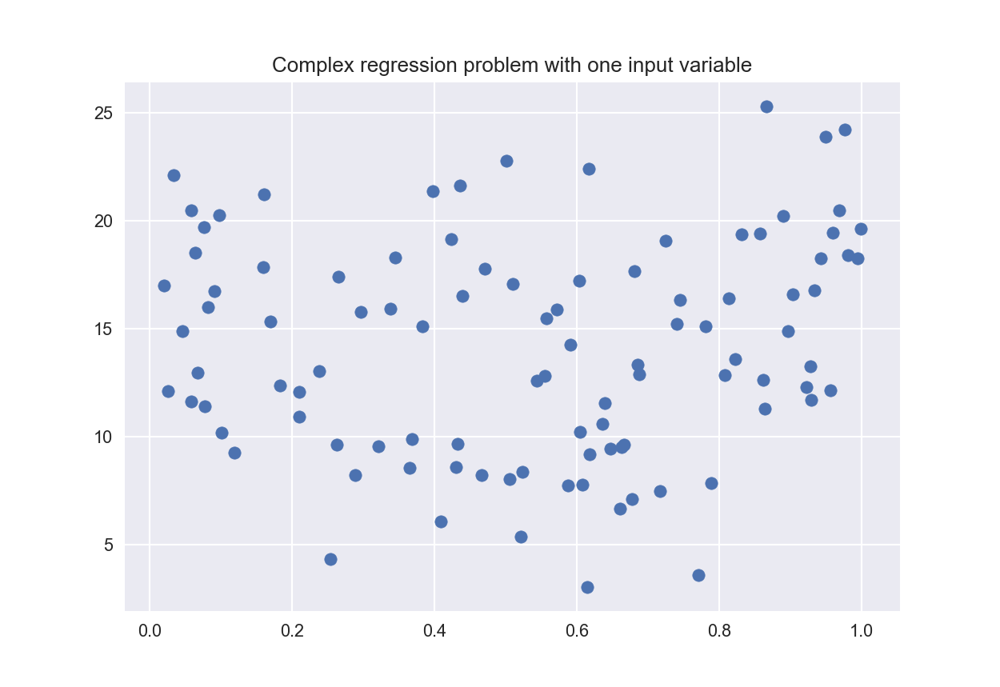

In [36]:
# synthetic dataset for more complex regression
X_F1, y_F1 = make_friedman1(n_samples = 100, n_features = 7, random_state=0)

plt.figure()
plt.title('Complex regression problem with one input variable')
plt.scatter(X_F1[:, 2], y_F1, marker= 'o', s=50)
plt.show()

To illustrate binary classification we will include a simple two class dataset with two informative features.

Here's a scatterplot showing each data instance as a dot with the first feature value corresponding to the x-axis. And the second feature value corresponding to the y-axis. The color of a point shows which class that data instance is labeled. I'm calling this dataset simple because it has only two features, both of which are informative.

In this case, these two classes are approximately linearly separable, which means that a basic linear classifier placed between them does a pretty good job of discriminating the points in the two classes. So turning to the notebook, to create this data set we used to make classification function in SK learn data sets. Creating 100 points that roughly group the data samples into one cluster per class, with here a 10% chance of randomly flipping the correct label of any point just to make it a little more challenging the classifier.

<IPython.core.display.Javascript object>


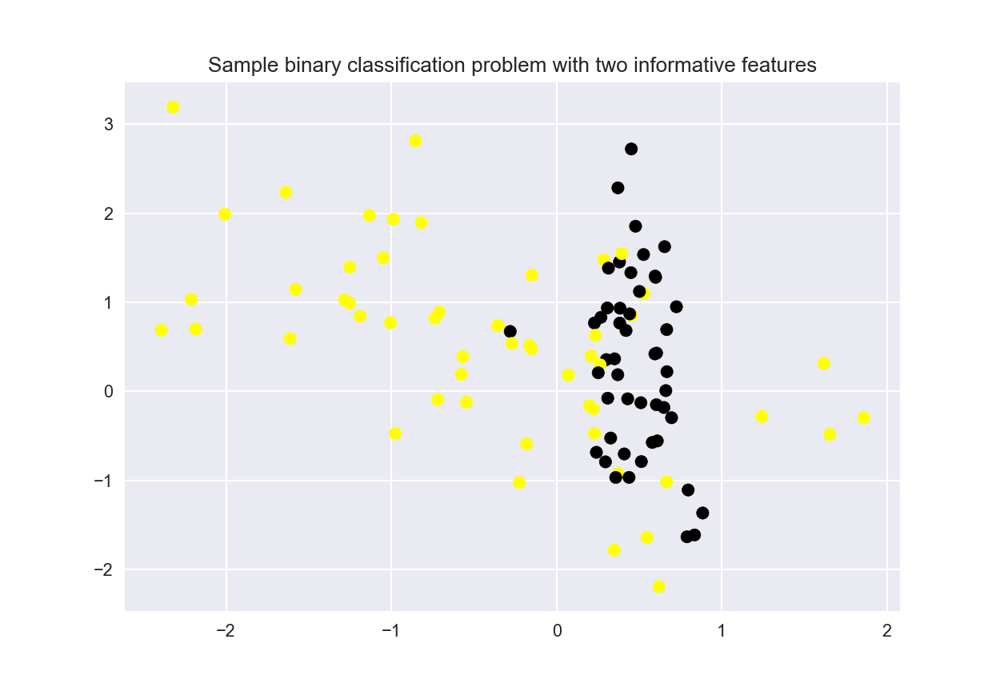

In [37]:
# synthetic dataset for classification (binary) 
X_C2, y_C2 = make_classification(n_samples = 100, n_features=2,
                                n_redundant=0, n_informative=2,
                                n_clusters_per_class=1, flip_y = 0.1,
                                class_sep = 0.5, random_state=0)
plt.figure()
plt.title('Sample binary classification problem with two informative features')
plt.scatter(X_C2[:, 0], X_C2[:, 1], c=y_C2,
           marker= 'o', s=50, cmap=cmap_bold)
plt.show()

We'll also look at a more complex binary classification problem that uses two features. But where the two classes are not really linearly separable, instead forming into various clusters in different parts of the feature space. 

This dataset was created in two steps. First using the make_blobs function in SK learn datasets to randomly generate 100 samples in 8 different clusters. And then by changing the cluster label assigned by make_blobs, which is a number from 1 to 8, to a binary number by converting it using a modulo 2 function. Assigning the even index points to class 0 and odd index points to class 1. 

<IPython.core.display.Javascript object>


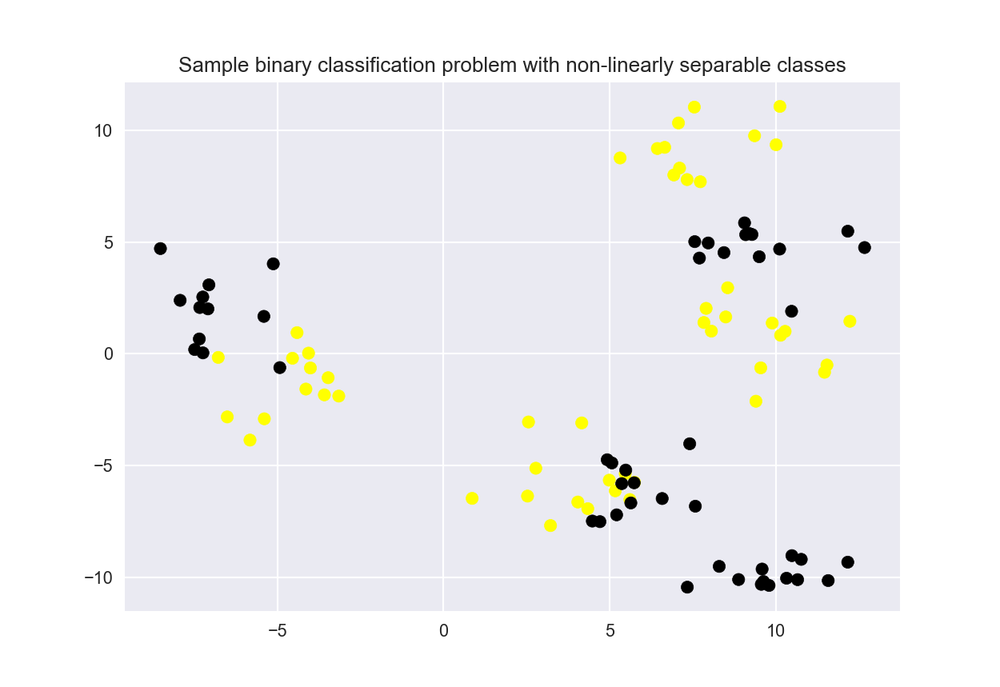

In [38]:
# more difficult synthetic dataset for classification (binary) 
# with classes that are not linearly separable
X_D2, y_D2 = make_blobs(n_samples = 100, n_features = 2, centers = 8,
                       cluster_std = 1.3, random_state = 4)
y_D2 = y_D2 % 2

plt.figure()
plt.title('Sample binary classification problem with non-linearly separable classes')
plt.scatter(X_D2[:,0], X_D2[:,1], c=y_D2,
           marker= 'o', s=50, cmap=cmap_bold)
plt.show()

To illustrate multi-class classification, we'll use our familiar fruits dataset, which, as you may remember has four features and four possible target labels. Here on the left, I'm showing the array of scatter plots that we saw in week 1 that shows the relationship between all possible pairs of features and the class labels, with the distribution of values for each feature along the diagonal.

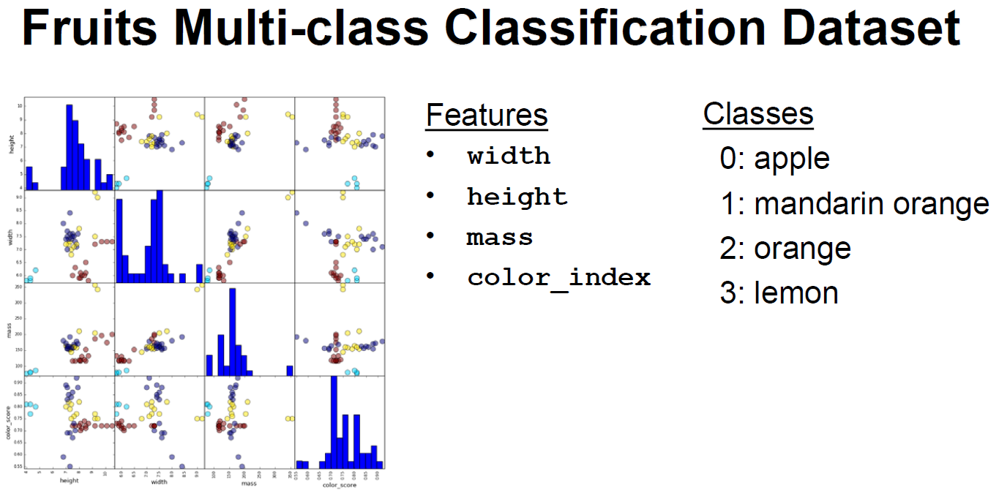

To illustrate a real-world regression problem, we'll use a dataset derived from the communities and crime dataset in the UCI repository. Our dataset uses a subset of the original features and target values which were originally created from combining several U.S. government data sources, like the U.S. census. Each data instance corresponds to a particular geographic area, typically a town or a region of a city.

Our version of this dataset has 88 features that encode various demographic and social economic properties of each location with 1994 location data instances. The target value that we'll try to predict is the per capita violent crime rate.

To use this data set, we use the load_crime_dataset function that's included with the share utilities module for this course

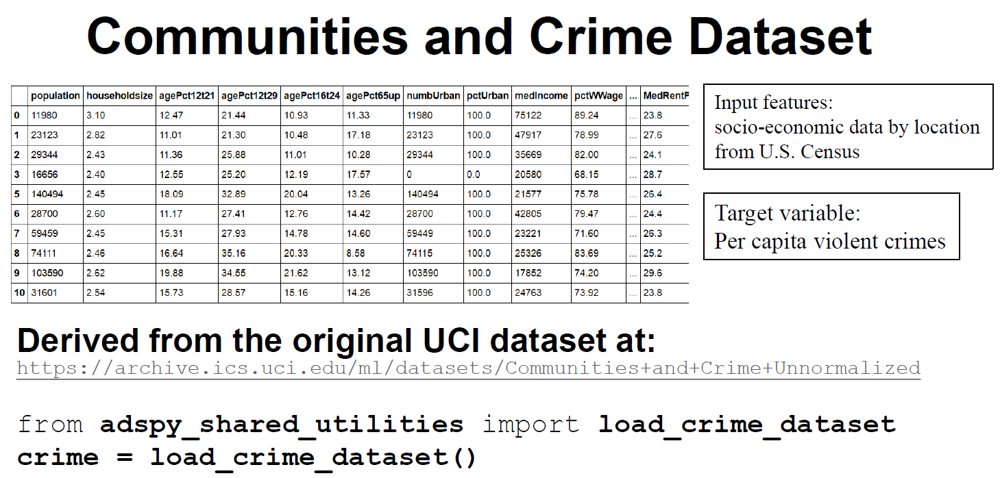

In [39]:
# Breast cancer dataset for classification
cancer = load_breast_cancer()
(X_cancer, y_cancer) = load_breast_cancer(return_X_y = True)


# Communities and Crime dataset
(X_crime, y_crime) = load_crime_dataset()

## K-Nearest Neighbors

Let's revisit the first example of machine learning that we encountered in week one, k-Nearest Neighbor models. Those were a good starting point to continue our exploration of supervised learning because they're simple to understand and can be used for both classification and regression.

Let's recall that, for classification, the k-Nearest Neighbor Classifier simply memorizes the entire training set. And then to classify a new instance does 3 steps.

First, it finds the k-Nearest most similar instances in the training set.
Then it gets the labels of those training instances. And then it predicts the label of the new instance as a function of the nearby training labels typically by a simple majority vote.

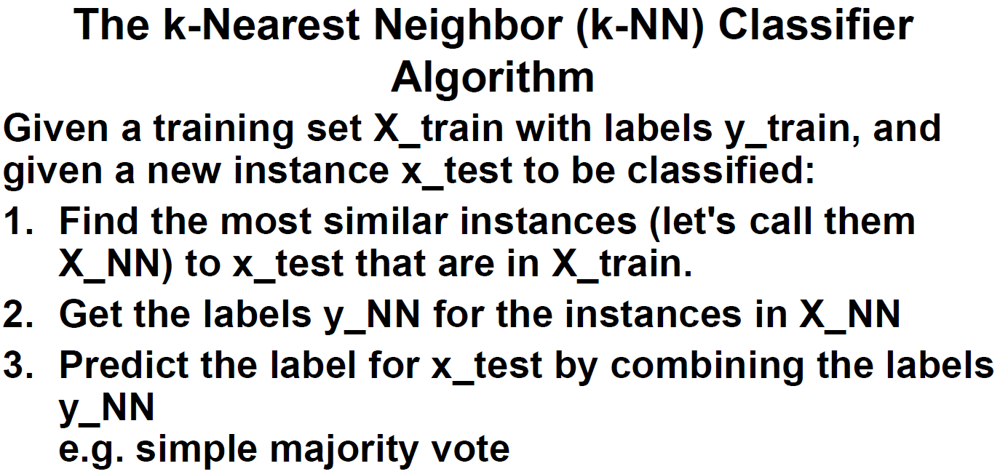

### Classification

Here's how a k-Nearest Neighbor Classifier using only one nearest neighbor, that is with k = 1, makes these predictions for the simple binary synthetic dataset. So as you might recall from week 1 where we applied a nearest neighbors classifier to our multi-class fruit dataset. Here we're applying the nearest neighbors classifier to our simple binary classification problem. Where the points in class 0 are labeled with yellow dots and the points in class 1 are labeled with black dots. And just as we did for the week 1 problem with fruit classification, here we're also showing how the entire feature space is broken up into different decision regions according to the predictions that the k-Nearest Neighbor Classifier would make at each point in the decision space. So for example, a point out here in the yellow region represents a point that the classifier would classify as class 0. And a point, let's say, over here, the classifier would classify as class 1. 

So because this is a k=1 nearest neighbors classifier, to make a classification prediction for any given query point, the Classifier simply looks back into its training set. So these points here represent all the points on the training set. So for any given point, let's say here, the Classifier would simply find the training point that's closest, namely this one, and assign the predicted class to simply the class of the nearest point in the training set. Likewise, if we have a point over here, the nearest point in the training says actually this point right here that has a class 0 label and so that point would get assigned a class 0. And in fact, this whole region right here represents all the points that are closer to the class 0 training point than any of the other class 1 training points. So this whole region here represents a 1 nearest neighbors prediction of class 0. 

So the k-Nearest Neighbor's Classifier with k = 1, you can see that the decision boundaries that derived from that prediction are quite jagged and have high variance. This is an example of a model, classification model, it has high model complexity. And in fact, you can see that the one nearest neighbors classifier is over-fitting the training data in this case. It's trying to get correct predictions for every single training point while ignoring the general this trend between the two classes, namely that most of the yellow points are in this side of the feature space and most of the black points are on this side. So the one nearest neighbor's classifier can be said to be over-fitting in this case.

And here is what happens when we increase k from 1 to 11. Now the classifier must combine the votes of the 11 nearest points, not just 1. So single training data points no longer have as dramatic an influence on the prediction. The result is a much smoother decision boundary, which represents a model with lower model complexity where the decision boundary has much less variance. Actually if we increased k even higher to be the total number of points in the training set, the result would be a single decision region where all predictions would be the most frequent class in the training data. As we saw for the fruit data set, k-Nearest Neighbor Classifiers can be applied to any number of classes, not just 2.

The code for this example in the notebook uses a special function, in the shared utilities library for this course, called plot_two_class_knn. If you run this code and compare the resulting training and test scores for k = 1, 3, 11, which are shown in the title of each plot, you can see the effect of model complexity on a models ability to generalize.

In the k = 1 case, the training score is a perfect 1.0. But the test score is only 0.80. As k increases to 3, the training score drops to 0.88 but the test score increaes slightly to .88, indicating the model is generalizing better to new data. When k = 11, the training score drops a bit further to 0.81, but the test score even better at 0.92, indicating that this simple model is much more effective at ignoring minor variations in training data. And instead capturing the more important global trend in where the classes tend to be located with the best overall generalization performance as a result.

<IPython.core.display.Javascript object>


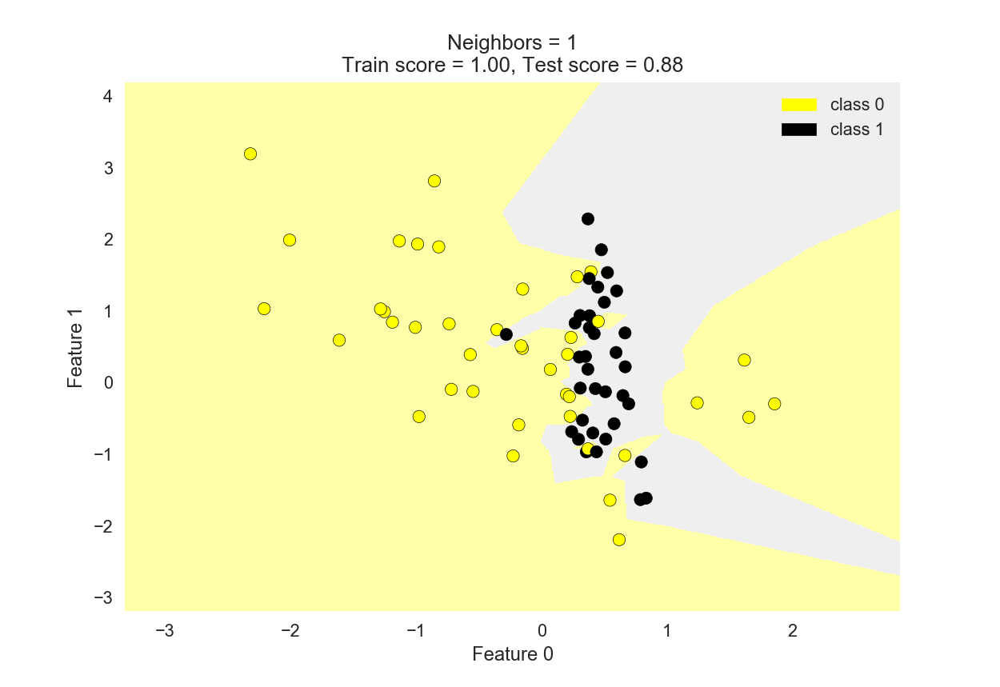

<IPython.core.display.Javascript object>


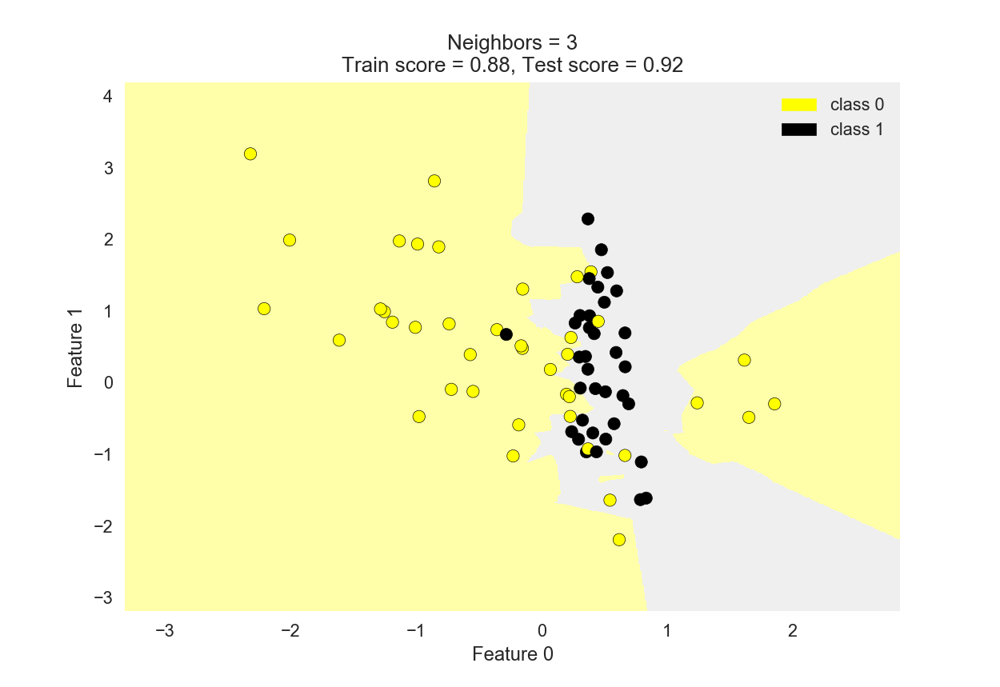

<IPython.core.display.Javascript object>


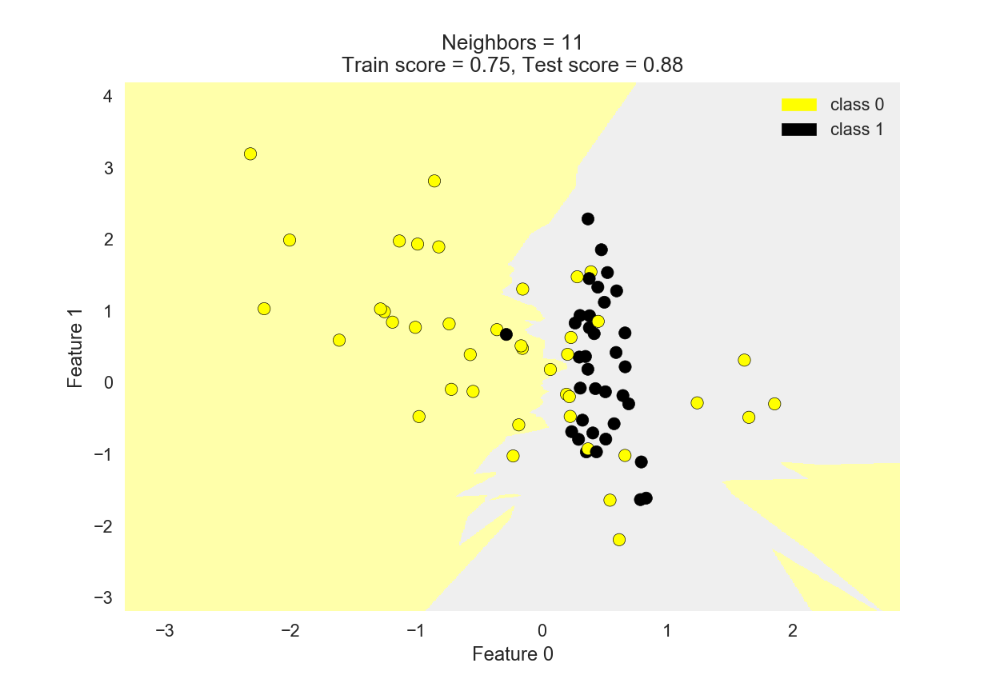

In [40]:
from adspy_shared_utilities import plot_two_class_knn

X_train, X_test, y_train, y_test = train_test_split(X_C2, y_C2,
                                                   random_state=1)

plot_two_class_knn(X_train, y_train, 1, 'uniform', X_test, y_test)
plot_two_class_knn(X_train, y_train, 3, 'uniform', X_test, y_test)
plot_two_class_knn(X_train, y_train, 11, 'uniform', X_test, y_test)

### Regression

The nearest neighbors approach isn't useful just for classification. You can use it for regression too. So here are three plots that show the same simple regression problem with one input feature and the corresponding target values in the training data. The left most plot here, this one, shows just the original training data points. And the middle and right plots show the predictions made by k and n regression algorithm, when k = 1 and k = 3. 

So in these plots, you can see the training points are actually in green. These green circles are the training points and the blue triangles are the output of the k-nearest neighbor regression for any given input value of x. So for example the knn regression prediction for this point here is this y value here.

So how did the nearest neighbors regressor compute this value. Well I did it in similar way to what we saw for classification. So if the query point we're interested in is predicting value associated with this x value, we simply find the training point that has the X value that's closest to this query point. So in this case, that would be this training point. And because this is a 1 nearest neighbor problem, we simply take the target value associated with this training point and use that as the output target for the query point. Similarly, if this were the query point here then the nearest neighbor in the training set would be this point here. And so the output prediction for this particular X-value would be the target value of the nearest neighbor or this value that's just above 100. 

And so, if we do that for all these different X values, we'll get these different predictions using the one nearest neighbor approach. Similarly, if we look at the k = 3 case, where we now look at three nearest neighbors, let's take this example here of -1.25, let's say. Well, what are the three training points that have x values closest to -1.25? They would be this training point, that training point and this training point. Now with regression, what we do is instead of taking a majority vote, we don't have class values here as targets, we have continuous values. So we can average these three target values. And if we do that, we find that the output, when the query point is this X-value, is going to be the average of the y-values of the three nearest training points, or this value here. Similarly, if we have a query point that is here. Then the three nearest neighbor points are here, here and here. And the average target value of these three training points is something like this.

Here's the corresponding code in the notebook that produced these regression plots. These use the k- Neighbors Regressor Class, which like the classification case, takes the n_neighbor setting as a key parameter.

In [41]:
from sklearn.neighbors import KNeighborsRegressor

X_train, X_test, y_train, y_test = train_test_split(X_R1, y_R1, random_state = 0)

knnreg = KNeighborsRegressor(n_neighbors = 5).fit(X_train, y_train)

print(knnreg.predict(X_test))
print('R-squared test score: {:.3f}'
     .format(knnreg.score(X_test, y_test)))

[231.71 148.36 150.59 150.59  72.15 166.51 141.91 235.57 208.26 102.1
 191.32 134.5  228.32 148.36 159.17 113.47 144.04 199.23 143.19 166.51
 231.71 208.26 128.02 123.14 141.91]
R-squared test score: 0.425


<IPython.core.display.Javascript object>


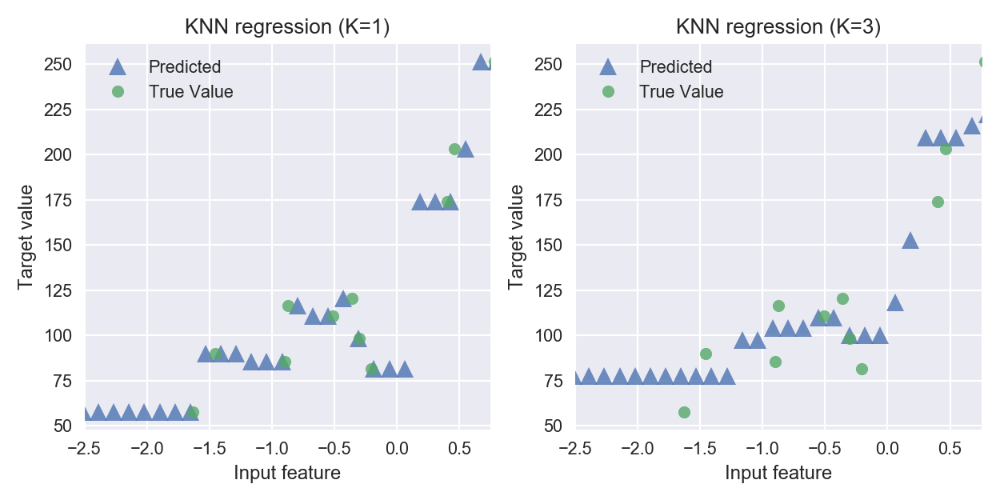

In [42]:
fig, subaxes = plt.subplots(1, 2, figsize=(8,4))
X_predict_input = np.linspace(-3, 3, 50).reshape(-1,1)
X_train, X_test, y_train, y_test = train_test_split(X_R1[0::5], y_R1[0::5], random_state = 0)

for thisaxis, K in zip(subaxes, [1, 3]):
    knnreg = KNeighborsRegressor(n_neighbors = K).fit(X_train, y_train)
    y_predict_output = knnreg.predict(X_predict_input)
    thisaxis.set_xlim([-2.5, 0.75])
    thisaxis.plot(X_predict_input, y_predict_output, '^', markersize = 10,
                 label='Predicted', alpha=0.8)
    thisaxis.plot(X_train, y_train, 'o', label='True Value', alpha=0.8)
    thisaxis.set_xlabel('Input feature')
    thisaxis.set_ylabel('Target value')
    thisaxis.set_title('KNN regression (K={})'.format(K))
    thisaxis.legend()
plt.tight_layout()

Because the target values in a regression problem are continuous as compared to the discrete values that we see for classifier target labels. To assess how well a regression model fits the data, we use a regression score called r-squared that's between 0 and 1. We'll cover some additional types of regression evaluation scores later in the course. For the r-squared value, a value of 1 corresponds to the best possible performance, a model that makes perfect predictions.
A value of 0 corresponds to a model that makes a constant value prediction that's always just a mean value of all the training target values.

The r-squared value is sometimes known as the coefficient of determination.

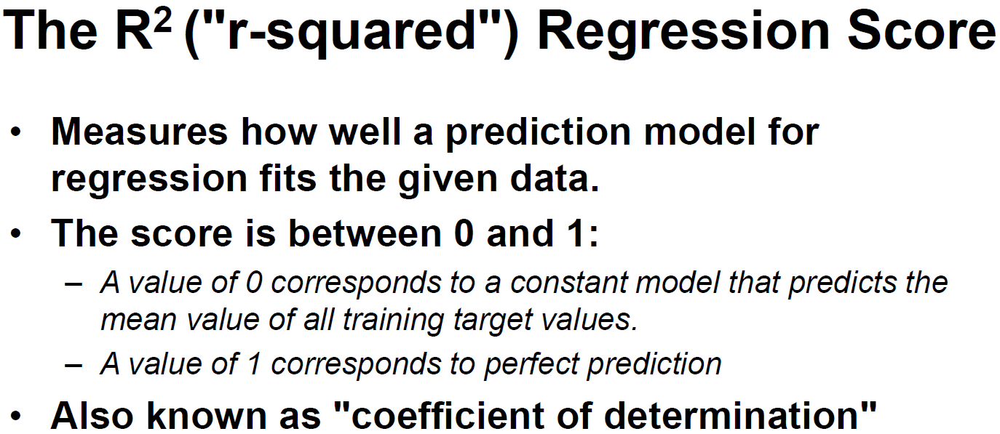

### Regression model complexity as a function of K

Just as we did for classification, let's look at the connection between model complexity and generalization ability as measured by the r-squared training and test values on the simple regression dataset. The series of plots on the notebook shows how the KNN regression algorithm fits the data for k = 1, 3, 7, 15, and in an extreme case of k = 55. It represents almost half the training points. We can see the same pattern in model complexity for k and N regression that we saw for k and N classification. Namely, that small values of k give models with higher complexity. And large values of k result in simpler models with lower complexity.

Starting on the left when k = 1, the regression model fits the training data perfectly with a r-squared score of 1.0. But it's very bad at predicting the target values for new data samples, as reflected in the r-squared test score of only 0.155.

As the value of k increases, which we can see acts to smooth out these local variations to capture more of the global trend. Again the training set score drops, but the model gets better at generalizing to new data and the test score goes up as K increases.

Finally in this series, the model with k = 15 has the best test set performance, with an r-squared score of 0.485. Increasing k much further however to k = 55, results in both the training and test set scores dropping back down to lower levels, as the model now starts to under-fit. In other words, it's too simple to do well, even on the training data.

The pro's of the nearest neighbor approach are that it's simple and easy to understand why a particular prediction is made. A k-nearest neighbor approach can be a reasonable baseline against what you can compare more sophisticated methods.

When the training data has many instances, or each instance has lots of features, this can really slow down the performance of a k-nearest neighbors model. So in general, if your data set has hundreds or thousands of features, you should consider alternatives to k-nearest neighbors models, especially if your data is sparse. Meaning that each instance has lots of features, but most of them are zero.

<IPython.core.display.Javascript object>


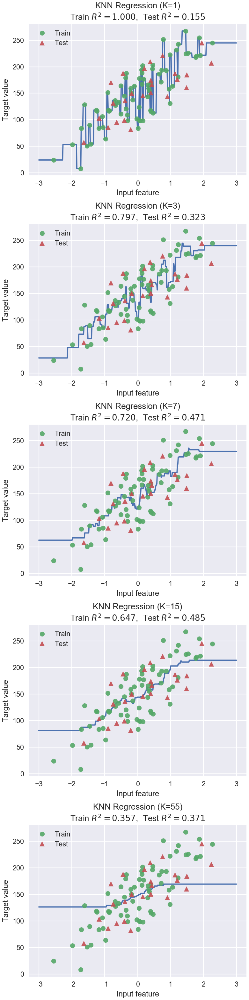

In [43]:
# plot k-NN regression on sample dataset for different values of K
fig, subaxes = plt.subplots(5, 1, figsize=(5,20))
X_predict_input = np.linspace(-3, 3, 500).reshape(-1,1)
X_train, X_test, y_train, y_test = train_test_split(X_R1, y_R1,
                                                   random_state = 0)

for thisaxis, K in zip(subaxes, [1, 3, 7, 15, 55]):
    knnreg = KNeighborsRegressor(n_neighbors = K).fit(X_train, y_train)
    y_predict_output = knnreg.predict(X_predict_input)
    train_score = knnreg.score(X_train, y_train)
    test_score = knnreg.score(X_test, y_test)
    thisaxis.plot(X_predict_input, y_predict_output)
    thisaxis.plot(X_train, y_train, 'o', alpha=0.9, label='Train')
    thisaxis.plot(X_test, y_test, '^', alpha=0.9, label='Test')
    thisaxis.set_xlabel('Input feature')
    thisaxis.set_ylabel('Target value')
    thisaxis.set_title('KNN Regression (K={})\n\
Train $R^2 = {:.3f}$,  Test $R^2 = {:.3f}$'
                      .format(K, train_score, test_score))
    thisaxis.legend()
    plt.tight_layout(pad=0.4, w_pad=0.5, h_pad=1.0)


So to sum up, and as a review of what we saw in week one. The two key parameters for both regression and classification in nearest neighbors models are naturally n-neighbors which controls the value of the number of neighbors to consider and thus the model complexity, as we saw.

And the metric parameter which controls the distance function between points and thus which points are considered as nearest in finding neighbors. We didn't explore the metric parameter here and that's beyond the scope of this course. But in most cases, the default Euclidean setting words pretty well with most datasets.

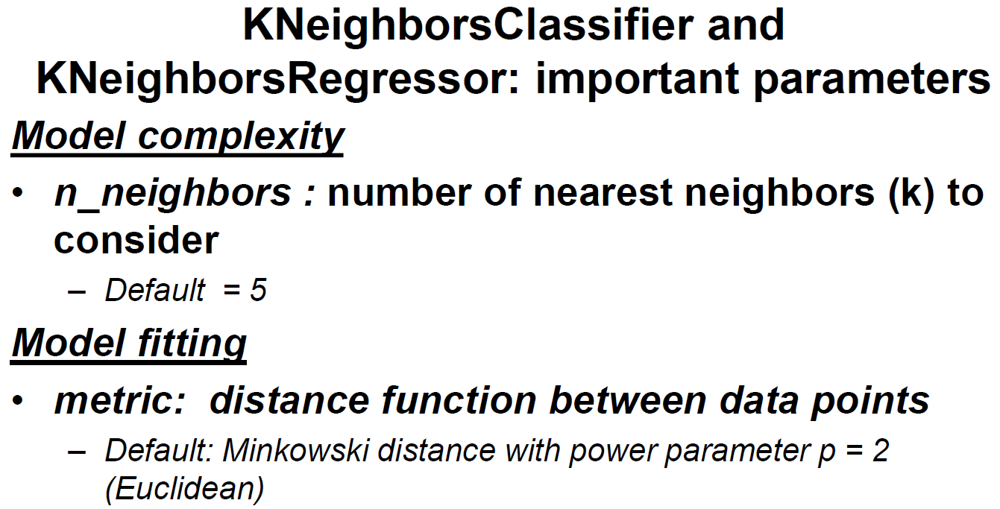

## Linear models for regression

One of the simplest kinds of supervised models are linear models. A linear model expresses the target output value in terms of a sum of weighted input variables. For example, our goal may be to predict the market value of a house, its expected sales price in the next month, for example.

Suppose we're given two input variables, how much tax the properties assessed each year by the local government, and the age of the house in years. You can imagine that these two features of the house would each have some information that's helpful in predicting the market price. Because in most places, there's a positive correlation between the tax assessment on a house and its market value. Indeed the tax assessment is often partly based on market prices from previous years. And may be a negative correlation between its age in years and the market value, so older houses may need more repairs and upgrading, for example.

One linear model, which I have made up as an example, could compute the expected market price in US dollars by starting with a constant term, here 212,000. And then adding some number, let's say 109 times the value of tax paid last year, and then subtracting 2,000 times the age of the house in years. So for example this linear model would estimate the market price of a house where the taxes estimate was 10,000 dollars and that was 75 years old as about $1.2 million. 

Now, I just made up this particular linear model myself as an example but in general when we talk about training a linear model. We mean estimating values for the parameters of the model, or coefficients of the model as we sometimes call them, which are here the constant value 212,000 and the weights 109 and 20. In such a way that the resulting predictions for the outcome variable Yprice, for different houses are a good fit to the data from actual past sales. We'll discuss what good fit means shortly.

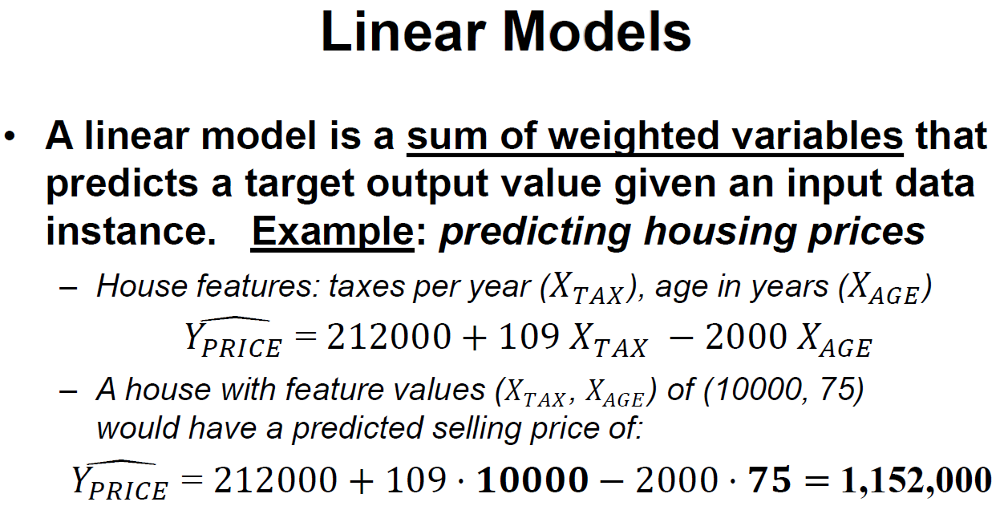

Predicting house price is an example of a regression task using a linear model called, not surprisingly, linear regression.

More generally, in a linear regression model, there may be multiple input variables, or features, which we'll denote x0, x1, etc. Each feature, xi, has a corresponding weight, wi. The predicted output, which we denote y hat, is a weighted sum of features plus a constant term b hat.

I've put a hat over all the quantities here that are estimated during the regression training process. The w hat and b hat values which we call the train parameters or coefficients are estimated from training data. And y hat is estimated from the linear function of input feature values and the train parameters. For example, in the simple housing price example we just saw, w0 hat was 109, x0 represented tax paid, w1 hat was negative 20 x1 was house age and b hat was 212,000. We called these wi values model coefficients or sometimes feature weights, and b hat is called the bias term or the intercept of the model.

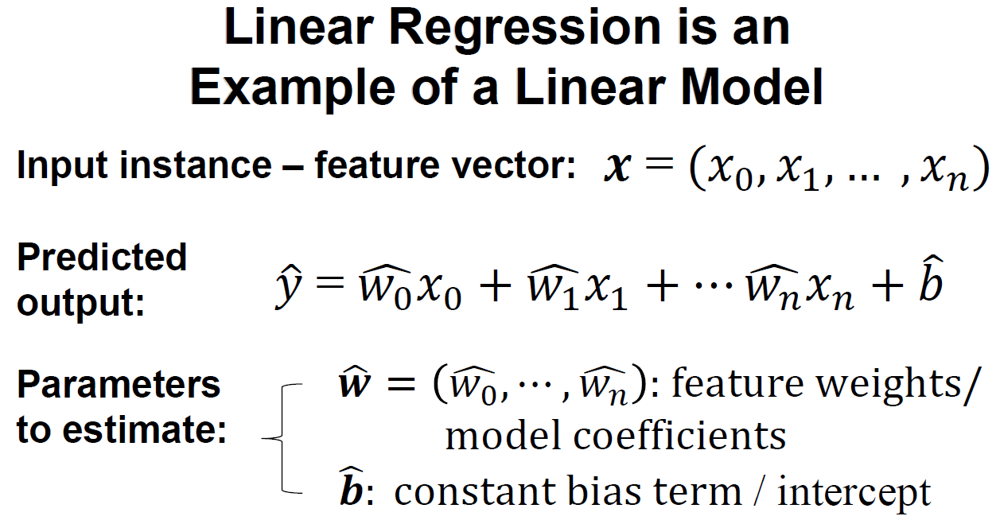

Here's an example of a linear regression model with just one input variable or feature x0 on a simple artificial example dataset.

The blue cloud of points represents a training set of x0, y pairs. In this case, the formula for predicting the output y hat is just w0 hat times x0 + b hat, which you might recognize as the familiar slope intercept formula for a straight line, where w0 hat is the slope, and b hat is the y intercept.

The grey and red lines represent different possible linear regression models that could attempt to explain the relationship between x0 and y. You can see that some lines are a better fit than others. The better fitting models capture the approximately linear relationship where as x0 increases, y also increases in a linear fashion. The red line seemed specially good. Intuitively, there are not as many blue training points that are very far above or very far below the red linear model prediction.

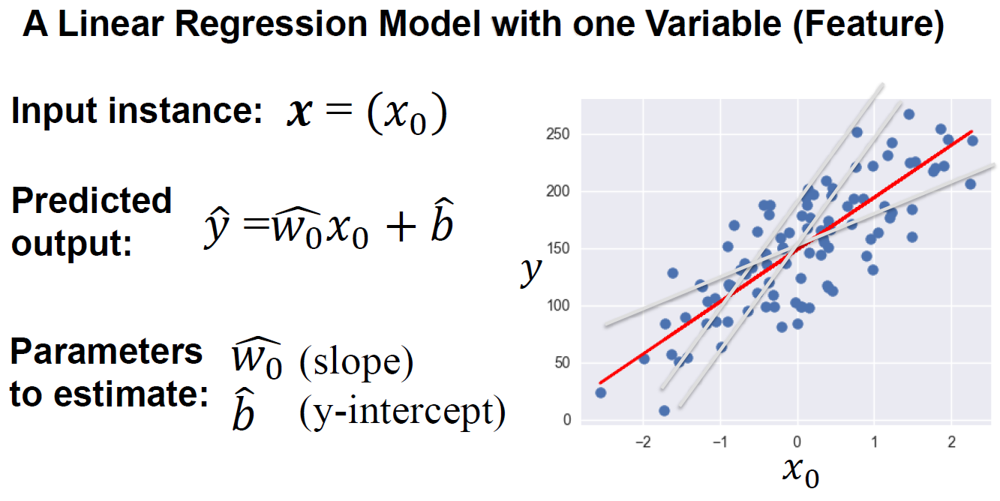

Let's take a look at a very simple form of linear regression model that just has one input variable, or feature to use for prediction. In this case, we have the vector x just has a single component, we'll call it x0, that's the input variable, input feature. And, in this case because there's just one variable, the predicted output is simply the product of the weight w0 with the input variable x0 plus a biased term b.

So x0 is the value that's provided, it comes with the data and so the parameters we have to estimate are w0 and b, in order to obtain the parameters for this linear regression model. So this formula may look familiar, it's the formula for a line in terms of its slope. In this case, slope corresponds to the weight, w0, and b corresponds to the y intercept, we call the bias term.

So here, the job of the model is to take as input. Let's pick a point here, on the x-axis so w0 corresponds to the slope of this line and b corresponds to the y intercept of the line. And so finding these two parameters, these two parameters together define a straight line in this feature space. Now the important thing to remember is that there's a training phase and a prediction phase. So the training phase, using the training data, is what we'll use to estimate w0 and b.

So a widely used method for estimating w and b for linear aggression problems is called least-squares linear regression, also known as ordinary least-squares. Least-squares linear regression finds the line through this cloud of points that minimizes what is called the means squared error of the model. The mean squared error of the model is essentially the sum of the squared differences between the predicted target value and the actual target value for all the points in the training set. This plot illustrates what that means.

The blue points represent points in the training set, the red line here represents the least-squares models that was found through these cloud of training points. And these black lines show the difference between the y value that was predicted for training point based on it's x position, and the actual y value of the training point.

So for example here, this point let's say has an x value of- 1.75. And if we plug it into the formula for this linear model, we get a prediction here, at this point on the line, which is somewhere around let's say 60. But the actual observed value in the training set for this point was maybe closer to 10. So, in this case, for this particular point, the squared difference between the predicted target and the actual target would be (60- 10) squared. So, we can do this calculation for every one of the points in the training set.

We can compute this squared difference between the y value we observe in the training set for a point, and the y value that would be predicted by the linear model, given that training points x value. So each of these can be computed as the square difference can be computed, and then if we add all these up, And divide by the number of training points, take the average, that will be the mean squared error of the model. So the technique of least-squares, is designed to find the slope, the w value, and the b value of the y intercept, that minimize this squared error, this mean squared error.

One thing to note about this linear regression model is that there are no parameters to control the model complexity. No matter what the value of w and b, the result is always going to be a straight line. This is both a strength and a weakness of the model as we'll see later.

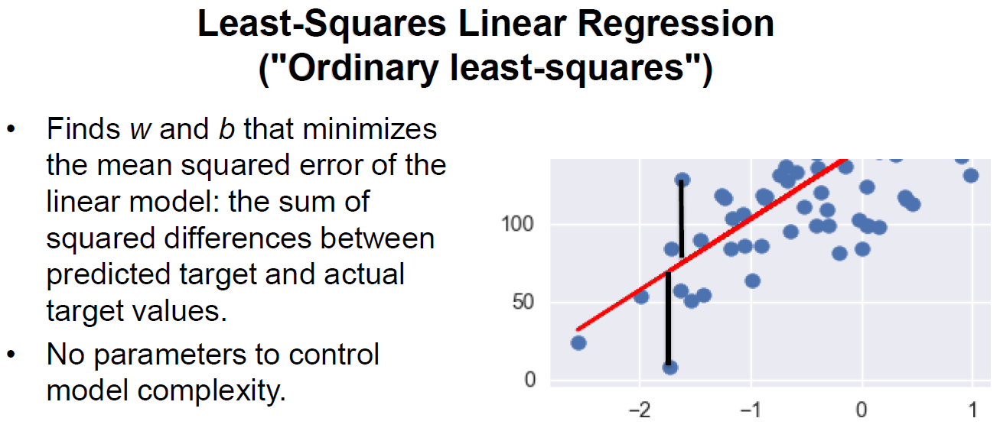

When you have a moment, compare this simple linear model to the more complex regression model learned with K nearest neighbors regression on the same dataset. You can see that linear models make a strong prior assumption about the relationship between the input x and output y. Linear models may seem simplistic, but for data with many features linear models can be very effective and generalize well to new data beyond the training set.

Now the question is, how exactly do we estimate the near models w and b parameters so the model is a good fit? Well, the w and b parameters are estimated using the training data. And there are lots of different methods for estimating w and b depending on the criteria you'd like to use for the definition of what a good fit to the training data is and how you want to control model complexity.

For linear models, model complexity is based on the nature of the weights w on the input features. Simpler linear models have a weight vector w that's closer to zero, i.e., where more features are either not used at all that have zero weight or have less influence on the outcome, a very small weight.

Typically, given possible settings for the model parameters, the learning algorithm predicts the target value for each training example, and then computes what is called a loss function for each training example. That's a penalty value for incorrect predictions. The prediction's incorrect when the predicted target value is different than the actual target value in the training set.

For example, a squared loss function would return the squared difference between the target value and the actual value as the penalty. The learning algorithm then computes or searches for the set of w, b parameters that minimize the total of this loss function over all training points.

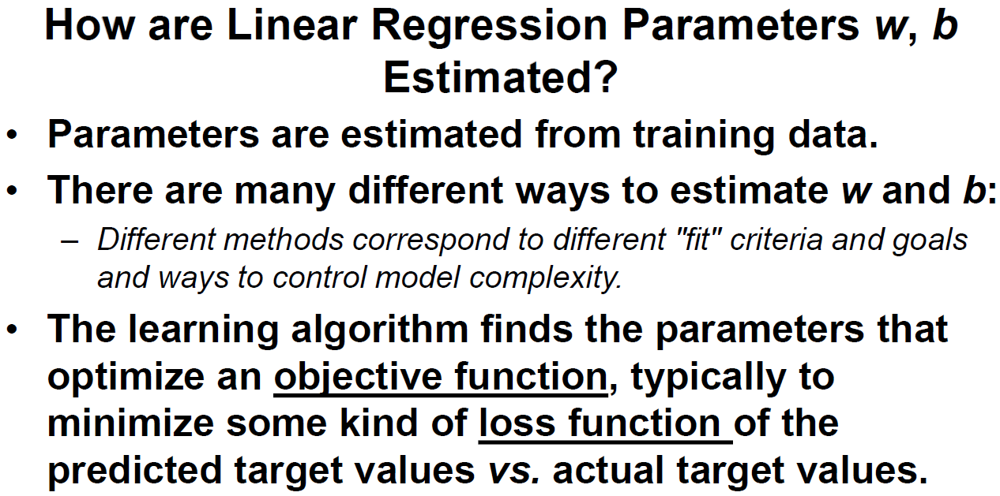

The most popular way to estimate w and b parameters is using what's called least-squares linear regression or ordinary least-squares. Least-squares finds the values of w and b that minimize the total sum of squared differences between the predicted y value and the actual y value in the training set. Or equivalently it minimizes the mean squared error of the model. Least-squares is based on the squared loss function mentioned before.

This is illustrated graphically here, where I've zoomed in on the left lower portion of this simple regression dataset. The red line represents the least-squares solution for w and b through the training data. And the vertical lines represent the difference between the actual y value of a training point, xi, y and it's predicted y value given xi which lies on the red line where x equals xi. Adding up all the squared values of these differences for all the training points gives the total squared error and this is what the least-square solution minimizes.

Here, there are no parameters to control model complexity. The linear model always uses all of the input variables and always is represented by a straight line. Another name for this quantity is the residual sum of squares. The actual target value is given in yi and the predicted y hat value for the same training example is given by the right side of the formula using the linear model with that parameters w and b.

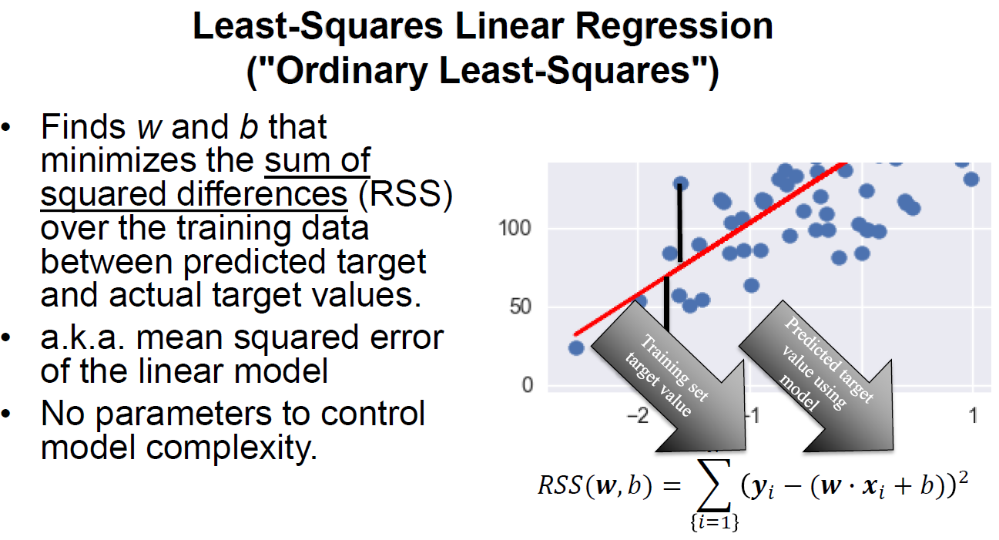

As we did with other estimators in Scikit-Learn, like the nearest neighbors classifier, and the regression models, we use the train test split function on the original data set. And then create and fit the linear regression object using the training data in X_train and the corresponding training data target values in Y_train. Here, note that we're doing the creation and fitting of the linear regression object in one line by chaining the fit method with the constructor for the new object. The linear regression fit method acts to estimate the feature weights w, which are called the coefficients of the model and it stores this in the coeff_attribute. And the bias term, b, which is stored in the intercept_ attribute.

Note that if a Scikit-Learn object attribute ends with an underscore, this means that these attributes were derived from training data, and not, say, quantities that were set by the user.


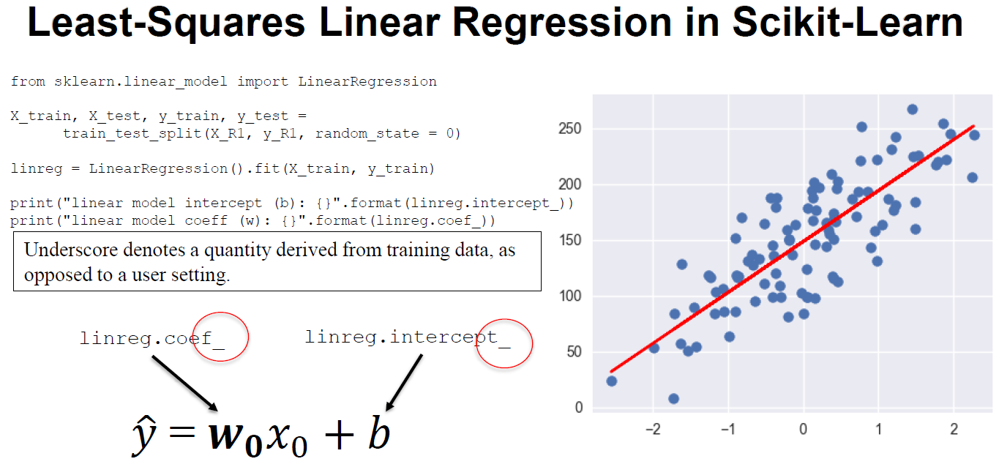

If we dump the coef_ and intercept_ attributes for this simple example, we see that because there's only one input feature variable, there's only one element in the coeff_list, the value 45.7. The intercept attribute has a value of about 148.4. And we can see that indeed these correspond to the red line shown in the plot which has a slope of 45.7 and y intercept of about 148.4. Here is the same code in the notebook. With additional code to score the quality of the regression model, in the same way that we did for K nearest neighbors regression using the R-squared metric.

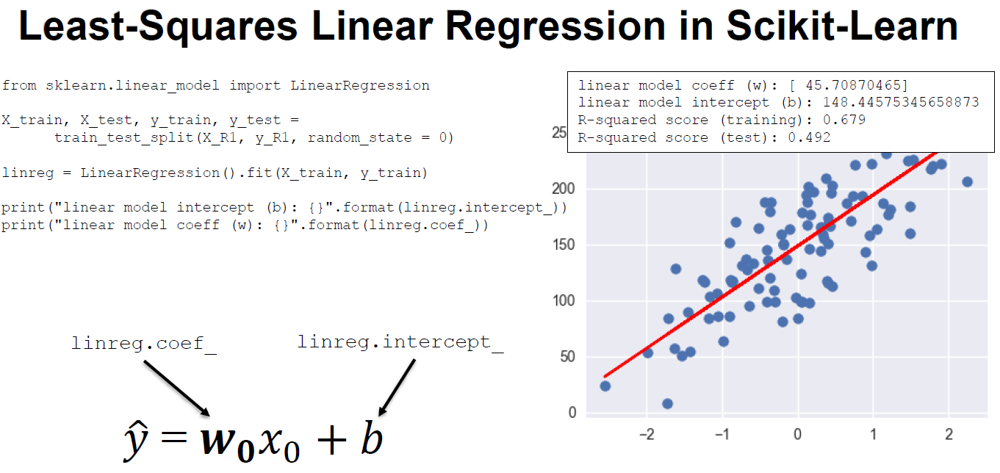

### Linear regression

In [44]:
from sklearn.linear_model import LinearRegression

X_train, X_test, y_train, y_test = train_test_split(X_R1, y_R1,
                                                   random_state = 0)
linreg = LinearRegression().fit(X_train, y_train)

print('linear model coeff (w): {}'
     .format(linreg.coef_))
print('linear model intercept (b): {:.3f}'
     .format(linreg.intercept_))
print('R-squared score (training): {:.3f}'
     .format(linreg.score(X_train, y_train)))
print('R-squared score (test): {:.3f}'
     .format(linreg.score(X_test, y_test)))

linear model coeff (w): [45.71]
linear model intercept (b): 148.446
R-squared score (training): 0.679
R-squared score (test): 0.492


### Linear regression: example plot 

<IPython.core.display.Javascript object>


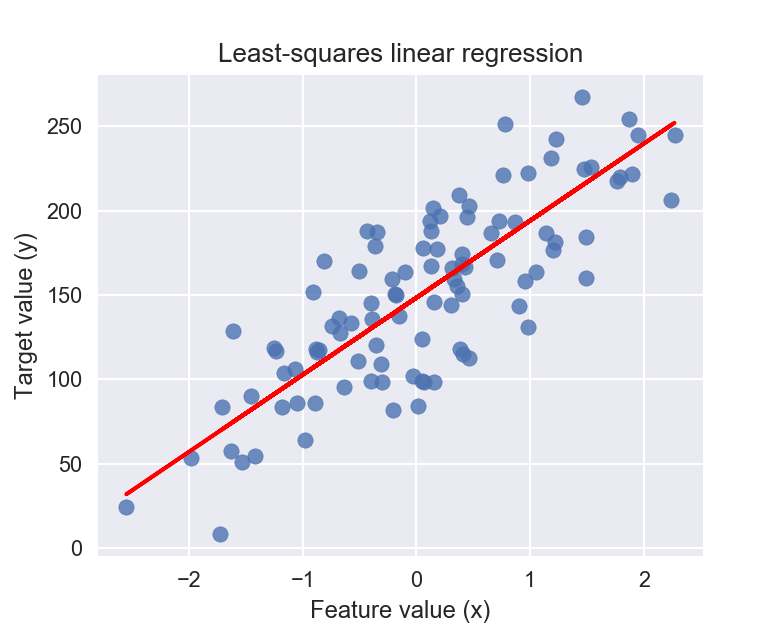

In [45]:
plt.figure(figsize=(5,4))
plt.scatter(X_R1, y_R1, marker= 'o', s=50, alpha=0.8)
plt.plot(X_R1, linreg.coef_ * X_R1 + linreg.intercept_, 'r-')
plt.title('Least-squares linear regression')
plt.xlabel('Feature value (x)')
plt.ylabel('Target value (y)')
plt.show()

Now that we have seen both K nearest neighbors regression and least-squares regression, it's interesting now to compare the least-squared linear regression results with the K nearest neighbors result. Here we can see how these two regression methods represent two complementary types of supervised learning.

The K nearest neighbor regresser doesn't make a lot of assumptions about the structure of the data, and gives potentially accurate but sometimes unstable predictions that are sensitive to small changes in the training data. So it has a correspondingly higher training set, R-squared score, compared to least-squares linear regression. K-NN achieves an R-squared score of 0.72 and least-squares achieves an R-squared of 0.679 on the training set.

On the other hand, linear models make strong assumptions about the structure of the data, in other words, that the target value can be predicted using a weighted sum of the input variables. And linear models give stable but potentially inaccurate predictions. However, in this case, it turns out that the linear model strong assumption that there's a linear relationship between the input and output variables happens to be a good fit for this dataset.

And so it's better at more accurately predicting the y value for new x values that weren't seen during training. And we can see that the linear model gets a slightly better test set score of 0.492 versus 0.471 for K nearest neighbors. And this indicates its ability to better generalize and capture this global linear trend.

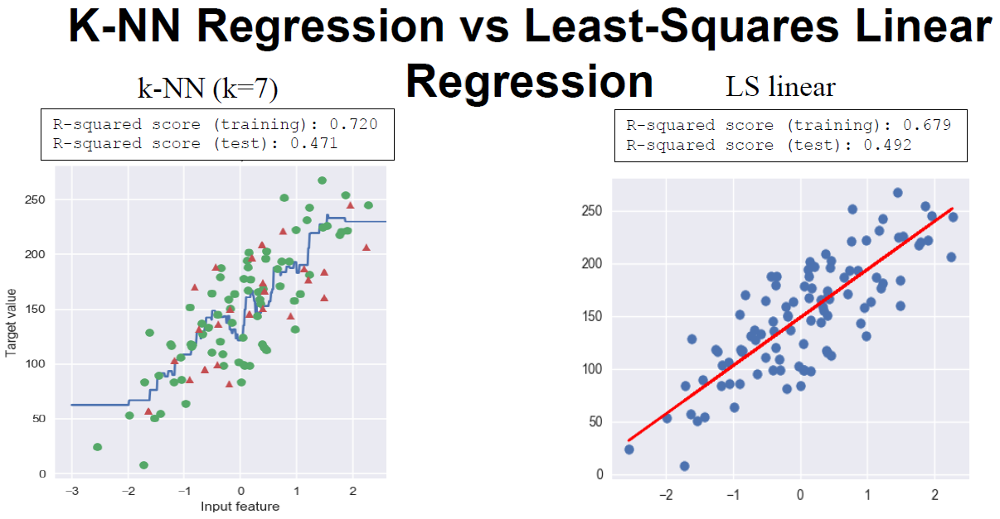

In [46]:
X_train, X_test, y_train, y_test = train_test_split(X_crime, y_crime,
                                                   random_state = 0)
linreg = LinearRegression().fit(X_train, y_train)

print('Crime dataset')
print('linear model intercept: {}'
     .format(linreg.intercept_))
print('linear model coeff:\n{}'
     .format(linreg.coef_))
print('R-squared score (training): {:.3f}'
     .format(linreg.score(X_train, y_train)))
print('R-squared score (test): {:.3f}'
     .format(linreg.score(X_test, y_test)))

Crime dataset
linear model intercept: -1728.1306726032412
linear model coeff:
[ 1.62e-03 -9.43e+01  1.36e+01 -3.13e+01 -8.15e-02 -1.69e+01 -2.43e-03
  1.53e+00 -1.39e-02 -7.72e+00  2.28e+01 -5.66e+00  9.35e+00  2.07e-01
 -7.43e+00  9.66e-03  4.38e-03  4.80e-03 -4.46e+00 -1.61e+01  8.83e+00
 -5.07e-01 -1.42e+00  8.18e+00 -3.87e+00 -3.54e+00  4.49e+00  9.31e+00
  1.74e+02  1.18e+01  1.51e+02 -3.30e+02 -1.35e+02  6.95e-01 -2.38e+01
  2.77e+00  3.82e-01  4.39e+00 -1.06e+01 -4.92e-03  4.14e+01 -1.16e-03
  1.19e+00  1.75e+00 -3.68e+00  1.60e+00 -8.42e+00 -3.80e+01  4.74e+01
 -2.51e+01 -2.88e-01 -3.66e+01  1.90e+01 -4.53e+01  6.83e+02  1.04e+02
 -3.29e+02 -3.14e+01  2.74e+01  5.12e+00  6.92e+01  1.98e-02 -6.12e-01
  2.65e+01  1.01e+01 -1.59e+00  2.24e+00  7.38e+00 -3.14e+01 -9.78e-05
  5.02e-05 -3.48e-04 -2.50e-04 -5.27e-01 -5.17e-01 -4.10e-01  1.16e-01
  1.46e+00 -3.04e-01  2.44e+00 -3.66e+01  1.41e-01  2.89e-01  1.77e+01
  5.97e-01  1.98e+00 -1.36e-01 -1.85e+00]
R-squared score (training): 

### Ridge Regression  (a form of Linear Regression with penalty term)

Ridge regression uses the same least-squares criterion, but with one difference. During the training phase, it adds a penalty term for feature weights, the Wi values that are too large as shown in the equation here. You'll see that large weights means mathematically that the sum of their squared values is large. 

Once ridge regression has estimated the W and B parameters for the linear model, the prediction of Y values for new instances is exactly the same as in least squares. You just plug in your input feature values, the Xi's and compute the sum of the weighted feature values plus B with the usual in your formula.

This addition of a penalty term to a learning algorithm's objective function is called Regularisation. Regularisation is an extremely important concept in machine learning. It's a way to prevent overfitting, and thus, improve the likely generalization performance of a model, by restricting the models possible parameter settings. Usually the effect of this restriction from regularisation, is to reduce the complexity of the final estimated model. 

So how does this work with linear regression? The addition of the sum of squared W parameter values that's shown in the box, to the least-squares objective means that models with larger feature weights (w) add more to the objective functions overall value. Because our goal is to minimize the overall objective function, the regularisation term acts as a penalty of models with lots of large feature weight values. In other words, all things being equal, if ridge regression finds two possible linear models that predict the training data values equally well, it will prefer the linear model that has a smaller overall sum of squared feature weights. 

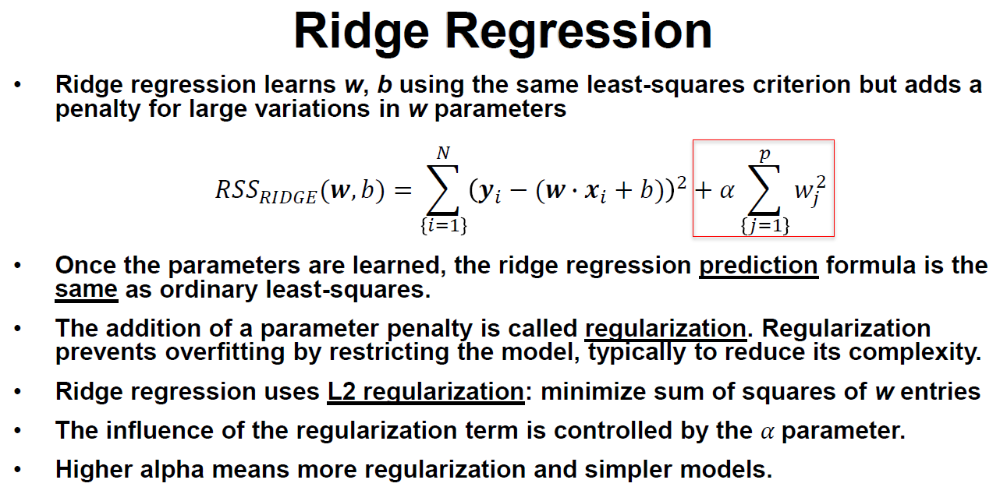

The practical effect of using ridge regression, is to find the feature weights Wi that fit the data well in at least squares sense, and that set lots of the feature weights to values that are very small. We don't see this effect with a single variable linear regression example, but for regression problems with dozens or hundreds of features, the accuracy improvement from using regularized linear regression like ridge regression could be significant. 

The amount of regularisation to apply is controlled by the alpha parameter. Larger alpha means more regularization and simpler linear models with weights closer to zero. The default setting for alpha is 1.0. Notice that setting alpha to zero corresponds to the special case of ordinary least-squares linear regression that we saw earlier, that minimizes the total square here. 

In scikit learn, you use ridge regression by importing the ridge class from sklearn.linear model. And then use that estimate or object just as you would for least-squares. The one difference is that you can specify the amount of the ridge regression regularisation penalty, which is called the L2 penalty, using the alpha parameter.

In [47]:
from sklearn.linear_model import Ridge
X_train, X_test, y_train, y_test = train_test_split(X_crime, y_crime,
                                                   random_state = 0)

linridge = Ridge(alpha=20.0).fit(X_train, y_train)

print('Crime dataset')
print('ridge regression linear model intercept: {}'
     .format(linridge.intercept_))
print('ridge regression linear model coeff:\n{}'
     .format(linridge.coef_))
print('R-squared score (training): {:.3f}'
     .format(linridge.score(X_train, y_train)))
print('R-squared score (test): {:.3f}'
     .format(linridge.score(X_test, y_test)))
print('Number of non-zero features: {}'
     .format(np.sum(linridge.coef_ != 0)))

Crime dataset
ridge regression linear model intercept: -3352.4230358462573
ridge regression linear model coeff:
[ 1.95e-03  2.19e+01  9.56e+00 -3.59e+01  6.36e+00 -1.97e+01 -2.81e-03
  1.66e+00 -6.61e-03 -6.95e+00  1.72e+01 -5.63e+00  8.84e+00  6.79e-01
 -7.34e+00  6.70e-03  9.79e-04  5.01e-03 -4.90e+00 -1.79e+01  9.18e+00
 -1.24e+00  1.22e+00  1.03e+01 -3.78e+00 -3.73e+00  4.75e+00  8.43e+00
  3.09e+01  1.19e+01 -2.05e+00 -3.82e+01  1.85e+01  1.53e+00 -2.20e+01
  2.46e+00  3.29e-01  4.02e+00 -1.13e+01 -4.70e-03  4.27e+01 -1.23e-03
  1.41e+00  9.35e-01 -3.00e+00  1.12e+00 -1.82e+01 -1.55e+01  2.42e+01
 -1.32e+01 -4.20e-01 -3.60e+01  1.30e+01 -2.81e+01  4.39e+01  3.87e+01
 -6.46e+01 -1.64e+01  2.90e+01  4.15e+00  5.34e+01  1.99e-02 -5.47e-01
  1.24e+01  1.04e+01 -1.57e+00  3.16e+00  8.78e+00 -2.95e+01 -2.33e-04
  3.14e-04 -4.14e-04 -1.80e-04 -5.74e-01 -5.18e-01 -4.21e-01  1.53e-01
  1.33e+00  3.85e+00  3.03e+00 -3.78e+01  1.38e-01  3.08e-01  1.57e+01
  3.31e-01  3.36e+00  1.61e-01 -2.68

### Ridge Regression with Feature Normalization

The R-squared score on the test set is pretty comparable to what we got for least-squares regression. However there is something we can do in applying ridge regression that will improve the results dramatically. 

So now is the time for a brief digression about the need for feature preprocessing and normalization. Let's stop and think for a moment intuitively, what ridge regression is doing. It's regularizing the linear regression by imposing that sum of squares penalty on the size of the W coefficients. So the effect of increasing alpha is to shrink the W coefficients toward zero and towards each other. But if the input variables, the features, have very different scales, then when this shrinkage of the coefficients happens, input variables with different scales will have different contributions to this L2 penalty, because the L2 penalty is a sum of squares of all the coefficients. So transforming the input features, so they're all on the same scale, means the ridge penalty is in some sense applied more fairly to all features without unduly weighting some more than others, just because of the difference in scales. 

So more generally, you'll see as we proceed through the course that feature normalization is important to perform for a number of different learning algorithms, beyond just regularized regression. This includes K-nearest neighbors, support vector machines, neural networks and others. The type of feature preprocessing and normalization that's needed can also depend on the data. For now, we're going to apply a widely used form of feature normalization called MinMax Scaling, that will transform all the input variables, so they're all on the same scale between zero and one.

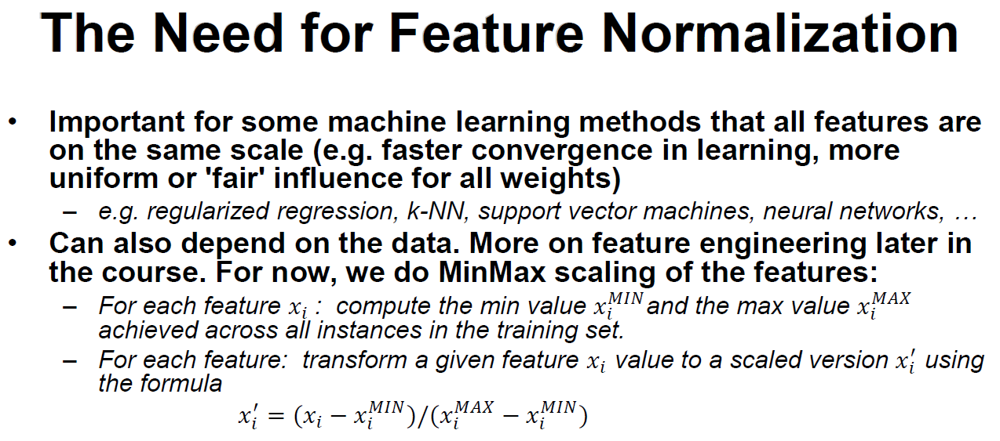

To do this, we compute the minimum and maximum values for each feature on the training data, and then apply the minmax transformation for each feature as shown here. Here's an example of how it works with two features. Suppose we have one feature "height" whose values fall in a fairly narrow range between 1.5 and 2.5 units. But a second feature, "width" has a much wider range between five and 10 units. After applying minmax scaling, values for both features are transformed because they are on the same scale, with the minimum value getting mapped to zero, and the maximum value being transformed to one. And everything else getting transformed to a value between those two extremes. 

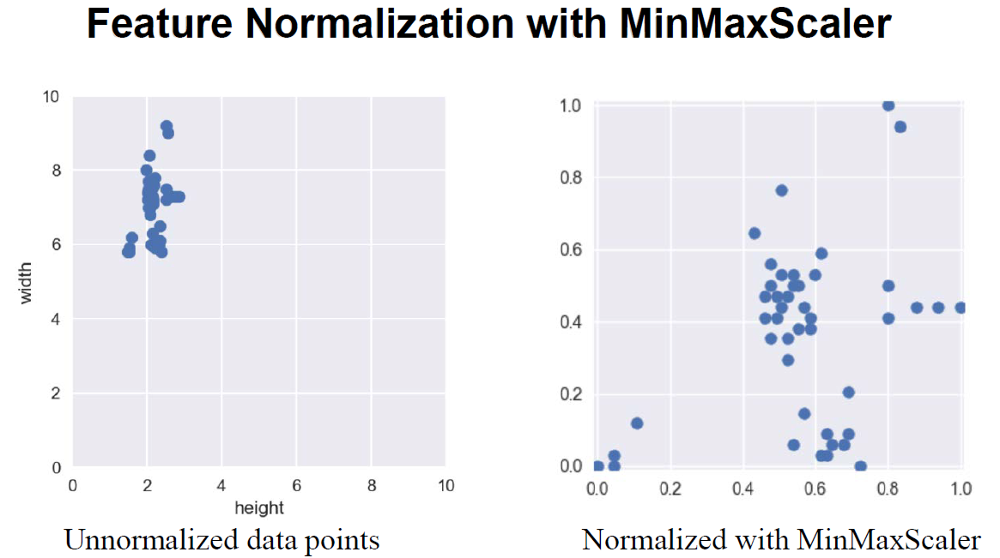

To apply minmax scaling, in scikit-learn, you import the MinMaxScaler object from sklearn.preprocessing. 

To prepare the scalar object for use, you create an instance of it, and then call the fit method using the training data X_train. This will compute the min and max feature values for each feature in this training dataset. 

Then to apply the scalar, you call the transform method, and pass in the data you want to rescale. The output will be the scale version of the input data. In this case, we want to scale the training data and save it in a new variable called X_train_scaled. And the test data, saving that into a new variable called X_test_scaled. 

Then, we just use these scaled versions of the feature data instead of the original feature data. Note that it could be more efficient to perform fitting and transforming in a single step on the training data, by using the scalers.fit_transform method as shown here. 

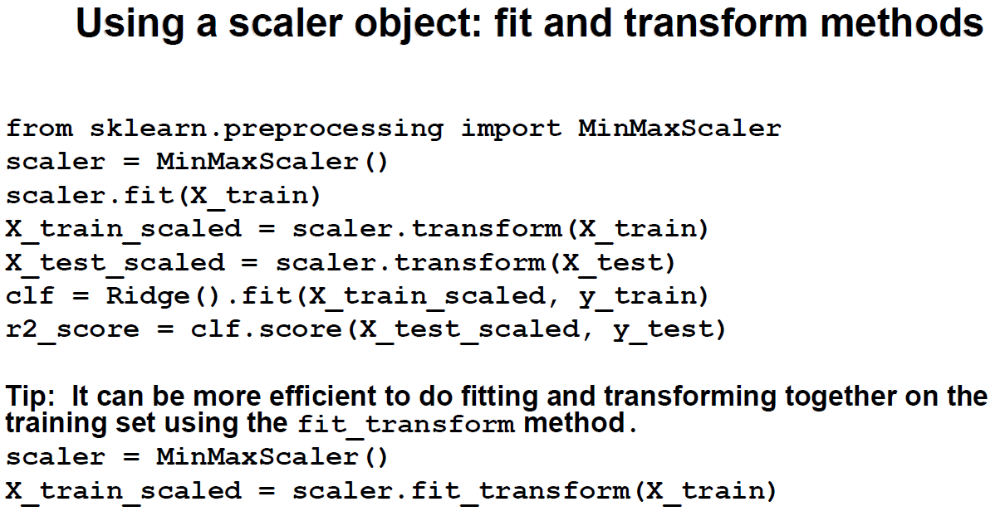

There's one last but very important point here, about how to apply minmax scaling or any kind of feature normalization in a learning scenario with training and test sets. You may have noticed two things here: 

First, we're training the scalar object on the training data and NOT on the test data with scaler.fit(X_train).

Second, we're applying the SAME trained scalar object to transform BOTH the training set and the test set. 

These are both critical aspects to feature normalization. 

If you don't apply the same scalar object to the training and test sets, you'll end up with more or less random data skew, which will invalidate your results. 

If you train the scaler or other normalization method by showing it the test set instead of the training set only, this leads to a phenomenon called Data Leakage, where the training phase has information that is leaked from the test set. For example, like the distribution of extreme values for each feature in the test data, which the learner should never have access to during training. This in turn can cause the learning method to give unrealistically good estimates on the same test set. 

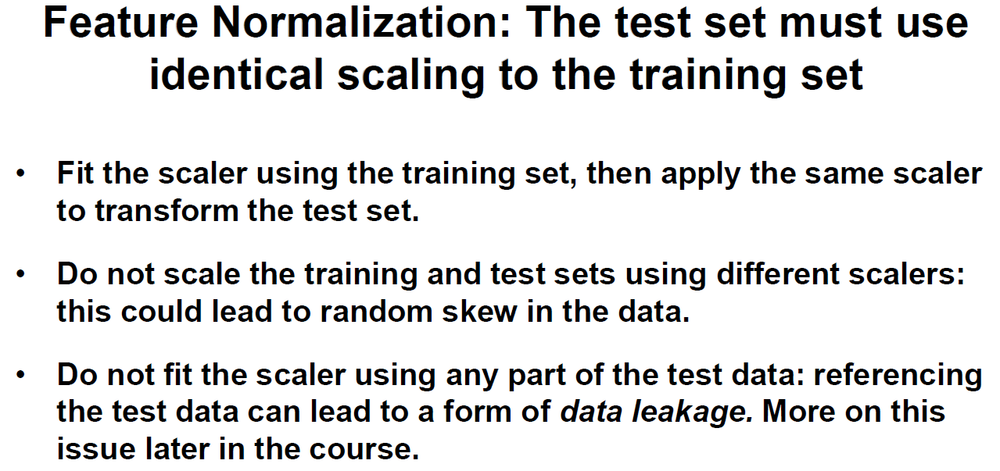

In [48]:
from sklearn.preprocessing import MinMaxScaler
scaler = MinMaxScaler()

from sklearn.linear_model import Ridge
X_train, X_test, y_train, y_test = train_test_split(X_crime, y_crime, random_state = 0)

# The next line is a short cut to both fit AND scale the X_train data
# To do it separately, use:
# scaler.fit(X_train)
# X_train_scaled = scaler.transform(X_train)
X_train_scaled = scaler.fit_transform(X_train)

# NOTE: Do NOT apply scaler.fit to X_test data, this will cause 'data leakage'.
X_test_scaled = scaler.transform(X_test)

linridge = Ridge(alpha=20.0).fit(X_train_scaled, y_train)

print('Crime dataset')
print('ridge regression linear model intercept: {}'
     .format(linridge.intercept_))
print('ridge regression linear model coeff:\n{}'
     .format(linridge.coef_))
print('R-squared score (training): {:.3f}'
     .format(linridge.score(X_train_scaled, y_train)))
print('R-squared score (test): {:.3f}'
     .format(linridge.score(X_test_scaled, y_test)))
print('Number of non-zero features: {}'
     .format(np.sum(linridge.coef_ != 0)))

Crime dataset
ridge regression linear model intercept: 933.3906385044166
ridge regression linear model coeff:
[  88.69   16.49  -50.3   -82.91  -65.9    -2.28   87.74  150.95   18.88
  -31.06  -43.14 -189.44   -4.53  107.98  -76.53    2.86   34.95   90.14
   52.46  -62.11  115.02    2.67    6.94   -5.67 -101.55  -36.91   -8.71
   29.12  171.26   99.37   75.07  123.64   95.24 -330.61 -442.3  -284.5
 -258.37   17.66 -101.71  110.65  523.14   24.82    4.87  -30.47   -3.52
   50.58   10.85   18.28   44.11   58.34   67.09  -57.94  116.14   53.81
   49.02   -7.62   55.14  -52.09  123.39   77.13   45.5   184.91  -91.36
    1.08  234.09   10.39   94.72  167.92  -25.14   -1.18   14.6    36.77
   53.2   -78.86   -5.9    26.05  115.15   68.74   68.29   16.53  -97.91
  205.2    75.97   61.38  -79.83   67.27   95.67  -11.88]
R-squared score (training): 0.615
R-squared score (test): 0.599
Number of non-zero features: 88


#### Ridge Regression with Regularization parameter: alpha

This code combines both Feature Normalized X_train and X_test data with Alpha effects.

In [49]:
print('Ridge regression: effect of alpha regularization parameter\n')
for this_alpha in [0, 1, 10, 20, 50, 100, 1000]:
    linridge = Ridge(alpha = this_alpha).fit(X_train_scaled, y_train)
    r2_train = linridge.score(X_train_scaled, y_train)
    r2_test = linridge.score(X_test_scaled, y_test)
    num_coeff_bigger = np.sum(abs(linridge.coef_) > 1.0)
    print('Alpha = {:.2f}\nnum abs(coeff) > 1.0: {}, \
r-squared training: {:.2f}, r-squared test: {:.2f}\n'
         .format(this_alpha, num_coeff_bigger, r2_train, r2_test))

Ridge regression: effect of alpha regularization parameter

Alpha = 0.00
num abs(coeff) > 1.0: 88, r-squared training: 0.67, r-squared test: 0.51

Alpha = 1.00
num abs(coeff) > 1.0: 87, r-squared training: 0.66, r-squared test: 0.56

Alpha = 10.00
num abs(coeff) > 1.0: 87, r-squared training: 0.63, r-squared test: 0.59

Alpha = 20.00
num abs(coeff) > 1.0: 88, r-squared training: 0.61, r-squared test: 0.60

Alpha = 50.00
num abs(coeff) > 1.0: 86, r-squared training: 0.58, r-squared test: 0.58

Alpha = 100.00
num abs(coeff) > 1.0: 87, r-squared training: 0.55, r-squared test: 0.55

Alpha = 1000.00
num abs(coeff) > 1.0: 84, r-squared training: 0.31, r-squared test: 0.30



### Lasso Regression (similar to Ridge Regression but with different penalty term)

Another kind of regularized regression that you could use instead of ridge regression is called Lasso Regression. Like ridge regression, lasso regression adds a regularisation penalty term to the ordinary least-squares objective, that causes the model W-coefficients to shrink towards zero. Lasso regression uses a slightly different regularisation term called an L1 penalty, instead of ridge regression's L2 penalty as shown here. The L1 penalty looks kind of similar to the L2 penalty, in that it computes a sum over the coefficients but it's sum of the absolute values of the W-coefficients instead of a sum of squares. And the results are noticeably different. 

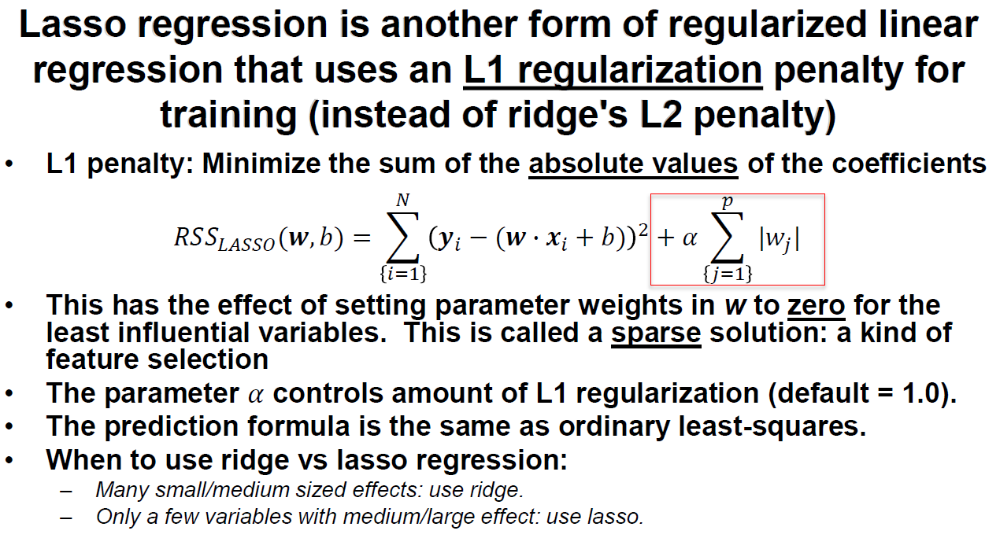

With lasso regression, a subset of the coefficients are forced to be precisely zero. Which is a kind of automatic feature selection, since with the weight of zero the features are essentially ignored completely in the model. This sparse solution where only a subset of the most important features are left with non-zero weights, also makes the model easier to interpret in cases where there are more than a few input variables. Like ridge regression, the amount of regularisation for the lasso regression is controlled by the parameter alpha, which by default is 1. Also like ridge regression, the purpose of using lasso regression is to estimate the W and B model coefficients. Once that's done, the prediction model formula is the same as for ordinary least-squares, you just use the linear model. 

In general, lasso regression is most helpful if you think there are only a few variables that have a medium or large effect on the output variable. Otherwise if there are lots of variables that contribute small or medium effects, ridge regression is typically the better choice.

To use lasso regression, you import the lasso class from sklearn.linear model, and then just use it as you would use an estimator like ridge regression. With some data sets you may occasionally get a convergence warning, in which case you can set the max_iter attribute to a larger value. So typically at least 20,000, or possibly more. Increasing the max inter-parameter will increase the computation time accordingly. 

In this example, we're applying lasso to a minmax scale version of the crime data set as we did for ridge regression. You can see that for Alpha set to 2.0, only 20 features with non-zero weights remain because with lasso regularisation, most of the features are set to have weights of exactly zero. I've listed the features with non-zero weights in order of their descending magnitude from the output. Although we need to be careful in interpreting any results for data on a complex problem like crime, the lasso regression results do help us see some of the strongest relationships between the input variables and outcomes for this particular data set. For example, looking at the top five features with non-zero weight that are found by lasso regression, we can see that location factors like percentage of people in dense housing, which indicates urban areas and socio economic variables like the fraction of vacant houses in an area are positively correlated with crime. And other variables like the percentage of families with two parents is negatively correlated.

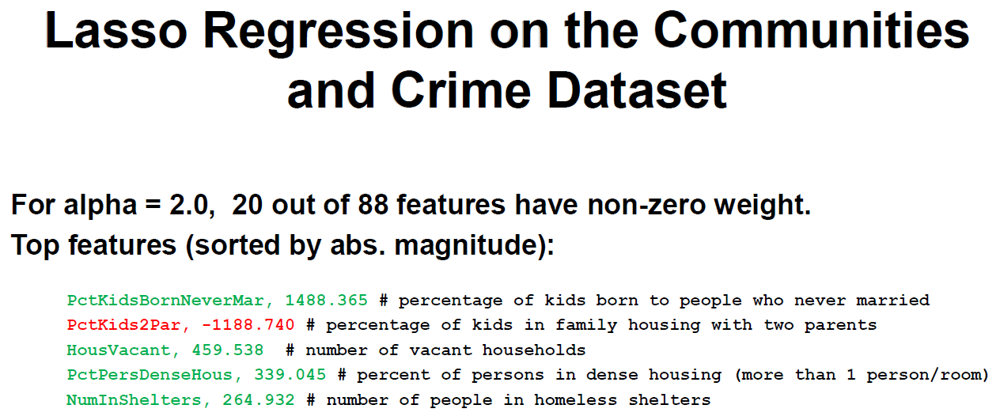

In [50]:
from sklearn.linear_model import Lasso
from sklearn.preprocessing import MinMaxScaler
scaler = MinMaxScaler()

X_train, X_test, y_train, y_test = train_test_split(X_crime, y_crime,
                                                   random_state = 0)

X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

linlasso = Lasso(alpha=2.0, max_iter = 10000).fit(X_train_scaled, y_train)

print('Crime dataset')
print('lasso regression linear model intercept: {}'
     .format(linlasso.intercept_))
print('lasso regression linear model coeff:\n{}'
     .format(linlasso.coef_))
print('Non-zero features: {}'
     .format(np.sum(linlasso.coef_ != 0)))
print('R-squared score (training): {:.3f}'
     .format(linlasso.score(X_train_scaled, y_train)))
print('R-squared score (test): {:.3f}\n'
     .format(linlasso.score(X_test_scaled, y_test)))
print('Features with non-zero weight (sorted by absolute magnitude):')

for e in sorted (list(zip(list(X_crime), linlasso.coef_)),
                key = lambda e: -abs(e[1])):
    if e[1] != 0:
        print('\t{}, {:.3f}'.format(e[0], e[1]))

Crime dataset
lasso regression linear model intercept: 1186.6120619985786
lasso regression linear model coeff:
[    0.       0.      -0.    -168.18    -0.      -0.       0.     119.69
     0.      -0.       0.    -169.68    -0.       0.      -0.       0.
     0.       0.      -0.      -0.       0.      -0.       0.       0.
   -57.53    -0.      -0.       0.     259.33    -0.       0.       0.
     0.      -0.   -1188.74    -0.      -0.      -0.    -231.42     0.
  1488.37     0.      -0.      -0.      -0.       0.       0.       0.
     0.       0.      -0.       0.      20.14     0.       0.       0.
     0.       0.     339.04     0.       0.     459.54    -0.       0.
   122.69    -0.      91.41     0.      -0.       0.       0.      73.14
     0.      -0.       0.       0.      86.36     0.       0.       0.
  -104.57   264.93     0.      23.45   -49.39     0.       5.2      0.  ]
Non-zero features: 20
R-squared score (training): 0.631
R-squared score (test): 0.624

Features with 

#### Lasso Regression with Regularization parameter: alpha

This code combines both Feature Normalized X_train and X_test data with Alpha effects.

Comparing the results of Ridge and Lasso with Feature Normalized crime dataset, Lasso (alpha=3) has slightly better test scores than Ridge (alpha=20) regression, 0.63 vs 0.60.

In [51]:
print('Lasso regression: effect of alpha regularization\n\
parameter on number of features kept in final model\n')

for alpha in [0.5, 1, 2, 3, 5, 10, 20, 50]:
    linlasso = Lasso(alpha, max_iter = 10000).fit(X_train_scaled, y_train)
    r2_train = linlasso.score(X_train_scaled, y_train)
    r2_test = linlasso.score(X_test_scaled, y_test)
    
    print('Alpha = {:.2f}\nFeatures kept: {}, r-squared training: {:.2f}, \
r-squared test: {:.2f}\n'
         .format(alpha, np.sum(linlasso.coef_ != 0), r2_train, r2_test))

Lasso regression: effect of alpha regularization
parameter on number of features kept in final model

Alpha = 0.50
Features kept: 35, r-squared training: 0.65, r-squared test: 0.58

Alpha = 1.00
Features kept: 25, r-squared training: 0.64, r-squared test: 0.60

Alpha = 2.00
Features kept: 20, r-squared training: 0.63, r-squared test: 0.62

Alpha = 3.00
Features kept: 17, r-squared training: 0.62, r-squared test: 0.63

Alpha = 5.00
Features kept: 12, r-squared training: 0.60, r-squared test: 0.61

Alpha = 10.00
Features kept: 6, r-squared training: 0.57, r-squared test: 0.58

Alpha = 20.00
Features kept: 2, r-squared training: 0.51, r-squared test: 0.50

Alpha = 50.00
Features kept: 1, r-squared training: 0.31, r-squared test: 0.30



### Polynomial Regression (a form of Linear Regression with added polynomial combination features to the original two features, x0, x1)

Let's suppose for a moment that we had a set of two-dimensional data points with features x0 and x1. Then we could transform each data point by adding additional features that were the three unique multiplicative combinations of x0 and x1. So, x0 squared, x0x1, and x1 squared. So we've transformed our original two-dimensional points into a set of five-dimensional points that rely only on the information in the two-dimensional points. Now we can write a new regression problem that tries to predict the same output variable y-hat but using these five features instead of two. The critical insight here is that this is still a linear regression problem. The features are just numbers within a weighted sum. So we can use the same least-squares techniques to estimate the five model coefficients for these five features that we used in these simpler two-dimensional case. 

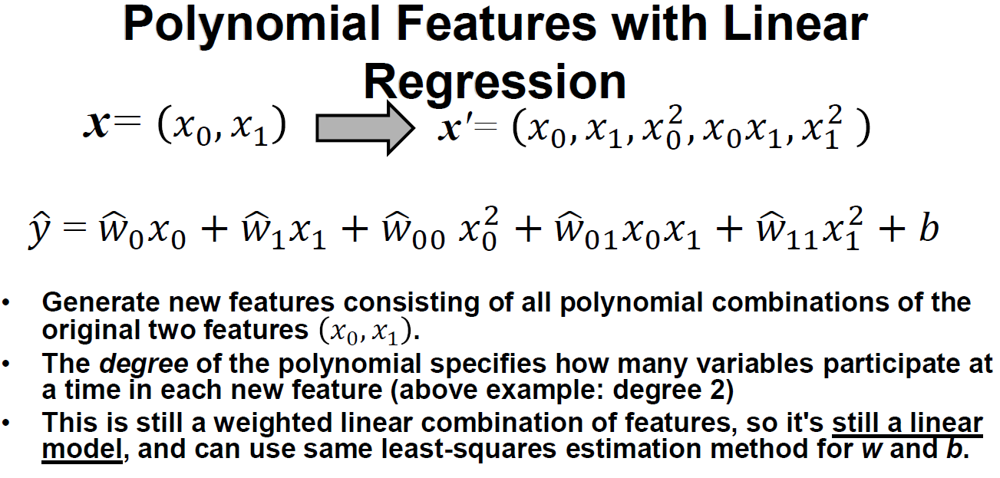

Now, why would we want to do this kind of transformation? Well, this is called polynomial feature transformation that we can use to transform a problem into a higher dimensional regression space. And in effect, adding these extra polynomial features allows us a much richer set of complex functions that we can use to fit to the data. So you can think of this intuitively as allowing polynomials to be fit to the training data instead of simply a straight line, but using the same least-squares criterion that minimizes mean square error. We'll see later that this approach of adding new features like polynomial features is also very effective with classification. And we'll look at this kind of transformation again in kernelized support vector machines. When we add these new polynomial features, we're essentially adding to the model's ability to capture interactions between the different variables by adding them as features to the linear model. 

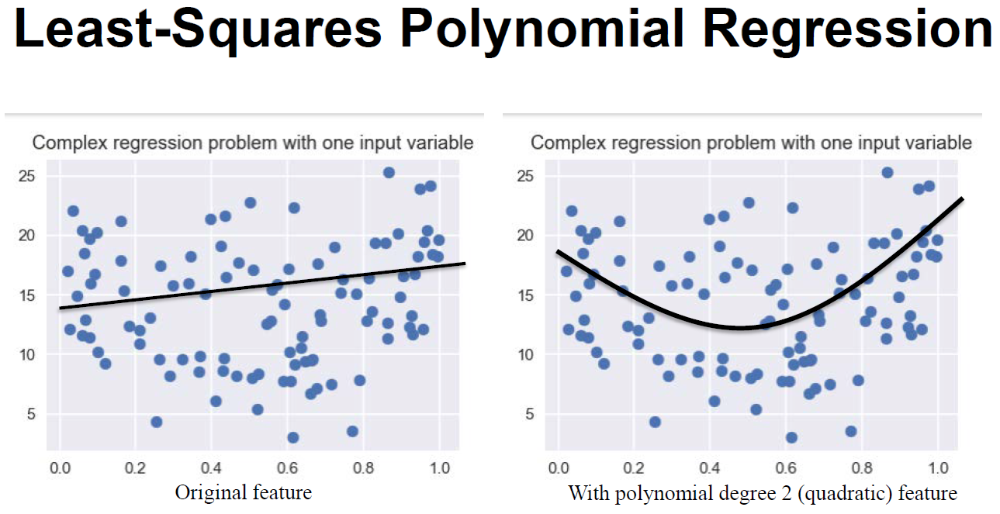

For example, it may be that housing prices vary as a quadratic function of both the lot size that a house sits on, and the amount of taxes paid on the property as a theoretical example. A simple linear model could not capture this nonlinear relationship, but by adding nonlinear features like polynomials to the linear regression model, we can capture this nonlinearity. Or generally, we can use other types of nonlinear feature transformations beyond just polynomials. This is beyond the scope of this course but technically these are called nonlinear basis functions for regression, and are widely used. Of course, one side effect of adding lots of new features especially when we're taking every possible combination of K variables, is that these more complex models have the potential for overfitting. So in practice, polynomial regression is often done with a regularized learning method like ridge regression. 

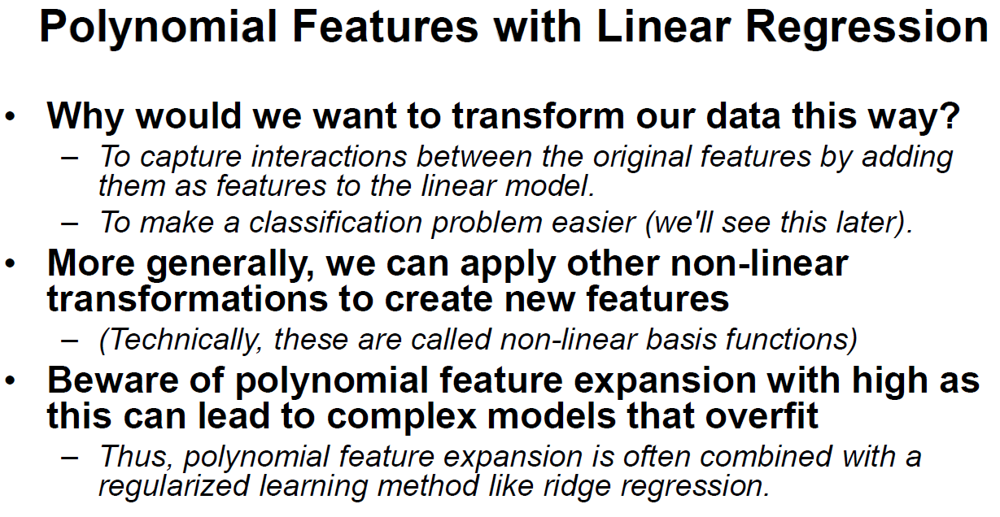

Here's an example of polynomial regression using scikit-learn. There's already a handy class called PolynomialFeatures in the sklearn.preprocessing module that will generate these polynomial features for us. This example shows three regressions on a more complex regression dataset, that happens to have some quadratic interactions between variables. 

The first regression here, just uses least-squares regression without the polynomial feature transformation. 

The second regression creates the polynomial features object with degree=2, and then calls the fit_transform method of the polynomial features object on the original X_F1 features (BEFORE train_test_split, unlike that of MinMax scaling), to produce the new polynomial transform features X_F1_poly. The code then calls ordinary least-squares linear regression. You can see indications of overfitting on this expanded feature representation, as the models r-squared score on the training set is close to one but much lower on the test set. 

The third regression shows the effect of adding regularisation via ridge regression on this expanded feature set. Now, the training and tests r-squared scores are basically the same, with the test set score of the regularized polynomial regression performing the best of all three regression methods.

In [52]:
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import Ridge
from sklearn.preprocessing import PolynomialFeatures


X_train, X_test, y_train, y_test = train_test_split(X_F1, y_F1,
                                                   random_state = 0)
linreg = LinearRegression().fit(X_train, y_train)

print('linear model coeff (w): {}'
     .format(linreg.coef_))
print('linear model intercept (b): {:.3f}'
     .format(linreg.intercept_))
print('R-squared score (training): {:.3f}'
     .format(linreg.score(X_train, y_train)))
print('R-squared score (test): {:.3f}'
     .format(linreg.score(X_test, y_test)))
# ==============================================
print('\nNow we transform the original input data to add\n\
polynomial features up to degree 2 (quadratic)\n')
poly = PolynomialFeatures(degree=2)
# As noted, poly.fit_transform is applied to original dataset before train_test_split
X_F1_poly = poly.fit_transform(X_F1) 

X_train, X_test, y_train, y_test = train_test_split(X_F1_poly, y_F1,
                                                   random_state = 0)
linreg = LinearRegression().fit(X_train, y_train)

print('(poly deg 2) linear model coeff (w):\n{}'
     .format(linreg.coef_))
print('(poly deg 2) linear model intercept (b): {:.3f}'
     .format(linreg.intercept_))
print('(poly deg 2) R-squared score (training): {:.3f}'
     .format(linreg.score(X_train, y_train)))
print('(poly deg 2) R-squared score (test): {:.3f}\n'
     .format(linreg.score(X_test, y_test)))
# ==============================================
print('\nAddition of many polynomial features often leads to\n\
overfitting, so we often use polynomial features in combination\n\
with regression that has a regularization penalty, like ridge\n\
regression.\n')

X_train, X_test, y_train, y_test = train_test_split(X_F1_poly, y_F1,
                                                   random_state = 0)
linreg = Ridge().fit(X_train, y_train)

print('(poly deg 2 + ridge) linear model coeff (w):\n{}'
     .format(linreg.coef_))
print('(poly deg 2 + ridge) linear model intercept (b): {:.3f}'
     .format(linreg.intercept_))
print('(poly deg 2 + ridge) R-squared score (training): {:.3f}'
     .format(linreg.score(X_train, y_train)))
print('(poly deg 2 + ridge) R-squared score (test): {:.3f}'
     .format(linreg.score(X_test, y_test)))

linear model coeff (w): [ 4.42  6.    0.53 10.24  6.55 -2.02 -0.32]
linear model intercept (b): 1.543
R-squared score (training): 0.722
R-squared score (test): 0.722

Now we transform the original input data to add
polynomial features up to degree 2 (quadratic)

(poly deg 2) linear model coeff (w):
[ 3.41e-12  1.66e+01  2.67e+01 -2.21e+01  1.24e+01  6.93e+00  1.05e+00
  3.71e+00 -1.34e+01 -5.73e+00  1.62e+00  3.66e+00  5.05e+00 -1.46e+00
  1.95e+00 -1.51e+01  4.87e+00 -2.97e+00 -7.78e+00  5.15e+00 -4.65e+00
  1.84e+01 -2.22e+00  2.17e+00 -1.28e+00  1.88e+00  1.53e-01  5.62e-01
 -8.92e-01 -2.18e+00  1.38e+00 -4.90e+00 -2.24e+00  1.38e+00 -5.52e-01
 -1.09e+00]
(poly deg 2) linear model intercept (b): -3.206
(poly deg 2) R-squared score (training): 0.969
(poly deg 2) R-squared score (test): 0.805


Addition of many polynomial features often leads to
overfitting, so we often use polynomial features in combination
with regression that has a regularization penalty, like ridge
regression.

(p

In [53]:
X_train.shape
#y_train


(75, 36)

## Linear models for classification

### Logistic regression (a form of Linear Classifier)

We're now going to look at a second supervised learning method that in spite of being called a regression measure, is actually used for classification and it’s called logistic regression.

Logistic regression can be seen as a kind of generalized linear model.

And like ordinary least squares and other regression methods, logistic regression takes a set input variables, the features, and estimates a target value.

However, unlike ordinary linear regression, in it's most basic form logistic regressions target value is a binary variable instead of a continuous value.

There are flavors of logistic regression that can also be used in cases where the target value to be predicted is a multi class categorical variable, not just binary. But for now we'll focus on the simple binary case of logistic regression.

#### Logistic regression for binary classification on fruits dataset using height, width features (positive class: apple, negative class: others)

Linear regression predicts a real valued output y based on a weighted sum of input variables or features xi, plus a constant b term.

This diagram shows that formula in graphical form. The square boxes on the left represent the input features, xi. And the values above the arrows represent the weights that each xi is multiplied by.

The output variable y in the box on the right is the sum of all the weighted inputs that are connected into it.

Note that we're adding b as a constant term by treating it as the product of a special constant feature with value 1 multiplied by a weight of value b. This formula is summarized in equation form below the diagram.

The job of linear regression is to estimate values for the model coefficients, wi hat and b hat.

They give a model that best fit the training data with minimal squared error.

Logistic regression is similar to linear regression, but with one critical addition.

Here, we show the same type of diagram that we showed for linear regression with the input variables, xi in the left boxes and the model coefficients wi and b above the arrows. The logistic regression model still computes a weighted sum of the input features xi and the intercept term b, but it runs this result through a special non-linear function f, the logistic function represented by this new box in the middle of the diagram to produce the output y.

The logistic function itself is shown in more detail on the plot on the right. It's an S shaped function that gets closer and closer to 1 as the input value increases above 0 and closer and closer to 0 as the input value decreases far below 0. The effect of applying the logistic function is to compress the output of the linear function so that it's limited to a range between 0 and 1. Below the diagram, you can see the formula for the predicted output y hat which first computes the same linear combination of the inputs xi, model coefficient weights wi hat and intercept b hat, but runs it through the additional step of applying the logistic function to produce y hat.

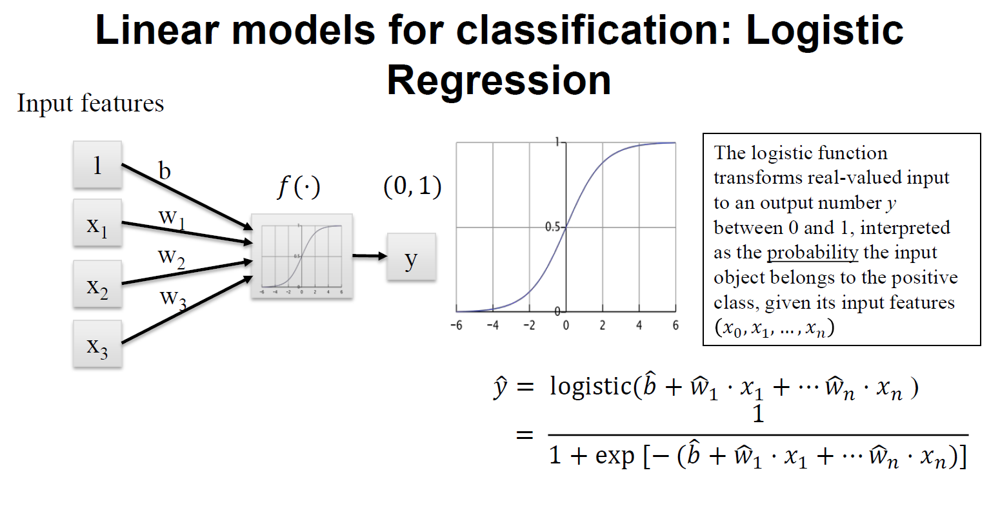

Here the plots show a training set with two classes. Each data point has two features. Feature 1 corresponds to the x-axis, and Feature 2 corresponds to the y-axis. The data points in the red class on the left, form a cluster with low Feature 1 value, and high Feature 2 value. And the points in the blue class have intermediate Feature 1 value, and low Feature 2 value.

We can apply logistic regression to learn a binary classifier using this training set, using the same idea we saw in the previous exam example.

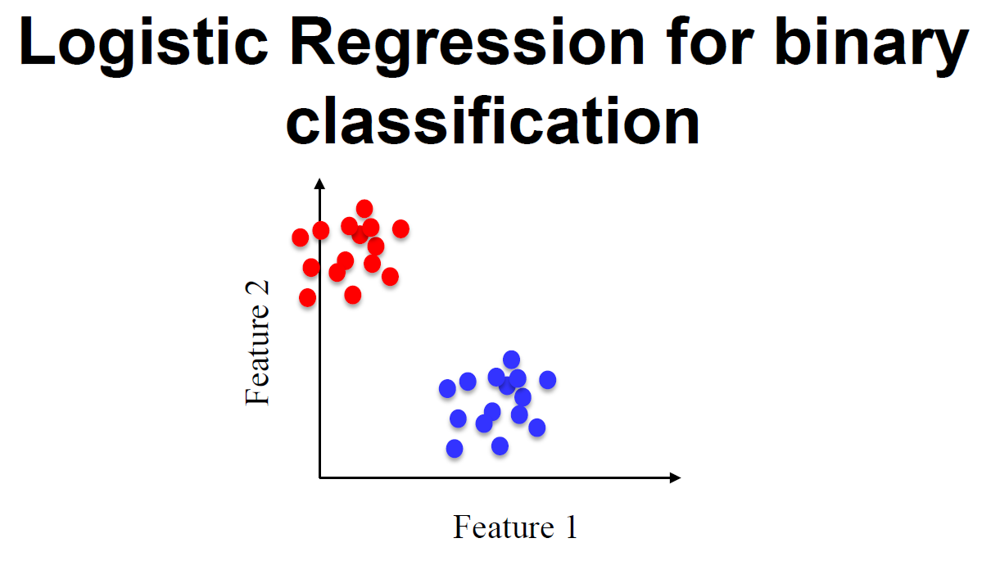

To do this, we'll add a third dimension shown here as the vertical y-axis. Corresponding to the probability of belonging to the positive class. We'll say that the red points are associated with the negative class and have a target value of 0, and the blue points are associated with the positive class and have a target value of 1.

Then just as we did in the exam studying example, we can estimate the w hat and b hat parameters of the logistic function that best fits this training data. The only difference is that the logistic function is now a function of two input features and not just one. So it forms something like a three dimensional S shaped sheet in this space. Once this logistic function has been estimated from the training data, we can use it to predict the class membership for any point, given its Feature 1 and Feature 2 values, same way we did for the exam example. Any data instances whose logistic probability estimate y hat is greater than or equal to 0.5 are predicted to be in the positive blue class, otherwise, in the other red class. Now if we imagine that there's a plane representing y equals 0.5, as shown here, that intersects this logistic function. It turns out that all the points that have a value of y = 0.5, when you intersect that with a logistic function, the points all lie along a straight line.  In other words, using logistic regression gives a linear decision boundary between the classes as shown here.

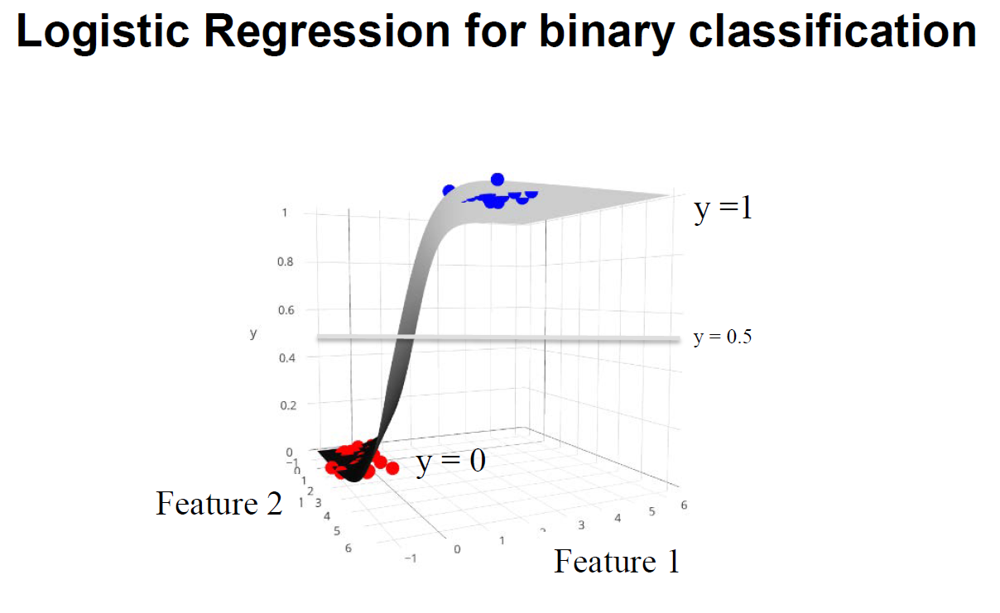

If you imagine looking straight down on the 3D logistic function, you get the view that looks something like this. The points with y greater or equal to 0.5 on the logistic function, lie in a region to the right of the straight line, which is the dash line on the right here. And the points with y less than 0.5 on the logistic function would form a region to the left of that dash line.

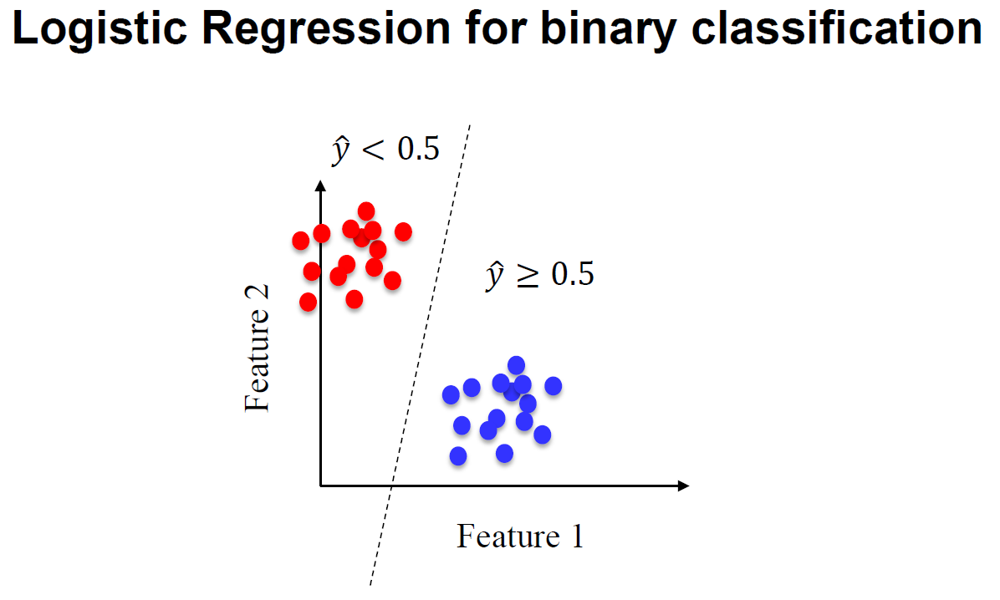

Let's look at an example with real data in Scikit-Learn. To perform logistic, regression in Scikit-Learn, you import the logistic regression class from the sklearn.linear model module, then create the object and call the fit method using the training data just as you did for other class files like k nearest neighbors.

Here, the code also sets a parameter c to 100, which we'll explain in a minute.

The data set we're using here is a modified form of our fruits data set, using only height and width as the features, the features space, and with the target class value modified into a binary classification problem predicting whether an object is an apple, a positive class, or something other than an apple, a negative class.

Here is a graphical display of the results. The x-axis corresponds to the height feature and the y-axis corresponds to the width feature. The black points represent the positive apple class training points. And the yellow points are instances of all the other fruits in the training set.

The gray decision region represents that area of the height and width feature space, where a fruit would have an estimated probability greater than 0.5 of being an apple. And thus classified as an apple according to the logistic regression function.

The yellow decision region corresponds to the region of feature space for objects that have an estimated probability of less than 0.5 of being an apple.

You can see the linear decision boundary where the grey region meets the yellow region, that results applying logistic regression.

In fact, logistic regression results are often quite similar to those you might obtain from a linear support vector machine, another type of linear model we explore for classification.

<IPython.core.display.Javascript object>


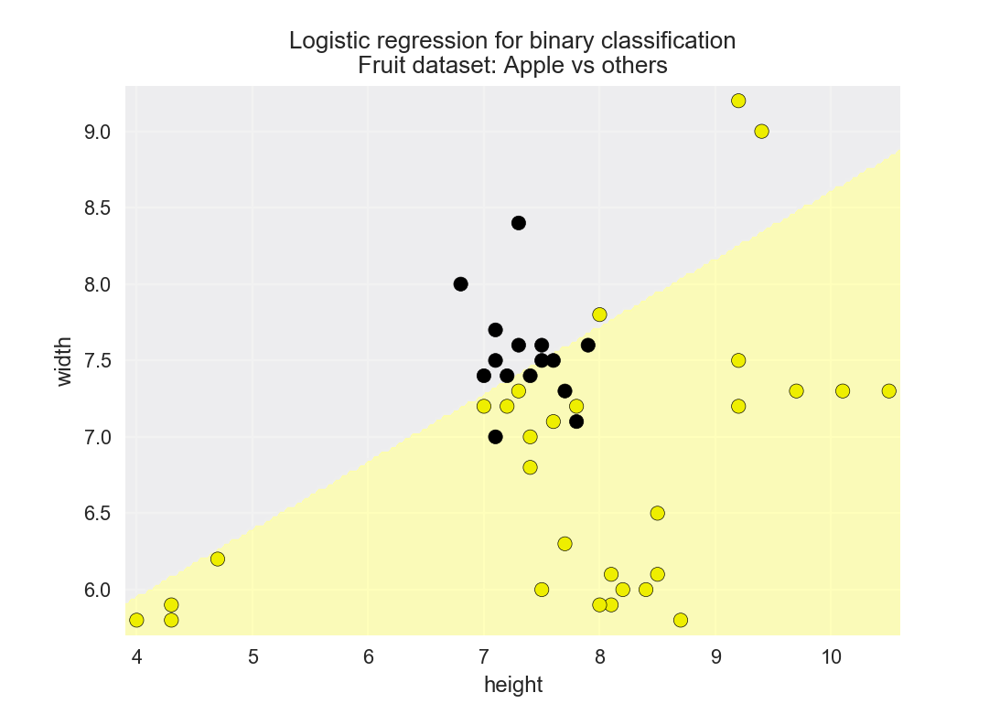

A fruit with height 6 and width 8 is predicted to be: an apple
A fruit with height 10 and width 7 is predicted to be: not an apple
Accuracy of Logistic regression classifier on training set: 0.77
Accuracy of Logistic regression classifier on test set: 0.73


C:\Users\redex\Anaconda3\lib\site-packages\ipykernel_launcher.py:19: DeprecationWarning: In future, it will be an error for 'np.bool_' scalars to be interpreted as an index
C:\Users\redex\Anaconda3\lib\site-packages\ipykernel_launcher.py:24: DeprecationWarning: In future, it will be an error for 'np.bool_' scalars to be interpreted as an index


In [54]:
from sklearn.linear_model import LogisticRegression
from adspy_shared_utilities import (
plot_class_regions_for_classifier_subplot)

fig, subaxes = plt.subplots(1, 1, figsize=(7, 5))
y_fruits_apple = y_fruits_2d == 1   # make into a binary problem: apples vs everything else
X_train, X_test, y_train, y_test = (train_test_split(X_fruits_2d.values, 
                                                     y_fruits_apple.values, random_state = 0))

clf = LogisticRegression(C=100).fit(X_train, y_train)
plot_class_regions_for_classifier_subplot(clf, X_train, y_train, None,
                                         None, 'Logistic regression \
for binary classification\nFruit dataset: Apple vs others',
                                         subaxes)

h = 6
w = 8
print('A fruit with height {} and width {} is predicted to be: {}'
     .format(h,w, ['not an apple', 'an apple'][clf.predict([[h,w]])[0]]))

h = 10
w = 7
print('A fruit with height {} and width {} is predicted to be: {}'
     .format(h,w, ['not an apple', 'an apple'][clf.predict([[h,w]])[0]]))
subaxes.set_xlabel('height')
subaxes.set_ylabel('width')

print('Accuracy of Logistic regression classifier on training set: {:.2f}'
     .format(clf.score(X_train, y_train)))
print('Accuracy of Logistic regression classifier on test set: {:.2f}'
     .format(clf.score(X_test, y_test)))

#### Logistic regression on simple synthetic dataset


<IPython.core.display.Javascript object>


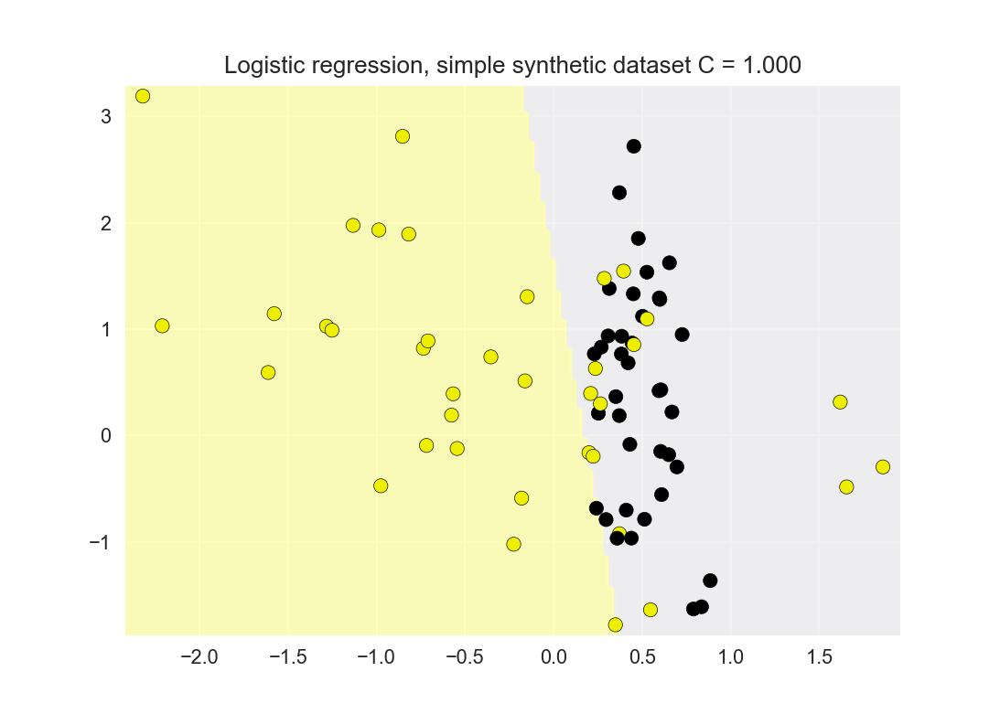

Accuracy of Logistic regression classifier on training set: 0.80
Accuracy of Logistic regression classifier on test set: 0.80


In [55]:
from sklearn.linear_model import LogisticRegression
from adspy_shared_utilities import (
plot_class_regions_for_classifier_subplot)


X_train, X_test, y_train, y_test = train_test_split(X_C2, y_C2,
                                                   random_state = 0)

fig, subaxes = plt.subplots(1, 1, figsize=(7, 5))
clf = LogisticRegression().fit(X_train, y_train)
title = 'Logistic regression, simple synthetic dataset C = {:.3f}'.format(1.0)
plot_class_regions_for_classifier_subplot(clf, X_train, y_train,
                                         None, None, title, subaxes)

print('Accuracy of Logistic regression classifier on training set: {:.2f}'
     .format(clf.score(X_train, y_train)))
print('Accuracy of Logistic regression classifier on test set: {:.2f}'
     .format(clf.score(X_test, y_test)))
     

#### Logistic regression regularization: C parameter

Like ridge and lasso regression, a regularization penalty on the model coefficients can also be applied with logistic regression, and is controlled with the parameter C. In fact, the same L2 regularization penalty used for ridge regression is turned on by default for logistic regression with a default value C = 1. Note that for both Support Vector machines and Logistic Regression, higher values of C correspond to less regularization. With large values of C, logistic regression tries to fit the training data as well as possible. While with small values of C, the model tries harder to find model coefficients that are closer to 0, even if that model fits the training data a little bit worse. You can see the effect of changing the regularization parameter C for logistic regression in this visual.

Using the same apple classifier we now vary C to take on values from 0.1 on the left to 1.0 in the middle, and 100.0 on the right. Although the real power of regularization doesn't become evident until we have data that has higher dimensional feature spaces. You can get an idea of the trade off that's happening between relying on a simpler model, one that puts more emphasis on a single feature in this case, out of the two features, but has lower training set accuracy. And that's an example as shown on the left with C = 0.1. Or, better training data fit on the right with C = 100. You can find the code that created this example in the accompanying notebook.

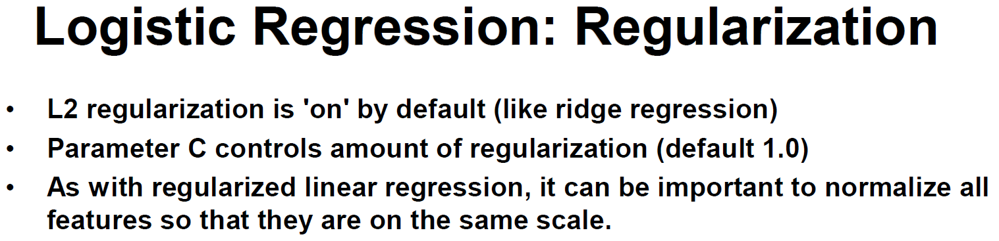

<IPython.core.display.Javascript object>


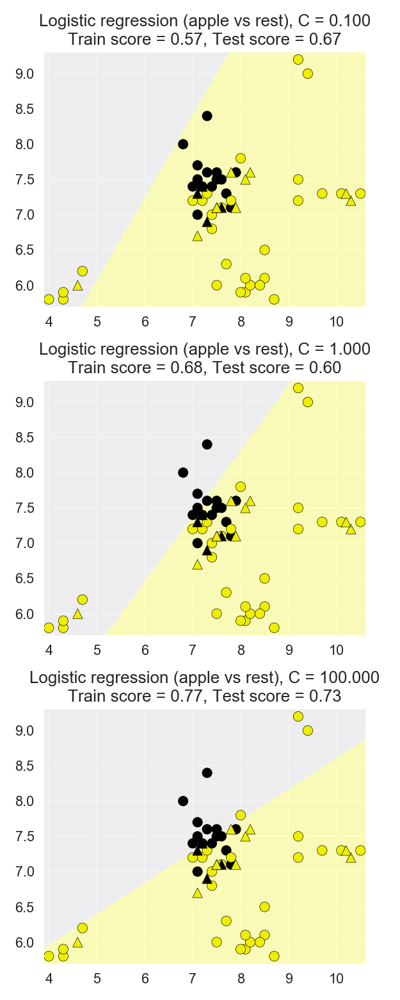

In [56]:
X_train, X_test, y_train, y_test = (
train_test_split(X_fruits_2d.values,
                y_fruits_apple.values,
                random_state=0))

fig, subaxes = plt.subplots(3, 1, figsize=(4, 10))

for this_C, subplot in zip([0.1, 1, 100], subaxes):
    clf = LogisticRegression(C=this_C).fit(X_train, y_train)
    title ='Logistic regression (apple vs rest), C = {:.3f}'.format(this_C)
    
    plot_class_regions_for_classifier_subplot(clf, X_train, y_train,
                                             X_test, y_test, title,
                                             subplot)
plt.tight_layout()

#### Application to real dataset

Finally, we show how logistic regression again, with L2 regularization turned on by default, can be applied to a real data set with many more features. The breast cancer data set.

Here, logistic regression achieves both training, and test set accuracy of 96%

In [57]:
from sklearn.linear_model import LogisticRegression

X_train, X_test, y_train, y_test = train_test_split(X_cancer, y_cancer, random_state = 0)

clf = LogisticRegression().fit(X_train, y_train)
print('Breast cancer dataset')
print('Accuracy of Logistic regression classifier on training set: {:.2f}'
     .format(clf.score(X_train, y_train)))
print('Accuracy of Logistic regression classifier on test set: {:.2f}'
     .format(clf.score(X_test, y_test)))

Breast cancer dataset
Accuracy of Logistic regression classifier on training set: 0.96
Accuracy of Logistic regression classifier on test set: 0.96


### Support Vector Machines

Let's look at how linear models are also used for classification, starting with binary classification.

This approach to prediction uses the same linear functional form as we saw for regression. But instead of predicting a continuous target value, we take the output of the linear function and apply the same function to produce a binary output with two possible values, corresponding to the two possible class labels.

If the target value is greater than zero, the function returns +1 and if it's less than zero, the function returns -1. Here's a specific example.

So let's take a look at a simple linear classification problem, a binary problem that has two different classes, and where each data instance is represented by two informative features. So we're going to call these features x1 on the x-axis and x2 on the y-axis. Now, how do we get from taking a data instance that's described by a particular combination of x1, x2 to a class prediction.

Well in a linear classifier, what we do is we take the feature values assigned to a particular data point. So in this case, it might be 2.1, 0.

So that represents the x1 and x2 feature values for this particular instance, let's say, and so that corresponds to the input here. And then we take those two x1, x2 values and put them through a linear function f here. And the output of this f needs to be a class value. So either we want it to return +1, if it's in one class and -1 if it's in the other class. So the linear classifier does that by computing a linear function of x1, x2 that's represented by this part of the equation here.

So this w is a vector of weights. This x represents the vector of feature values. And then b is a bias term that gets added in. So this is a dot product, this circle here is a dot product. Which means that, let's say, the simple case where we had (w1, w2), and a future vector of (x1, x2). The dot product of those is simply the linear combination of w1 x1 + w2 x2.

We take the X values, and we have certain weights that are learned for the classifier. So we compute w1 x1 + w2 x2. Then we feed that, and then plus a bias term, if there is one.

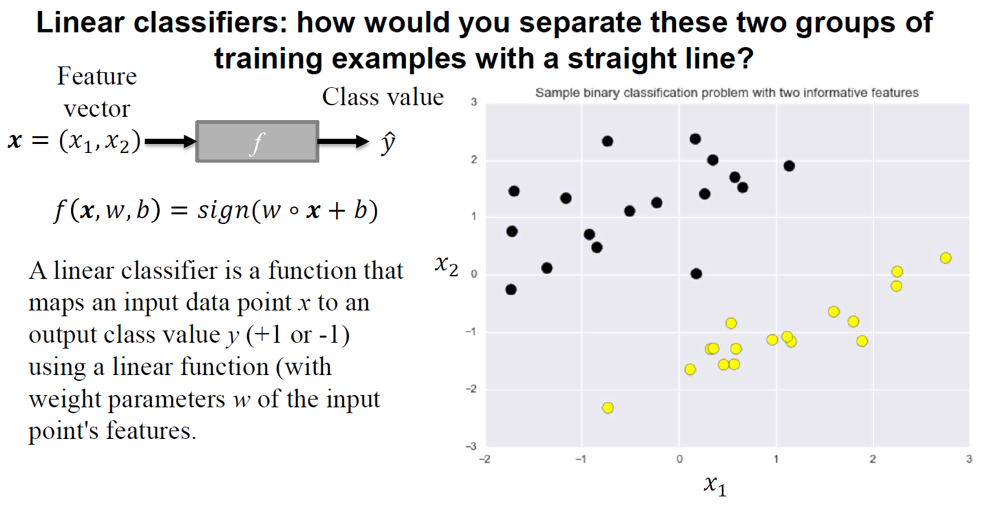

Okay, let's take a look using a specific linear function to see how this works in practice. So what I've done here is drawn a straight line through the space that is defined by the equation x1- x2 = 0. In other words, every point on this line satisfies this equation. So you can see, for example, that x1 = -1 and x2 = -1 and if you subtract them you get 0. Essentially, it's just the line that represents all the points where x1 and x2 are equal.

So this corresponds to, so we can rewrite this x1- x2 = 0 into a form that uses a dot product of weights with the input vector x. So in order to get x1- x2 = 0 that's equivalent writing a linear function where you have a weight vector of 1 and -1 and a bias term of 0 So for example, so if we have weights (w1, w2) dot (x1, x2). We call that this is just the same as computing w1 x1 + w2 x2. And so in this case, if w is 1 and -1, that's equivalent to x1- x2.

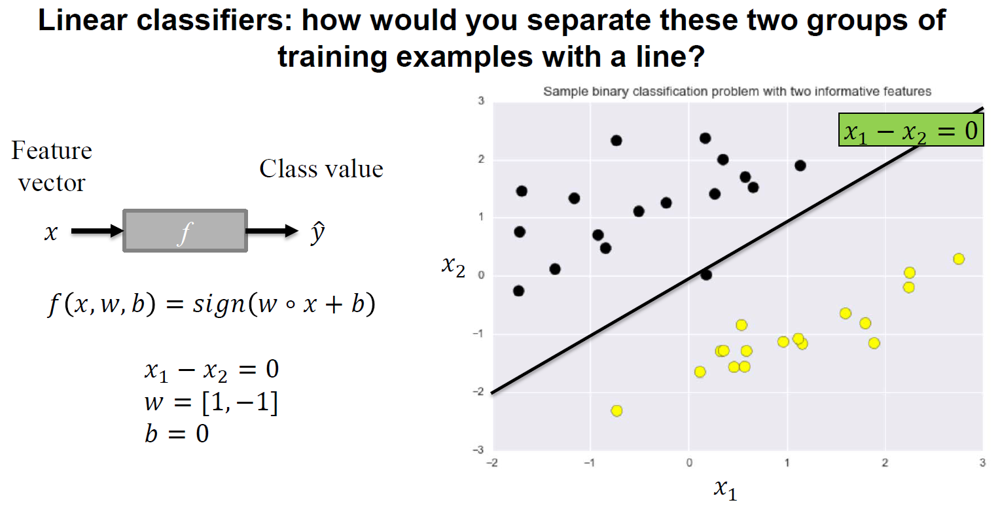

So all I've done here then is just convert the description of this line into a form that can be used as a decision rule for classifier. So I might have to look at a specific point. So suppose that we wanted to classify the point here that had coordinates -0.75 and -2.25. So this point right here. So all we would do to have a classifier make a decision with this decision boundary would be to plug in those coordinates into this part of the function, apply the weights and the bias term that describe the decision boundary.

So here we're computing. So this expression here corresponds to this part of the equation.

And so, if we compute w1 times x1 + w2 times x2 plus 0, we get a value of 0.15 that's inside the sign function. And then the sign function will output 1 if this value is greater than zero, which it is or -1, if the value is less than zero. So in this case, because it's greater than zero, the output from the decision function would be +1. So this has classified this point as being class 1.

If we look at a different point, let's take a look at the point -1.75 and -0.25. So again, we're just going to up, so this is corresponding to the value of x1 and x2. And again, if we just take these values and plug them into this part of the equation. Apply the weights and the bias term that describe the decision boundary as you did before. We do this computation, we find out that, in fact, classifier predicts a class of -1 here. So you see that by applying a simple linear formula, we've been able to produce a class value for any point in this two dimensional features space.

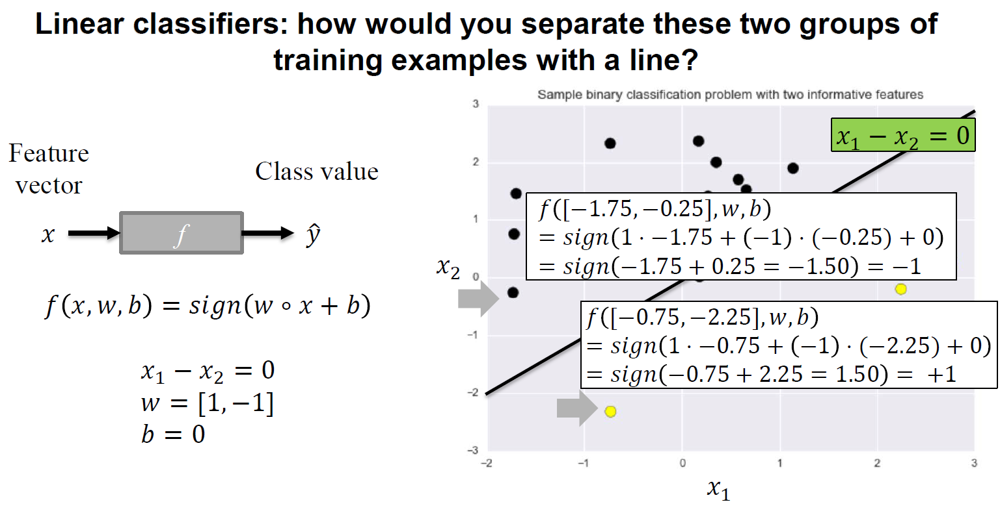

So one way to define a good classifier is to reward classifiers for the amount of separation that can provide between the two classes. And to do this, we need define the concept of classifier margin. So informally, for our given classifier, the margin is the width that the decision boundary can be increased before hitting a data point. So what we do is we take the decision boundary, and we grow a region around it. Sort of in this perpendicular to the line in this direction and that direction, and we grow this width until we hit a data point. So in this case, we were only able to grow the margin a small amount here, before hitting this data point. So this width here between the decision boundary and nearest data point represents the margin of this particular classifier.

Now you can imagine that for every classifier that we tried, we can do the same calculation or simulation to find the margin.

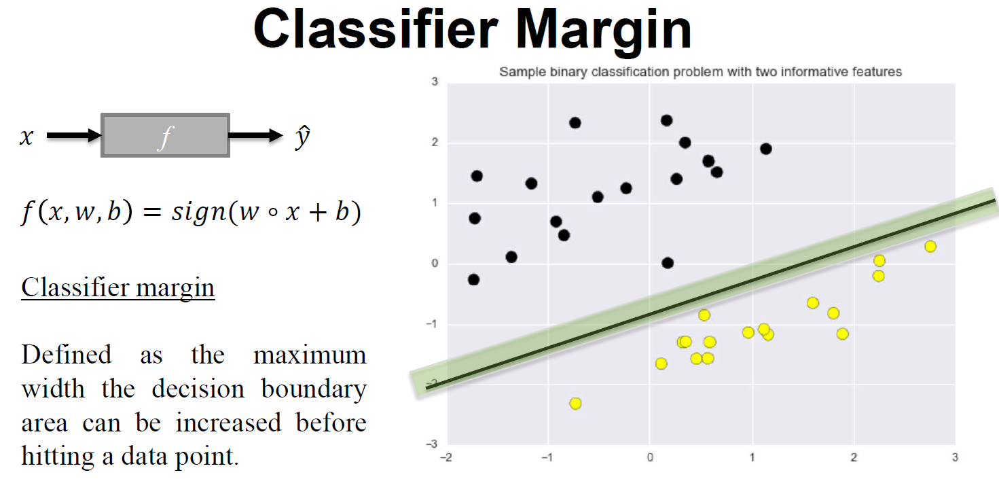

And so among all possible classifiers that separate these two classes then, we can define the best classifier as the classifier that has the maximum amount of margin which corresponds to the one shown here. So you recall that the original classifier on the previous slide had a very small margin. This one manages to achieve a much larger margin. So again, the margin is the distance the width that we can go from the decision boundary perpendicular to the nearest data point.

So you can see that by defining this concept of margin that sort of quantifies the degree to which the classifier can split the classes into two regions that have some amount of separation between them. We can actually do a search for the classifier that has the maximum margin. This maximum margin classifier is called the Linear Support Vector Machine, also known as an LSVM or a support vector machine with linear kernel. Now we'll explain more about what the concept of a kernel is and how you can define nonlinear kernels as well as kernels, and why you'd want to do that. We'll cover those shortly in a continuation of our support vector machine lecture later in this particular week.

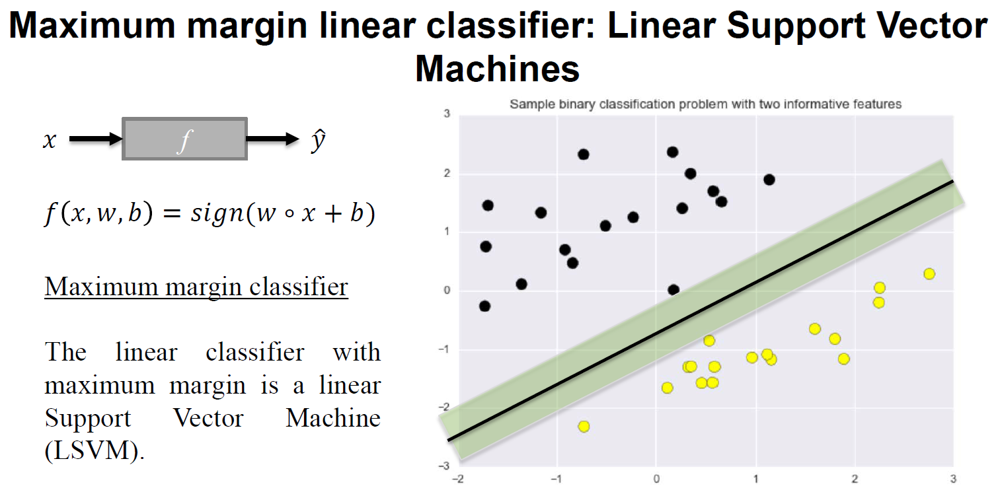

#### Linear Support Vector Machine

Here's an example in the notebook on how to use the default linear support vector classifier in scikit-learn, which is defined in the sklearn SVM library.

The linear SVC class implements a linear support vector classifier and is trained in the same way as other classifiers, namely by using the fit method on the training data. Now in the simple classification problem I just showed you, the two classes were perfectly separable with a linear classifier. In practice though, we typically have noise or just more complexity in the data set that makes a perfect linear separation impossible, but where most points can be separated without errors by linear classifier. And our simple binary classification dataset here is an illustration of that. So how tolerant the support vector machine is of misclassifying training points, as compared to its objective of minimizing the margin between classes is controlled by a regularization parameter called C which by default is set to 1.0 as we have here.

<IPython.core.display.Javascript object>


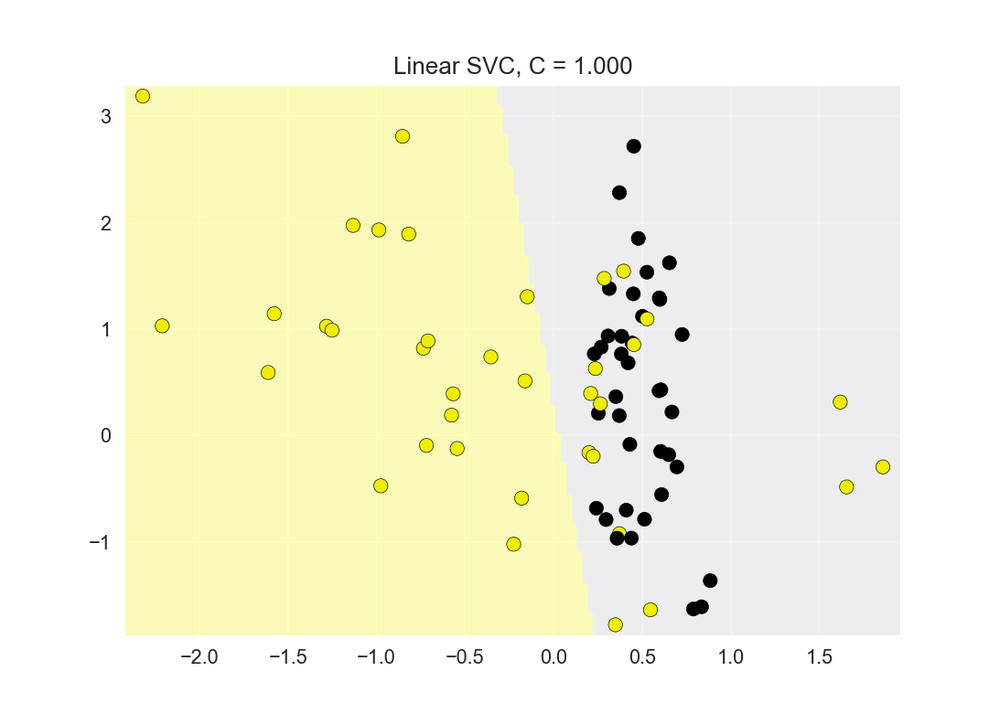

In [58]:
from sklearn.svm import SVC
from adspy_shared_utilities import plot_class_regions_for_classifier_subplot


X_train, X_test, y_train, y_test = train_test_split(X_C2, y_C2, random_state = 0)

fig, subaxes = plt.subplots(1, 1, figsize=(7, 5))
this_C = 1.0
clf = SVC(kernel = 'linear', C=this_C).fit(X_train, y_train)
title = 'Linear SVC, C = {:.3f}'.format(this_C)
plot_class_regions_for_classifier_subplot(clf, X_train, y_train, None, None, title, subaxes)

#### Linear Support Vector Machine: C parameter

Larger values of C represent less regularization and will cause the model to fit the training set with these few errors as possible, even if it means using a small margin decision boundary. Very small values of C on the other hand use more regularization that encourages the classifier to find a large margin on decision boundary, even if that decision boundary leads to more points being misclassified. Here's an example in the notebook showing the effect of varying C on this basic classification problem. On the right, when C is large, the decision boundary is adjusted so that more of the black training points are correctly classified. While on the left, for small values of C, the classifier is more tolerant of these errors in favor of capturing the majority of data points correctly with a larger margin.

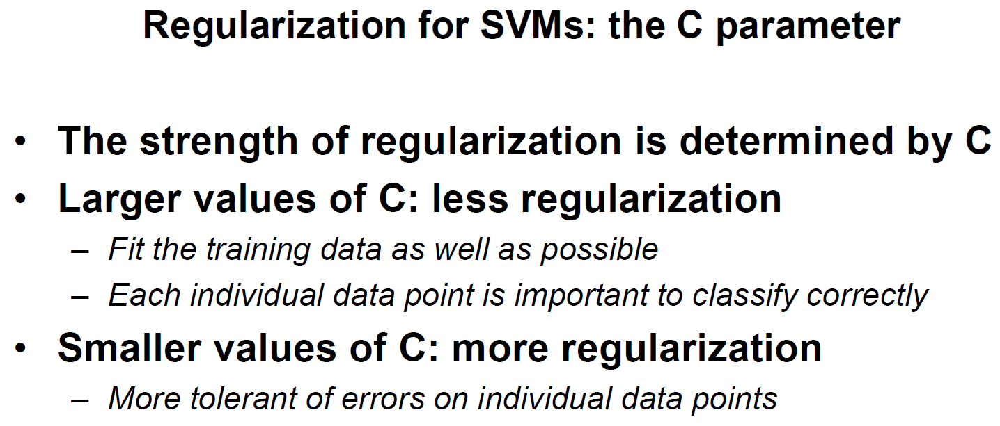

C:\Users\redex\Anaconda3\lib\site-packages\matplotlib\pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


<IPython.core.display.Javascript object>


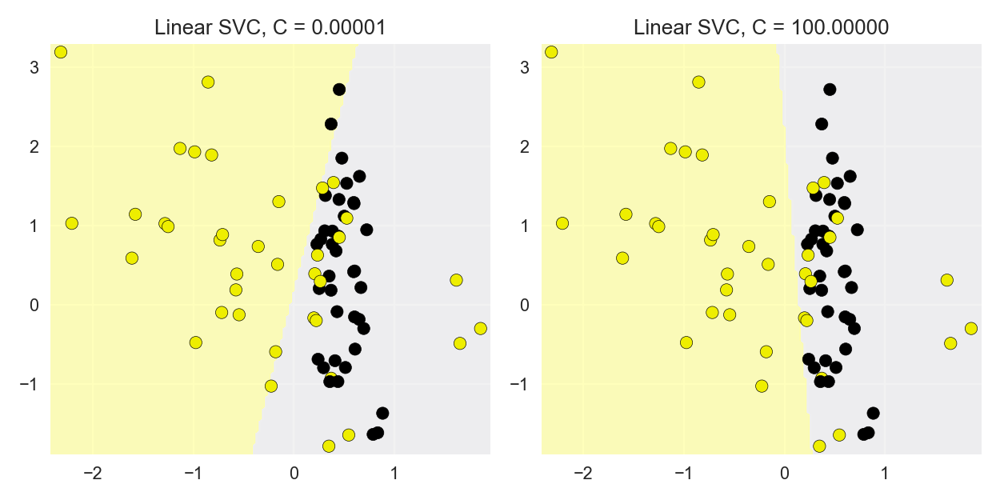

In [86]:
from sklearn.svm import LinearSVC
from adspy_shared_utilities import plot_class_regions_for_classifier_subplot

X_train, X_test, y_train, y_test = train_test_split(X_C2, y_C2, random_state = 0)
fig, subaxes = plt.subplots(1, 2, figsize=(8, 4))

for this_C, subplot in zip([0.00001, 100], subaxes):
    clf = LinearSVC(C=this_C).fit(X_train, y_train)
    title = 'Linear SVC, C = {:.5f}'.format(this_C)
    plot_class_regions_for_classifier_subplot(clf, X_train, y_train,
                                             None, None, title, subplot)
plt.tight_layout()

#### Application to real dataset

Finally, here's an example of applying the Linear Support Vector Machine to a real world data set, the breast cancer classification problem. And here, we can see that it achieves reasonable accuracy without much parameter tuning.

In [60]:
from sklearn.svm import LinearSVC
X_train, X_test, y_train, y_test = train_test_split(X_cancer, y_cancer, random_state = 0)

clf = LinearSVC().fit(X_train, y_train)
print('Breast cancer dataset')
print('Accuracy of Linear SVC classifier on training set: {:.2f}'
     .format(clf.score(X_train, y_train)))
print('Accuracy of Linear SVC classifier on test set: {:.2f}'
     .format(clf.score(X_test, y_test)))

Breast cancer dataset
Accuracy of Linear SVC classifier on training set: 0.91
Accuracy of Linear SVC classifier on test set: 0.94


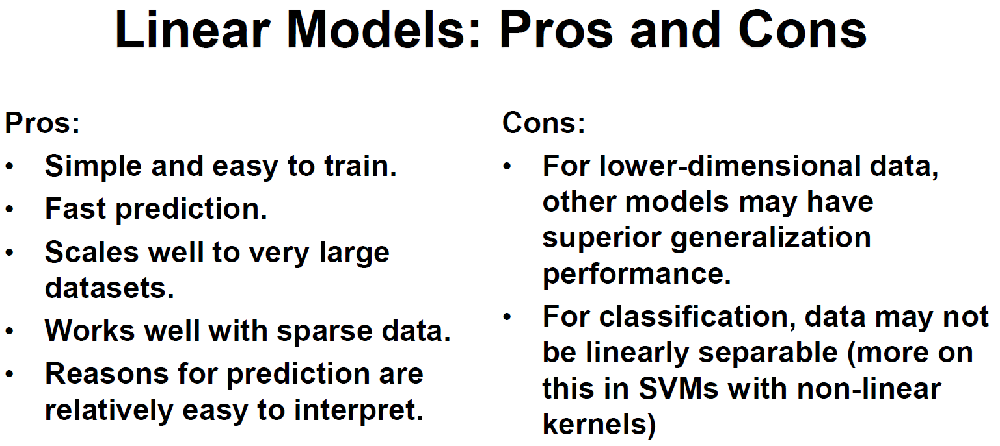

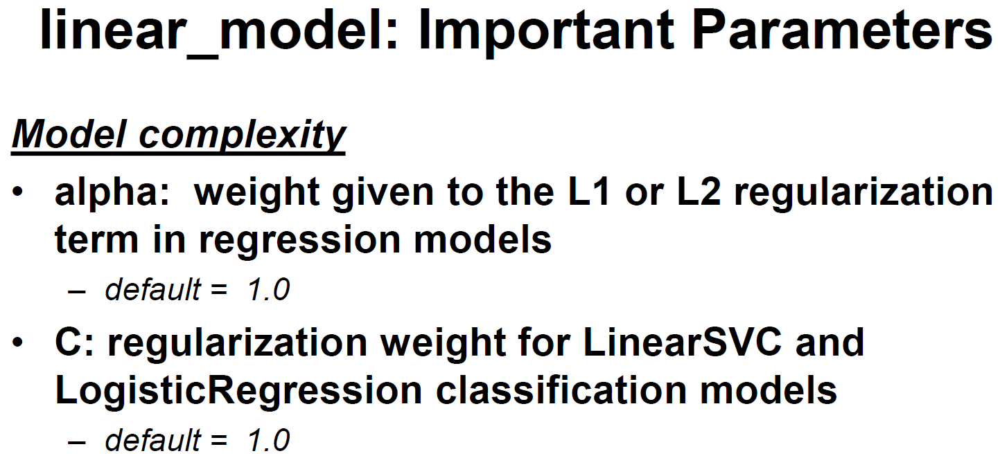

### Multi-class classification with linear models

#### LinearSVC with M classes generates M one vs rest classifiers.

In the examples we've used so far for classification. We've primarily focused on binary classification, where the target value to be predicted was a binary value that was either positive or negative class. In a lot of real world data sets the target value to be predicted is actually a category. For example, in our fruit dataset there were four different categories of fruit to be predicted, not just two. 

How do we deal with this multiclass classification situation with scikit-learn? Well, fortunately scikit-learn makes it very easy to learn multiclass classification models. Essentially, it does this by converting a multiclass classification problem into a series of binary problems. What do I mean by that? Well, essentially when you pass in a dataset that has a categorical variable for the target value, scikit-learn detects this automatically and then for each class to be predicted, scikit-learn creates one binary classifier that predicts that class against all the other classes. 

For example, in the fruit dataset there are four categories of fruit. So scikit-learn learns four different binary classifiers. To predict a new data instance, what it then does is, takes that data instance to be predicted, whose labels to be predict, and runs it against each of the binary classifiers in turn, and the classifier that has the highest score is the one that, whose class it uses, as the prediction value. 

Let's look at a specific example of multiclass classification with this fruit dataset. Here, we simply pass in the normal dataset that has the value from one to four as the category of fruit to be predicted. And we fit it exactly the same way that we would fit the model as if it were a binary problem. And in general, if we're just fitting, and then predicting, all of this would be completely transparent. Scikit-learn would simply do the right thing and it would learn multiple classes, and it would predict multiple classes, and we wouldn't really have to do much else. 

However, we can get access to what's happening under the hood as it were, if we look at the coefficients and the intercepts of the linear models that result from fitting to the training data. And this is what this example shows. So, what we're doing here is fitting a linear support vector machine to the fruit training data. And if we look at the coefficient values, we'll see that instead of just one pair of coefficients for a single linear model, a classifier, we actually get four values. And these values correspond to the four classes of fruit in the training set. And so, what scikit-learn has done here is it's created four binary classifiers, one for each class. And so, you can see there are four pairs of coefficients here and there are also four intercept values. So, in this case the first pair of coefficients corresponds to a classifier that classifies apples versus the rest of the fruit, and so, these pair of coefficients and this intercept define a straight line. In this case the apples in this visual are the red points, and so, the coefficients of the apple model define a decision boundary, a linear decision boundary, that's marked by this red line here. And if you plot it out you'll see that indeed it has an intercept of -3, and, you know, you can actually compute for any data instance using this linear formula with what will predict either apple or not an apple.

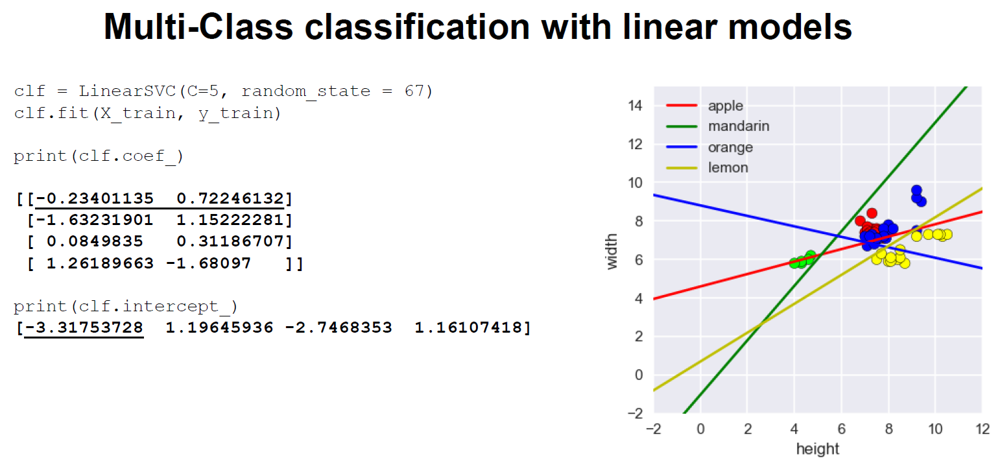

In [61]:
from sklearn.svm import LinearSVC

X_train, X_test, y_train, y_test = train_test_split(X_fruits_2d, y_fruits_2d, random_state = 0)

clf = LinearSVC(C=5, random_state = 67).fit(X_train, y_train)
print('Coefficients:\n', clf.coef_)
print('Intercepts:\n', clf.intercept_)

Coefficients:
 [[-0.23  0.72]
 [-1.63  1.15]
 [ 0.08  0.31]
 [ 1.26 -1.68]]
Intercepts:
 [-3.32  1.2  -2.75  1.16]


#### Multi-class results on the fruit dataset

If we take a specific example, something that has a height of 2 and a width of 6 so some query point here, for example. This is a linear classifier, so we can take the coefficients. This first pair of coefficients here, and this first intercept value here, and these form a linear classifier for apples versus not apples. So we can take the height feature, multiply it by the first coefficient, take the width feature, multiply it by the second coefficient, and then add in the third intercept feature. This third bias term. And so, to predict whether this object that has height of 2 and width of 6 is an apple, we simply compute this linear formula. It turns out that the value is positive 0.59. And so, because that value is greater than or equal to 0 that indicates that the model is predicting that the object is indeed an apple. And that makes sense because it's on this side of the apple versus not apple binary classifier decision boundary. 

Similarly, we can take another object, say one who has a height of 2 and the width of 2. So, in this part of the space over here. And we can plug in those two feature values into the same apple classifier. And when we do that it turns out that the prediction value for the linear model in that case is -2.3 and that's less than 0, which is on this side of the decision boundary. And so, the linear model for apple versus not apple here is predicting that this object is not an apple. And so, again, when scikit-learn has to predict the class of a new object with potentially multiple classes, it will go through each of these binary classifiers in turn and it will predict the class whose classifier has the highest score for that instance.

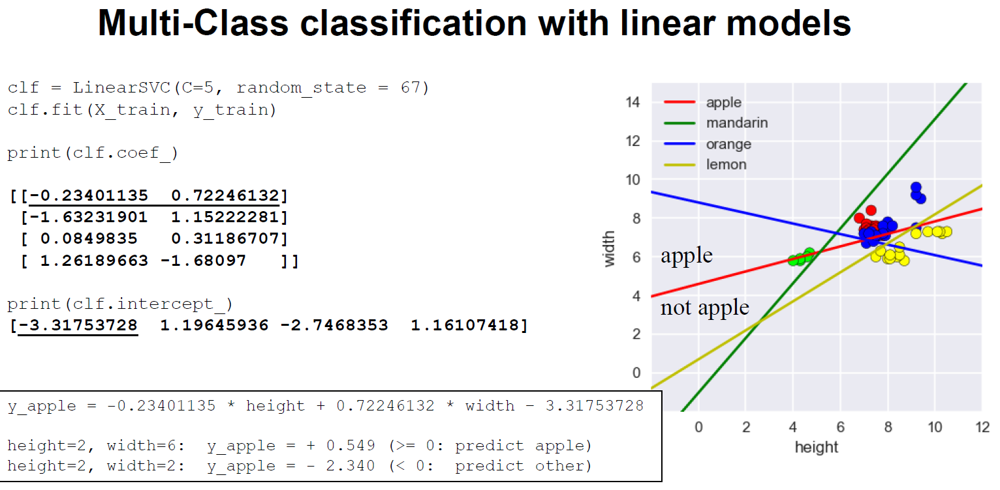

<IPython.core.display.Javascript object>


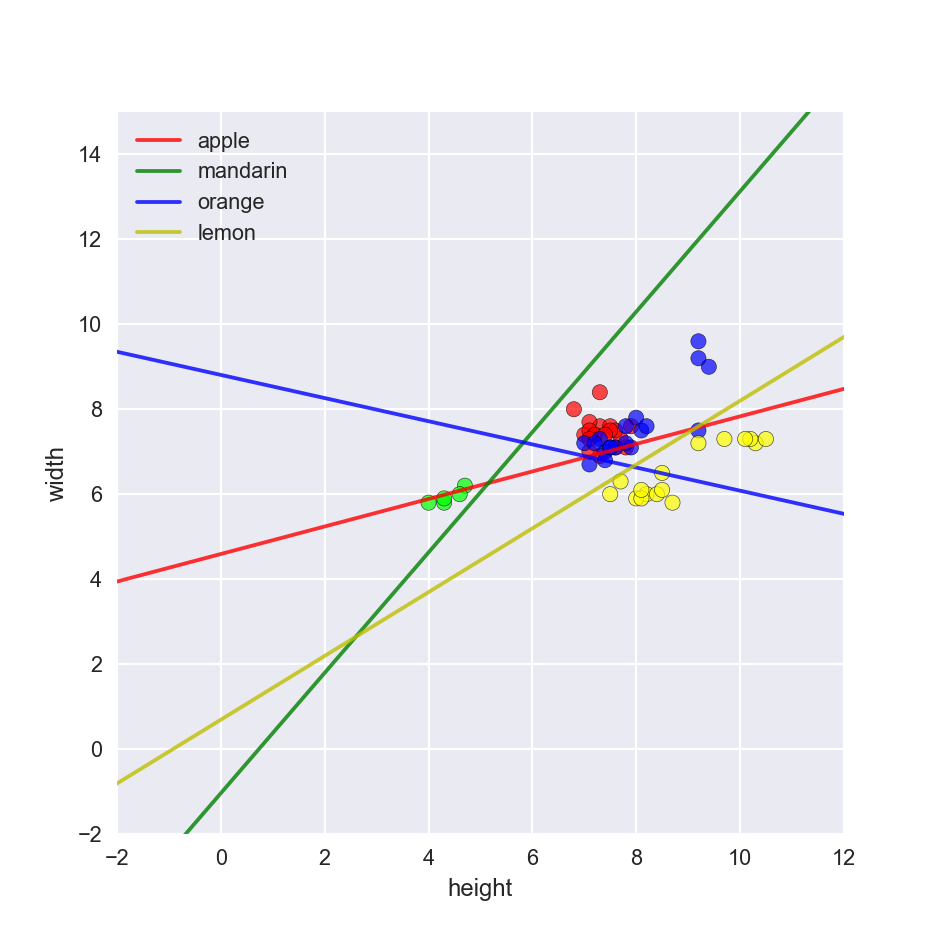

In [62]:
plt.figure(figsize=(6,6))
colors = ['r', 'g', 'b', 'y']
cmap_fruits = ListedColormap(['#FF0000', '#00FF00', '#0000FF','#FFFF00'])

plt.scatter(X_fruits_2d['height'], X_fruits_2d['width'],
            c=y_fruits_2d, cmap=cmap_fruits, edgecolor = 'black', alpha=.7)

x_0_range = np.linspace(-10, 15)

for w, b, color in zip(clf.coef_, clf.intercept_, ['r', 'g', 'b', 'y']):
    # Since class prediction with a linear model uses the formula y = w_0 x_0 + w_1 x_1 + b, 
    # and the decision boundary is defined as being all points with y = 0, to plot x_1 as a 
    # function of x_0 we just solve w_0 x_0 + w_1 x_1 + b = 0 for x_1:
    plt.plot(x_0_range, -(x_0_range * w[0] + b) / w[1], c=color, alpha=.8)
    
plt.legend(target_names_fruits)
plt.xlabel('height')
plt.ylabel('width')
plt.xlim(-2, 12)
plt.ylim(-2, 15)
plt.show()

## Kernelized Support Vector Machines

We saw earlier how linear support vector machines served as effective classifiers for some datasets, by finding a decision boundary with maximum margin between the classes.

Linear support vector machines worked well for simpler kinds of classification problems, where the classes were linearly separable or close to linearly separable like this example on the left.
But with real data, many classification problems aren't this easy. With the different classes located in future space in a way that a line or hyperplane can't act as an effective classifier. Here's an example on the right.
These dataset is difficult, or impossible for a linear model, a line or hyperplane, to classify well. So to help address the situation, we're now going to turn to our next type of supervised learning model. A very powerful extension of linear support vector machines called kernelized support vector machines.

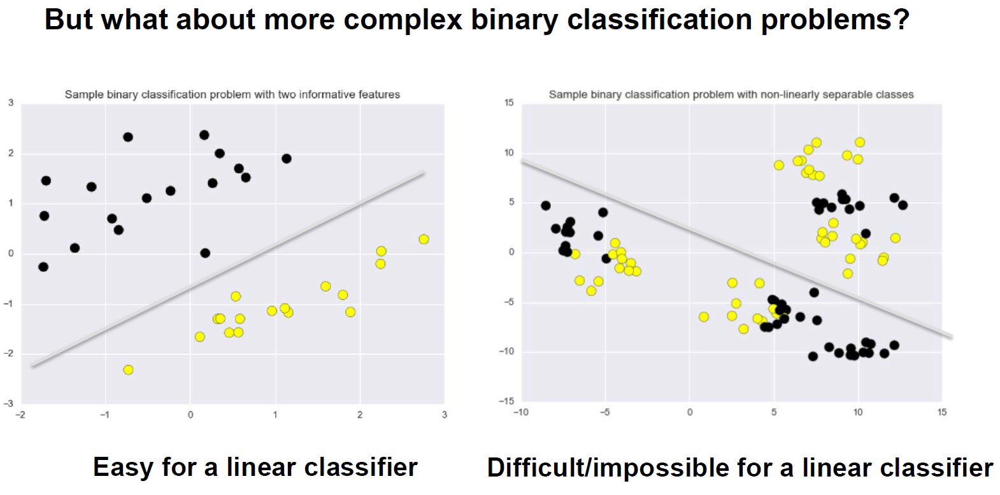

Basically, kernelized support vector machines, which I'll just call SVMs, can provide more complex models that can go beyond linear decision boundaries. As with other supervised machine learning methods, SVMs can be used for both classification and regression. But due to time constraints, we'll focus only on classification in this lecture. We also won't go into the mathematical details of how SVMs operate, but we will give an high level overview that hopefully captures the most important elements of this method.

In essence, one way to think about what kernelized SVMs do, is they take the original input data space and transform it to a new higher dimensional feature space, where it becomes much easier to classify the transform to data using a linear classifier. 

Here's a simple 1-dimensional example of what I mean. Here's a binary classification problem in 1-dimension with a set of points that lie along the x-axis. Color black for one class and white for the second class. Each data point here has just one feature. It's positioned on the x-axis. If we gave this problem to a linear support vector machine, it would have no problem finding the decision boundary. It gives the maximum margin between points of different classes.

Here I've engineered the data points, so that the maximum margin decision boundary happens to be at x = 0. Now suppose we gave the linear support vector machine a harder problem, where the classes are no longer linearly separable.

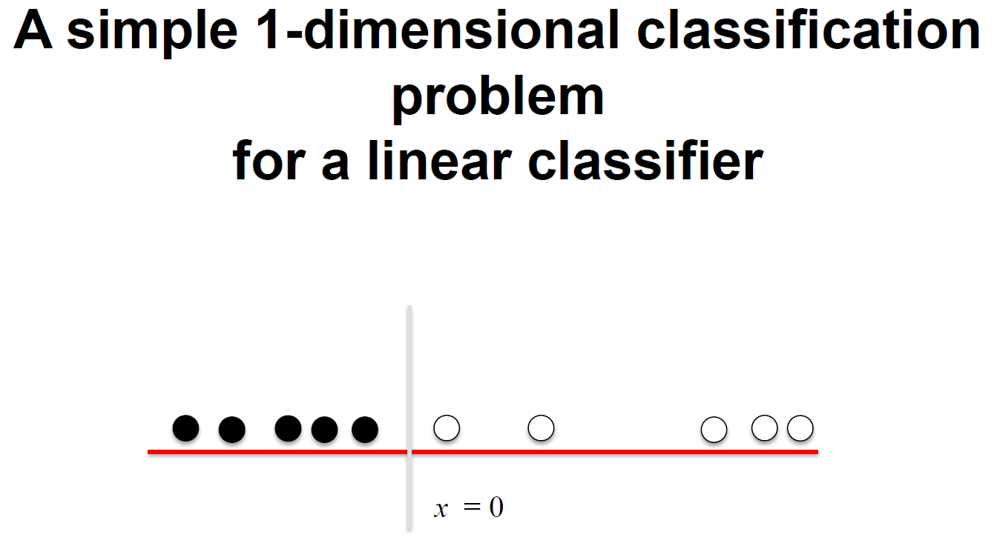

A simple linear decision boundary just doesn't have enough expressive power to classify all these points correctly.
So what can we do about this? One very powerful idea is to transform the input data from a 1-dimensional space to a 2-dimensional space.

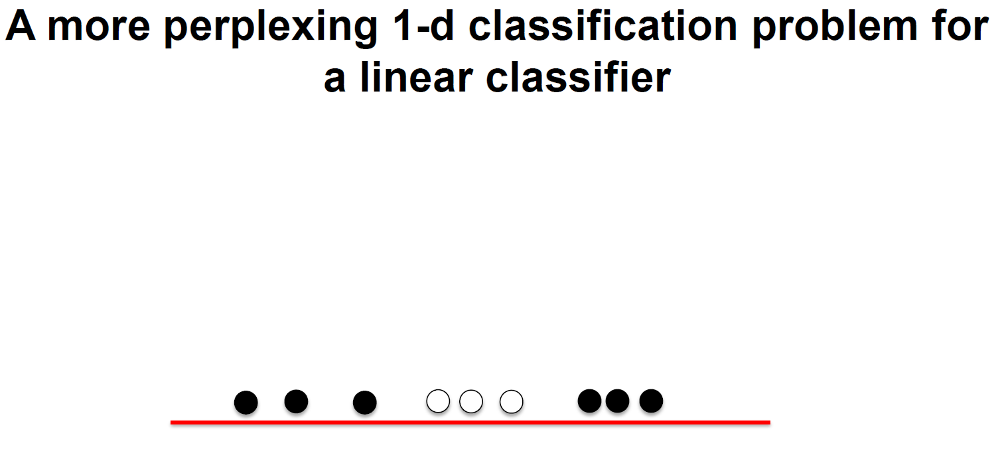

We can do this, for example, by mapping each 1-dimensional input data instance xi
to a corresponding 2-dimensional ordered pair xi, xi squared, whose new second feature is the squared value of the first feature. We're not adding in any new information in the sense that all we need to obtain this new 2-dimensional version is already present in the original 1-dimensional data point. This might remind you of a similar technique that we saw when adding polynomial features to a linear regression problem earlier in the course. 

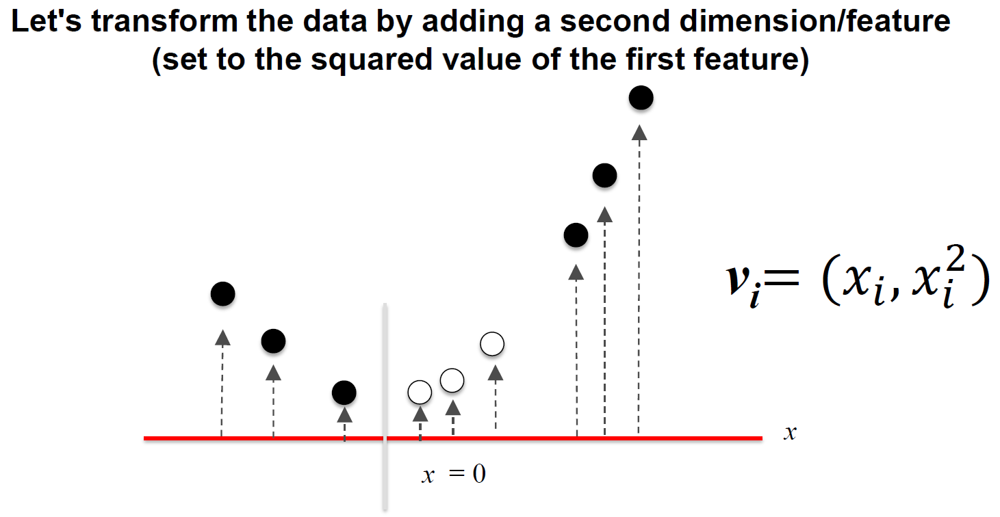

We can now learn a linear support vector machine in this new, 2-dimensional feature space, whose maximum margin decision boundary might look like this here to correctly classify the points.

Any future 1-dimensional points for which we'd like to predict the class, we can just create the 2-dimensional transformed version and predict the class of the 2-dimensional point, using this 2-dimensional linear SVM.

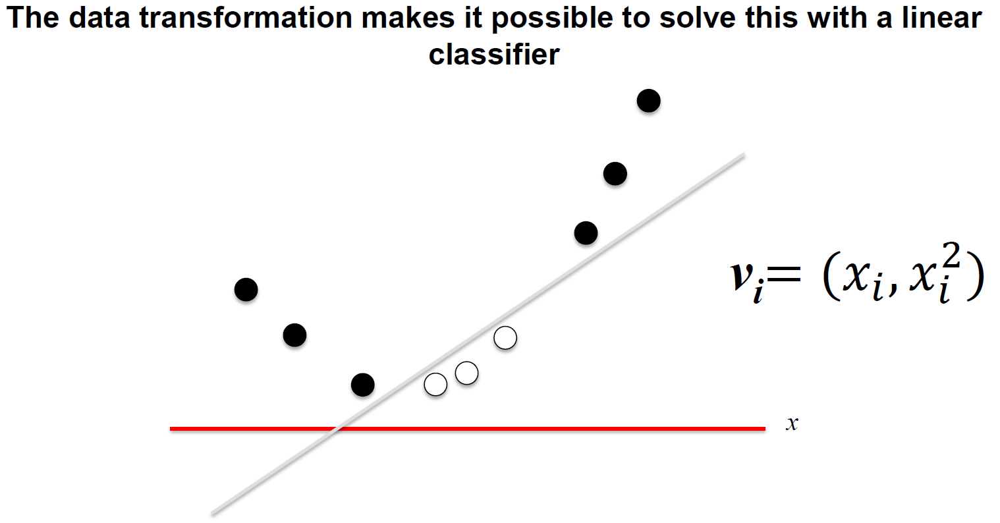

If we took the inverse of the transformation we just applied to bring the data points back to our original input space, we can see that the linear decision boundary in the 2-deminsional space corresponds to the two points where a parabola crosses the x-axis. 

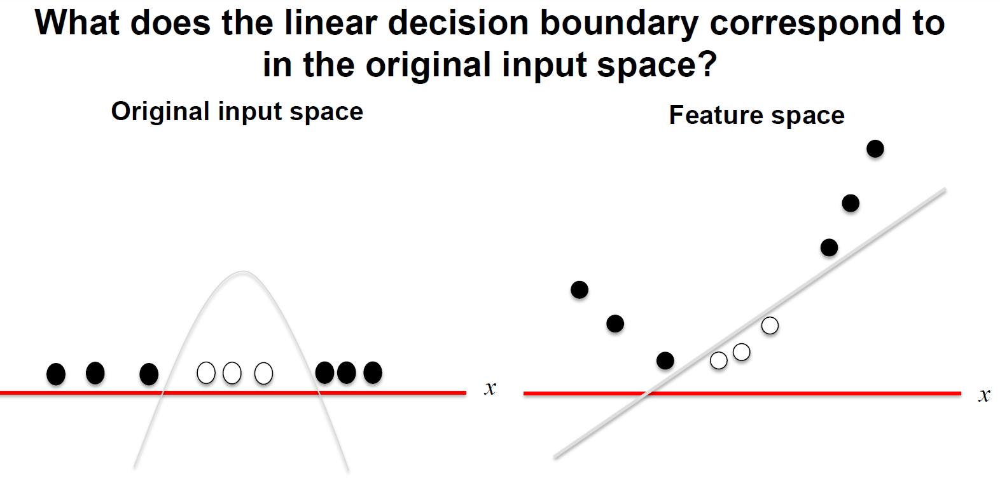

Now just so that this very important idea is clear, let's move from a 1-dimensional problem to a 2-dimensional classification problem. You can see the same powerful idea in action here.

Here we have two classes represented by the black and the white points. Each of which has two features, x0 and x1. The points of both classes are scattered around the origin 00 in a 2-dimensional plane. The white points form a cluster right around 0,0 that's completely surrounded by the black points. Again, this looks to be impossible for a linear classifier, which in 2-dimensional space is a straight line, to separate the white points from the black points with any degree of accuracy.

But just as we did in the 1-dimensional case, we can map each 2-dimensional point (x0,x1) to a new 3-dimensional point by adding a third feature. Mathematically 1-(x0 squared+x1 squared), and this transformation acts to shape the points into a parabaloid around (0,0). Now the wide points since they're close to (0,0), get mapped to points with higher vertical z values, that new third feature that are close to 1. While the black points which are farther from (0,0) get mapped to points with z values that either close to 0 or even negative.

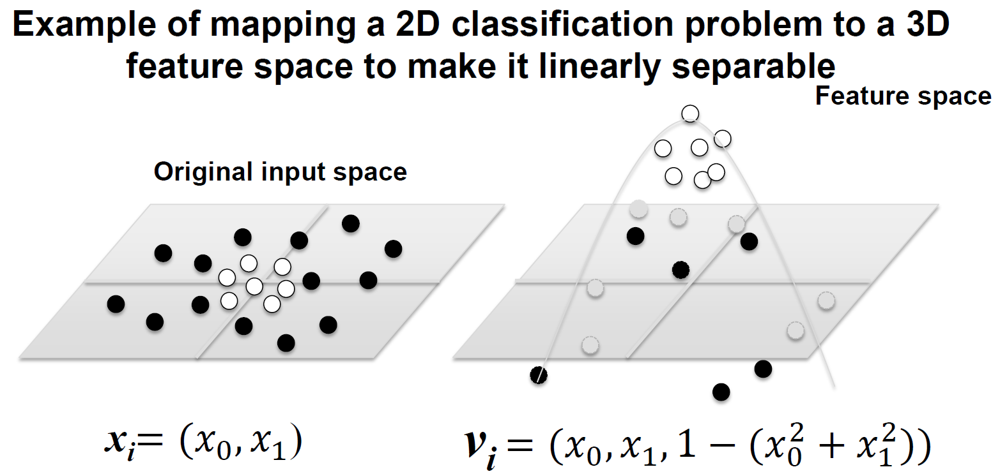

With this transformation, it makes it possible to find a hyperplane. Say, z = 0.9, that now easily separates the white data points that are near z = 1 from most or all of the black data points. Finally, the decision boundary consists of the set of points in 3-dimensional space where the paraboloid intersects the maximum margin hyperplane decision boundary.

This corresponds to an ellipse-like decision boundary in 2-dimensional space that separates the white points from the black points in the original input space.

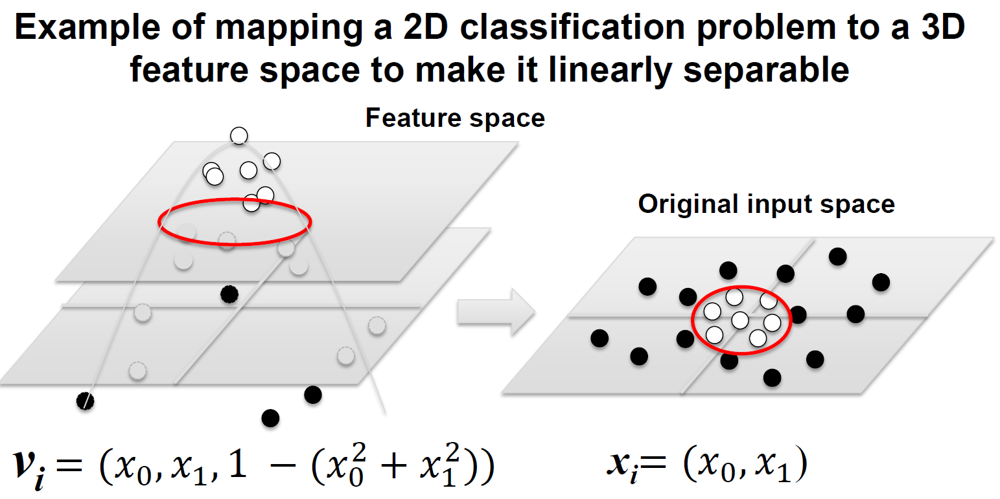

This idea of transforming the input data points to a new feature space where a linear classifier can be easily applied, is a very general and powerful one.

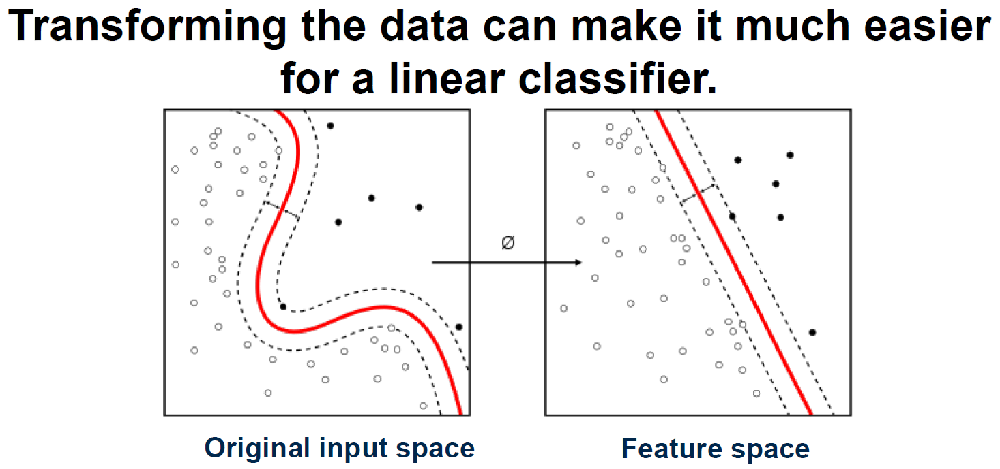

There are lots of different possible transformations we could apply to data. And the different kernels available for the kernelized SVM correspond to different transformations. Here we're going to focus mainly on what's called the radial basis function kernel, which we'll abbreviate as RBF. And also look briefly look at something called a polynomial kernel, that's also included with scikit-learns SVM module. The kernel function in an SVM tells us, given two points in the original input space, what is their similarity in the new feature space?

For the radial basis function kernel, the similarity between two points in the transformed feature space is an exponentially decaying function of the distance between the vectors in the original input space as shown by the formula here.

So what does the radial basis function feature transformation look like? Well, this diagram should give an intuitive idea. Here's another graphical illustration of a binary classification problem.  And again this diagram is for illustration purposes only and it's just an approximation, but essentially you can think of it in a similar way to the 2D to 3D example we saw earlier. So on the left, is a set of samples in the input space. The circles represent the training points of one class and the squares represent training points of a second class. On the right, the same samples are shown in the transformed feature space.

Using the radial basis function kernel in effect, transforms all the points inside a certain distance of the circle class to one area of the transformed feature space. And all the points in the square class outside a certain radius get moved to a different area of the feature space.
The dark circles and squares represents the points that might lie along the maximum margin for a support vector machine in the transformed feature space.

And also, it shows the corresponding points in the original input space. So just as we saw with the simple 1D and 2D examples earlier, the kernelized support vector machine tries to find the decision boundary with maximum margin between classes using a linear classifier in the transformed feature space, not the original input space.

The linear decision boundary learned in feature space by linear SVM corresponds to a non-linear decision boundary In the original input space. So in this example, an ellipse like closed region in the input space.

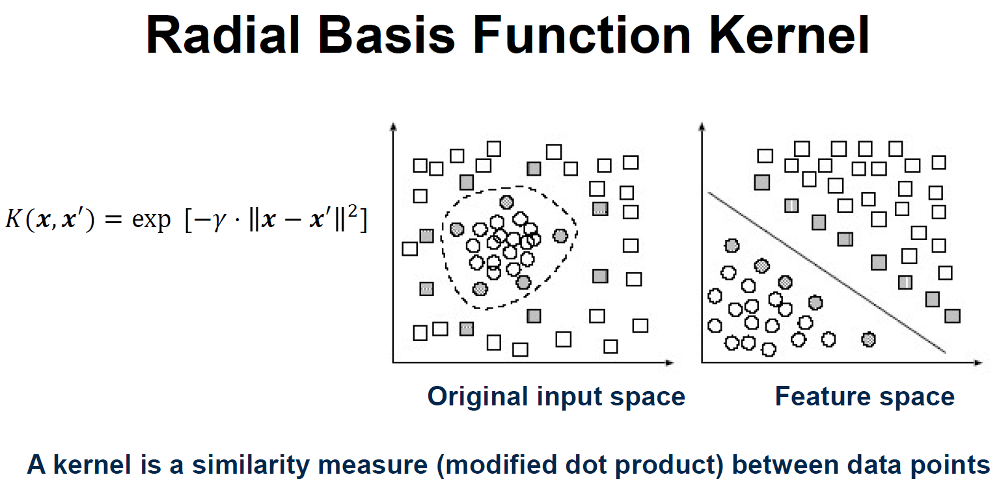

Now, one of the mathematically remarkable things about kernelized support vector machines, something referred to as the kernel trick, is that internally, the algorithm doesn't have to perform this actual transformation on the data points to the new high dimensional feature space.

Instead, the kernelized SVM can compute these more complex decision boundaries just in terms of similarity calculations between pairs of points in the high dimensional space where the transformed feature representation is implicit. This similarity function which mathematically is a kind of dot product is the kernel in kernelized SVM. And for certain kinds of high dimensional spaces, the similarity calculation between points, the kernel function can have a simple form like we see with the radial basis function calculation. This makes it practical to apply support vector machines, when the underlying transformed feature space is complex or even infinite dimensional. Even better, we could easily plug in a variety of different kernels choosing one to suit the properties of our data. Again, different choices of kernel correspond to different types of transformations to that higher dimensional feature space.

Here's the result of using a support vector machine with RBF kernel, on that more complex binary classification problem we saw earlier. You can see that unlike a linear classifier, the SVM with RBF kernel finds a more complex and very effective set of decision boundaries that are very good at separating one class from the other.

Note that the SVM classifier is still using a maximum margin principle to find these decision boundaries. But because of the non-linear transformation of the data, these boundaries may no longer always be equally distant from the margin edge points in the original input space.

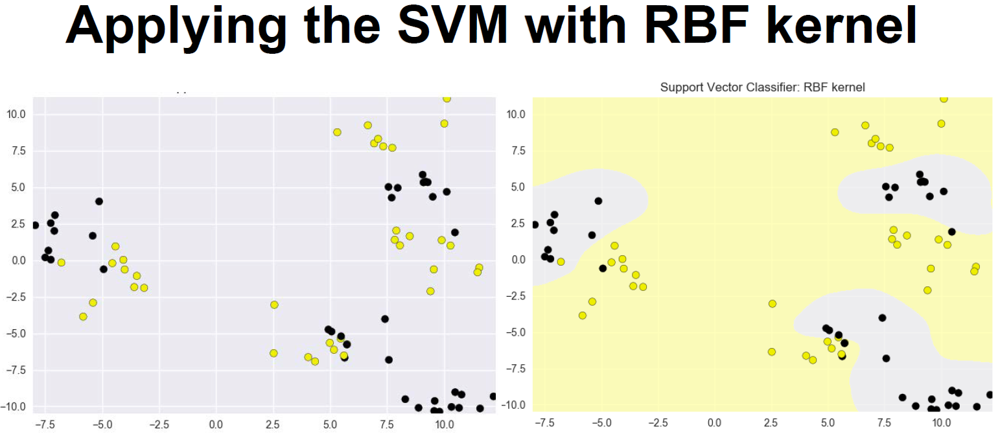

### Classification

Now let's look at an example of how we did this using scikit-learn in Python. To use SVMs, we simply import the SVC class from sklearn.svm and use it just as we would in the other classifier. For example, by calling the fit method with the training data to train the model. There is an SVC parameter called kernel, that allows us to set the kernel function used by the SVM. By default, the SVM will use the radial basis function, but a number of other choices are supported.

Here in the second example and plot, we show the use of the polynomial kernel instead of the RBF kernel. The polynomial kernel, using the kernel poly setting, essentially represents a feature transformation similar to the earlier quadratic example. In the lecture, this feature space represented in terms of features that are polynomial combinations of the original input features, much as we saw also for linear regression. The polynomial kernel takes additional parameter degree that controls the model complexity and the computational cost of this transformation.

<IPython.core.display.Javascript object>


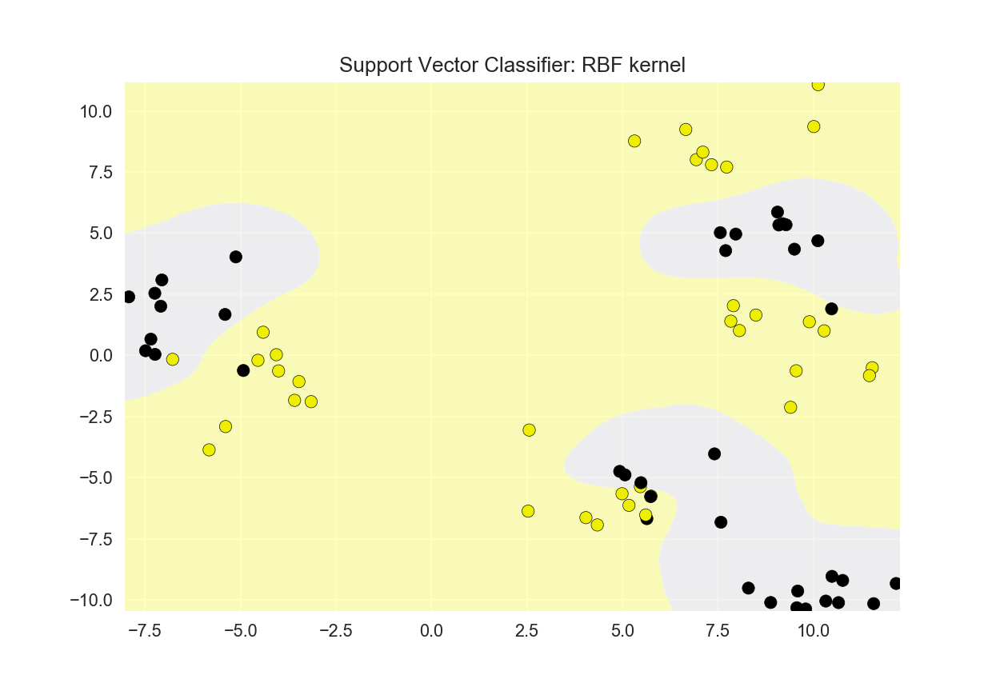

<IPython.core.display.Javascript object>


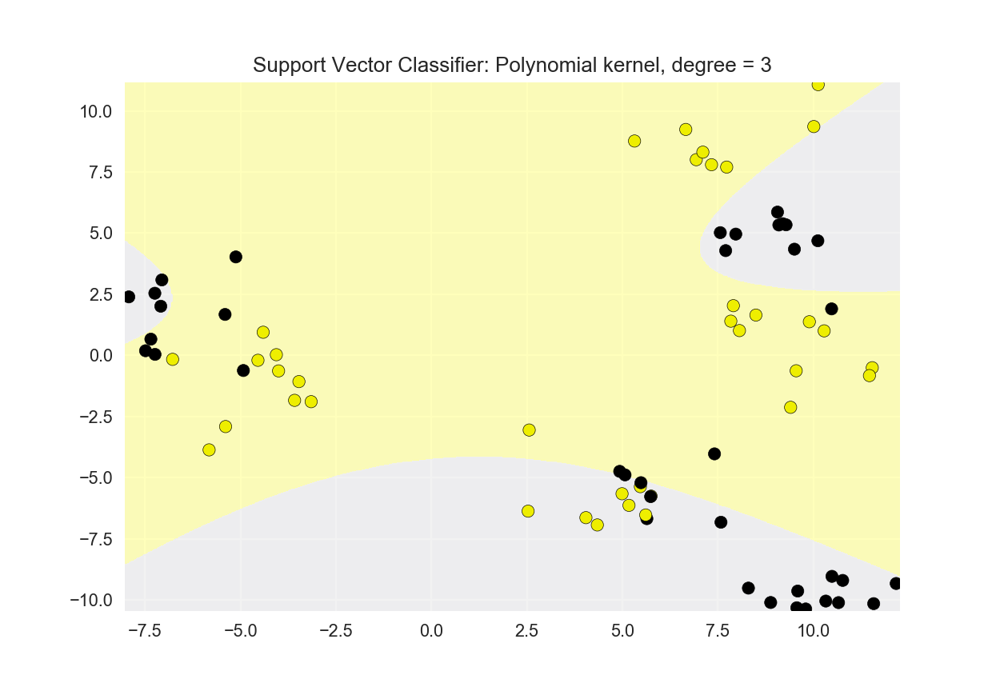

In [63]:
from sklearn.svm import SVC
from adspy_shared_utilities import plot_class_regions_for_classifier

X_train, X_test, y_train, y_test = train_test_split(X_D2, y_D2, random_state = 0)

# The default SVC kernel is radial basis function (RBF)
plot_class_regions_for_classifier(SVC().fit(X_train, y_train),
                                 X_train, y_train, None, None,
                                 'Support Vector Classifier: RBF kernel')

# Compare decision boundries with polynomial kernel, degree = 3
plot_class_regions_for_classifier(SVC(kernel = 'poly', degree = 3)
                                 .fit(X_train, y_train), X_train,
                                 y_train, None, None,
                                 'Support Vector Classifier: Polynomial kernel, degree = 3')

#### Support Vector Machine with RBF kernel: gamma parameter

You may have noticed that the RBF kernel has a parameter gamma. Gamma controls how far the influence of a single trending example reaches, which in turn affects how tightly the decision boundaries end up surrounding points in the input space. Small gamma means a larger similarity radius so that points farther apart are considered similar which results in more points being grouped together and smoother decision boundaries. On the other hand for larger values of gamma, the kernel value decays more quickly and points have to be very close to be considered similar. This results in more complex, tightly constrained decision boundaries. 

You can see the effect of increasing gamma that is sharpening the kernel in this example from the notebook. Small values of gamma give broader, smoother decision regions. While larger values of gamma give smaller, more complex decision regions.

You can set the gamma parameter when creating the SVC object to control the kernel width in this way, as shown in this code.

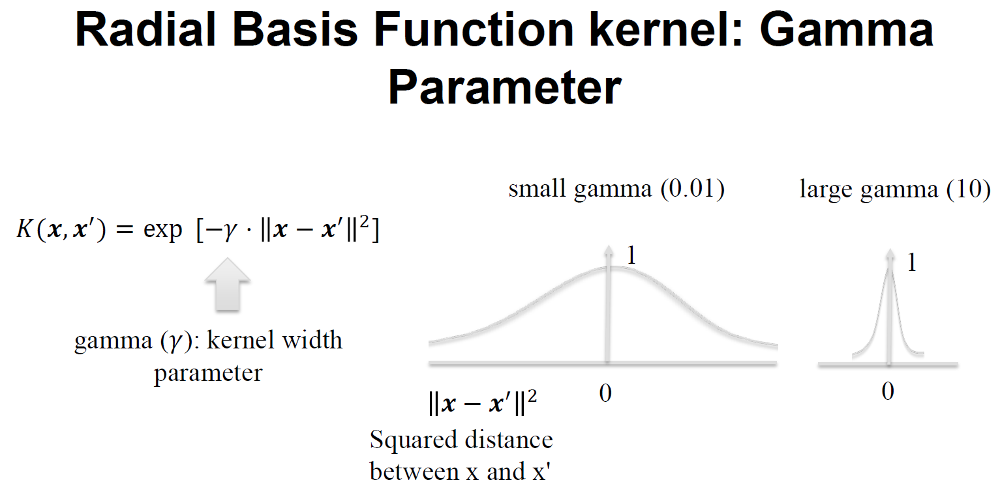

C:\Users\redex\Anaconda3\lib\site-packages\matplotlib\pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


<IPython.core.display.Javascript object>


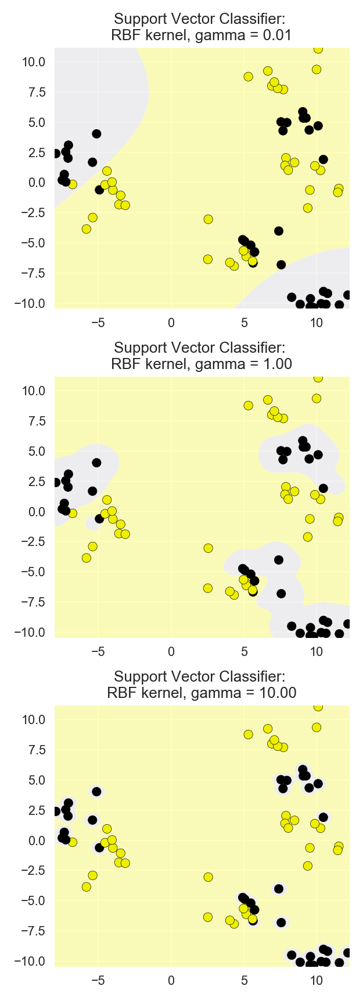

In [87]:
from adspy_shared_utilities import plot_class_regions_for_classifier_subplot

X_train, X_test, y_train, y_test = train_test_split(X_D2, y_D2, random_state = 0)
fig, subaxes = plt.subplots(3, 1, figsize=(4, 11))

for this_gamma, subplot in zip([0.01, 1.0, 10.0], subaxes):
    clf = SVC(kernel = 'rbf', gamma=this_gamma).fit(X_train, y_train)
    title = 'Support Vector Classifier: \nRBF kernel, gamma = {:.2f}'.format(this_gamma)
    plot_class_regions_for_classifier_subplot(clf, X_train, y_train,
                                             None, None, title, subplot)
    plt.tight_layout()

#### Support Vector Machine with RBF kernel: using both C and gamma parameter 

You may recall from linear SVMs that SVMs also have a regularization parameter, C, that controls the tradeoff between satisfying the maximum margin criterion to find the simple decision boundary, and avoiding misclassification errors on the training set. The C parameter is also an important one for kernelized SVMs, and it interacts with the gamma parameter.

This example from the notebook shows the effect of varying C and gamma together. If gamma is large, then C will have little to no effect. If gamma is small, the model is much more constrained and the effect of C will be similar to how it would affect a linear classifier.

Typically, gamma and C are tuned together, with the optimal combination typically in an intermediate range of values. For example, gamma between 0.0001 and 10 and C between 0.1 and 100. Though the specifical optimal values will depend on your application. Kernelized SVMs are pretty sensitive to settings of gamma. 

The most important thing to remember when applying SVMs is that it's important to normalize the input data, so that all the features have comparable units that are on the same scale. We saw this earlier with some other learning methods like regularized regression.

<IPython.core.display.Javascript object>


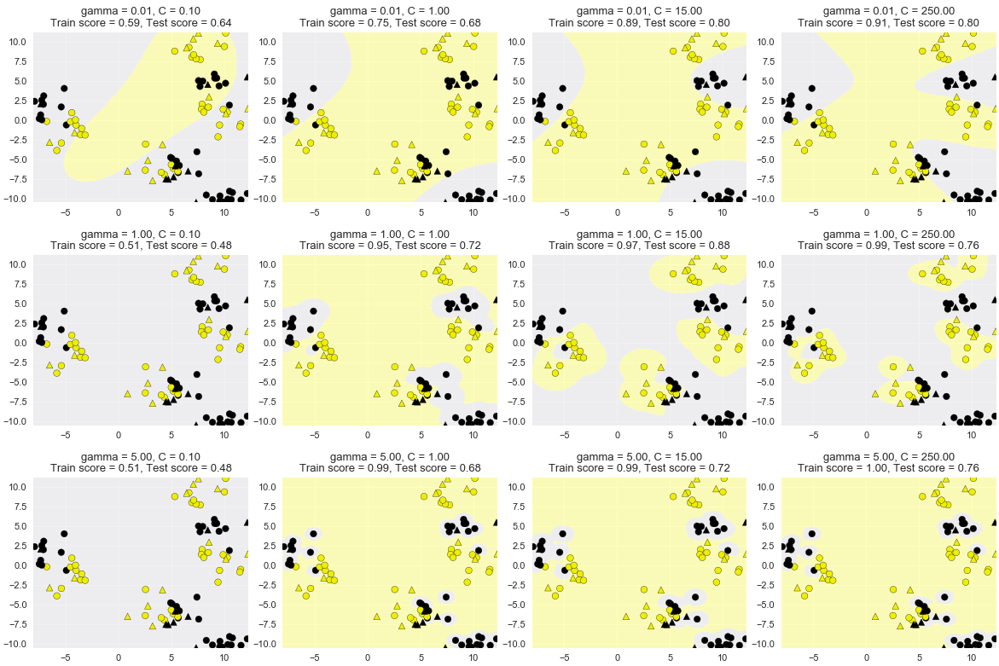

In [65]:
from sklearn.svm import SVC
from adspy_shared_utilities import plot_class_regions_for_classifier_subplot

from sklearn.model_selection import train_test_split


X_train, X_test, y_train, y_test = train_test_split(X_D2, y_D2, random_state = 0)
fig, subaxes = plt.subplots(3, 4, figsize=(15, 10), dpi=50)

for this_gamma, this_axis in zip([0.01, 1, 5], subaxes):
    
    for this_C, subplot in zip([0.1, 1, 15, 250], this_axis):
        title = 'gamma = {:.2f}, C = {:.2f}'.format(this_gamma, this_C)
        clf = SVC(kernel = 'rbf', gamma = this_gamma,
                 C = this_C).fit(X_train, y_train)
        plot_class_regions_for_classifier_subplot(clf, X_train, y_train,
                                                 X_test, y_test, title,
                                                 subplot)
        plt.tight_layout(pad=0.4, w_pad=0.5, h_pad=1.0)

### Application of SVMs to a real dataset: unnormalized data

Let's apply a support vector machine with RBF kernel to a real world dataset to see why this normalization is important. Here, we'll apply a support vector machine with RBF kernel to the breast cancer dataset. Note that we're not touching the input data in anyway, we're simply passing in the raw values.

We can see the results with training set accuracy of 1.00 and the test set accuracy of 0.63 that show that the support vector machine is over fitting. It's doing well on the training data, but very poorly on the test data.

Now let's add a MinMaxScaler transformation of the training data. Remembering to also apply the same scaler to the test data. After this scaler has been applied, all the input features now lie in the same range 0 to 1. And looking at these new results, the tests set accuracy is much, much higher, 96%. This illustrates what a huge difference normalizing the features of the training data can have on SVM performance.

In [66]:
from sklearn.svm import SVC
X_train, X_test, y_train, y_test = train_test_split(X_cancer, y_cancer,
                                                   random_state = 0)

clf = SVC(C=10).fit(X_train, y_train)
print('Breast cancer dataset (unnormalized features)')
print('Accuracy of RBF-kernel SVC on training set: {:.2f}'
     .format(clf.score(X_train, y_train)))
print('Accuracy of RBF-kernel SVC on test set: {:.2f}'
     .format(clf.score(X_test, y_test)))

Breast cancer dataset (unnormalized features)
Accuracy of RBF-kernel SVC on training set: 1.00
Accuracy of RBF-kernel SVC on test set: 0.63


### Application of SVMs to a real dataset: normalized data with feature preprocessing using minmax scaling

In [67]:
from sklearn.preprocessing import MinMaxScaler
scaler = MinMaxScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

clf = SVC(C=10).fit(X_train_scaled, y_train)
print('Breast cancer dataset (normalized with MinMax scaling)')
print('RBF-kernel SVC (with MinMax scaling) training set accuracy: {:.2f}'
     .format(clf.score(X_train_scaled, y_train)))
print('RBF-kernel SVC (with MinMax scaling) test set accuracy: {:.2f}'
     .format(clf.score(X_test_scaled, y_test)))

Breast cancer dataset (normalized with MinMax scaling)
RBF-kernel SVC (with MinMax scaling) training set accuracy: 0.98
RBF-kernel SVC (with MinMax scaling) test set accuracy: 0.96


Let's review the strengths and weaknesses of support vector machines.

On the positive side, support vector machines perform well on a range of datasets, and have been successfully applied on data that ranges from text to images and many more types. The support vector machine's also potentially very versatile, due to its ability to specify different kernel functions, including possible custom kernel functions depending on the data.

Support vector machines also typically work well for both low and high-dimensional data. Including data with hundreds, thousands or even millions of sparse dimensions. This makes it well suited to test classification for example.

On the negative side as the training set size increases, the run time, speed, and memory usage in the SVM training phase also increases. So for a large datasets with hundreds of thousands, or millions of instances, an SVM may become less practical.

As we saw when applying a support vector machine to a real world dataset, using an SVM requires careful normalization of the input data as well as parameter tuning. The input should be normalized that all features have comparable units and around similar scales if they aren't already.

Support vector machines also don't provide direct probability estimates for predictions, which are needed for some applications. Now, there are ways to estimate these probabilities using techniques such as plot scaling, which transforms the output of the classifier to a probability distribution over classes by fitting a logistic regression model to the classifiers course. 

Finally, it could be difficult to interpret the internal model parameters of a support vector machine. Which means the applicability of support vector machines in scenarios where interpretation is important for people may be limited when we want to understand why a particular prediction was made.

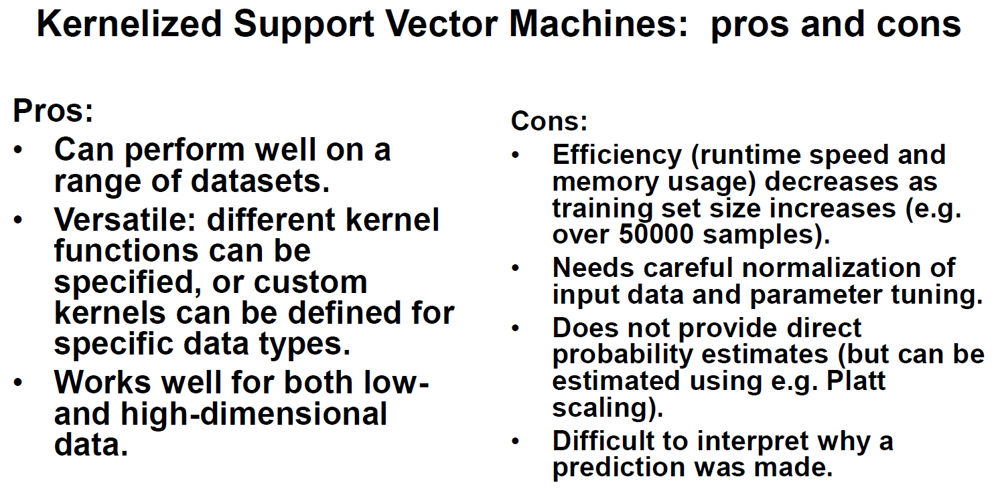

As a reminder, there are three main parameters that control model complexity for kernelized SVMs.

First, there's the kernel type which defaults to RBF for radial basis function. But several other common types are available in scikit-learns SVC module.

Second, each kernel has one or more kernel specific parameters that control aspects like the influence of training points according to their distance. In the case of the RBF kernel, SVM performance is very sensitive to the setting of the gamma parameter that controls the kernel width.

Finally, for any support vector machine, the C: regularization parameter operates as we've discussed before. And it's typically tuned with the kernel parameters such as gamma for optimal performance.

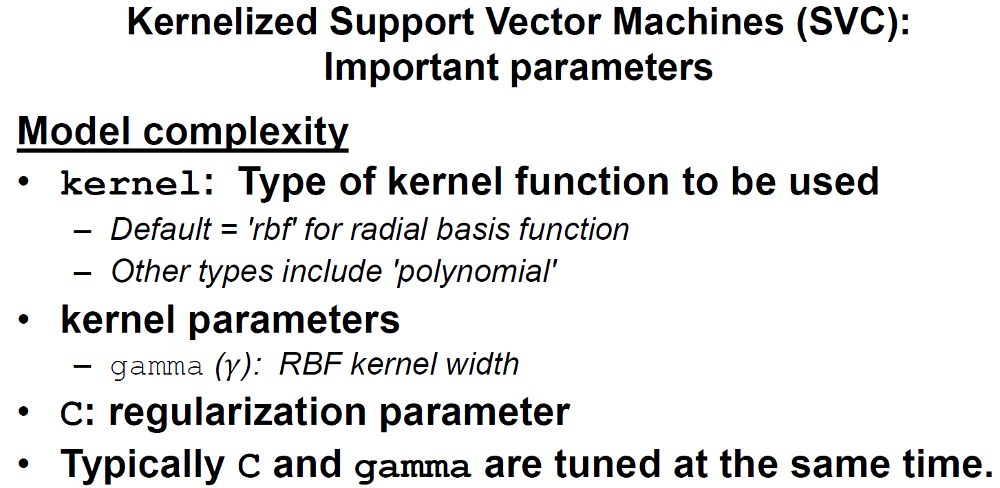

## Cross-validation

So far we've seen a number of supervised learning methods, and when applying you to these methods we followed a consistent series of steps. First, partitioning the data set into training and test sets using the Train/Test split function. Then, calling the Fit Method on the training set to estimate the model. And finally, applying the model by using the Predict Method to estimate a target value for the new data instances, or by using the Score Method to evaluate the trained model's performance on the test set. Let's remember that the reason we divided the original data into training and test sets was to use the test set as a way to estimate how well the model trained on the training data would generalize to new previously unseen data. The test set represented data that had not been seen during training but had the same general attributes as the original data set, or in more technical language, which was drawn from the same underlying distribution as the training set. Cross-validation is a method that goes beyond evaluating a single model using a single Train/Test split of the data by using multiple Train/Test splits, each of which is used to train and evaluate a separate model. So why is this better than our original method of a single Train/Test split? Well, you may have noticed for example by choosing different values for the random state seed parameter in the Train/Test split function, when you're working on some examples or assignments, that the accuracy score you get from running a classifier can vary quite a bit just by chance depending on the specific samples that happen to end up in the training set. Cross-validation basically gives more stable and reliable estimates of how the classifiers likely to perform on average by running multiple different training test splits and then averaging the results, instead of relying entirely on a single particular training set. 

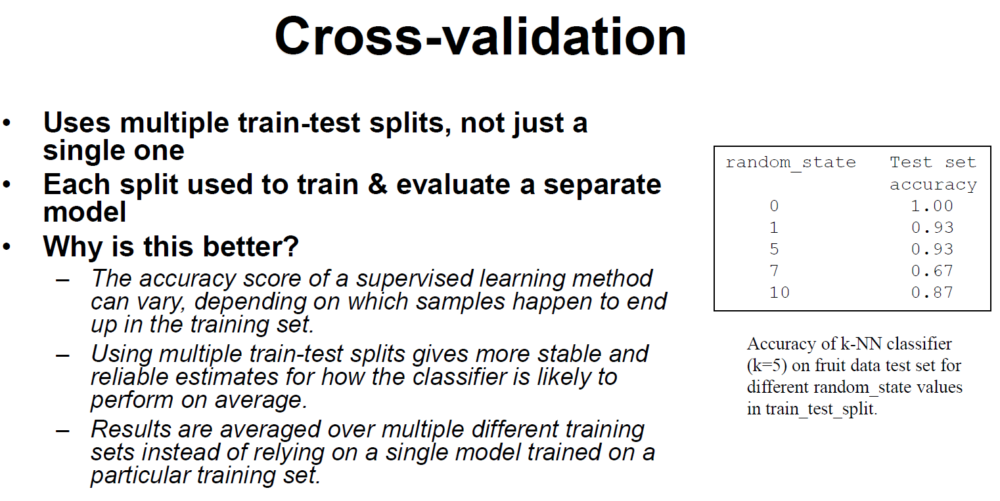

Here's a graphical illustration of how cross-validation operates on the data. The most common type of cross-validation is k-fold cross-validation most commonly with K set to 5 or 10. For example, to do five-fold cross-validation, the original dataset is partitioned into five parts of equal or close to equal size. Each of these parts is called a "fold". Then a series of five models is trained one per fold. The first model: Model 1, is trained using folds 2 through 5 as the training set and evaluated using fold 1 as the test set. The second model: Model 2, is trained using Folds 1, 3, 4, and 5 as the training set, and evaluated using Fold 2 as the test set, and so on. When this process is done, we have five accuracy values, one per fold. 

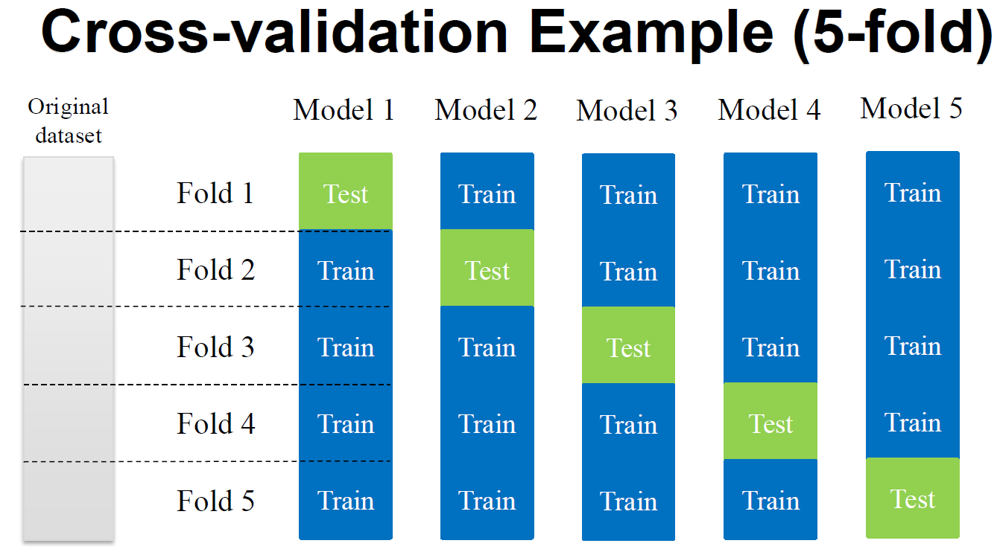

### Example based on k-NN classifier with fruit dataset (2 features)

In scikit-learn, you can use the cross_val_score function from the model selection module to do cross-validation. The parameters are: first, the model you want to evaluate, and then the data set, and then the corresponding ground truth target labels or values. By default, cross_val_score does 3-fold cross-validation. So it returns 3 accuracy scores, one for each of the 3 folds. If you want to change the number of folds, you can set the CV parameter. For example, CV = 10 will perform 10-fold cross-validation. It's typical to then compute the mean of all the accuracy scores across the folds and report the mean cross-validation score as a measure of how accurate we can expect the model to be on average. 

One benefit of computing the accuracy of a model on multiple splits instead of a single split, is that it gives us potentially useful information about how sensitive the model is to the nature of the specific training set. We can look at the distribution of these multiple scores across all the cross-validation folds to see how likely it is that by chance, the model will perform very badly or very well on any new data set, so we can do a sort of worst case or best case performance estimate from these multiple scores. 

This extra information does come with extra cost. It does take more time and computation to do cross-validation. So for example, if we perform k-fold cross-validation and we don't compute the fold results in parallel, it'll take about k times as long to get the accuracy scores as it would with just one Train/Test split. However, the gain in our knowledge of how the model is likely to perform on future data is usually well worth this cost.

In [68]:
from sklearn.model_selection import cross_val_score

clf = KNeighborsClassifier(n_neighbors = 5)
X = X_fruits_2d.values
y = y_fruits_2d.values
cv_scores = cross_val_score(clf, X, y) # Default cv is 3 fold; keyword: cv=None

print('Cross-validation scores (3-fold):', cv_scores)
print('Mean cross-validation score (3-fold): {:.3f}'
     .format(np.mean(cv_scores)))

Cross-validation scores (3-fold): [0.77 0.74 0.83]
Mean cross-validation score (3-fold): 0.781


In the default cross-validation set up, to use for example 5 folds, the first 20% of the records are used as the first fold, the next 20% for the second fold, and so on. One problem with this is that the data might have been created in such a way that the records are sorted or at least show some bias in the ordering by class label. For example if you look at our fruit data set, it happens that all the labels for classes one and two, the apples, the mandarin and oranges come before classes three and four in the data file. So if we simply took the first 20% of records for Fold 1, which would be used as the test set to evaluate Model 1, it would evaluate the classifier only on class 1 and 2 examples and not at all on the other classes 3 and 4, which would greatly reduce the informativeness of the evaluation. 

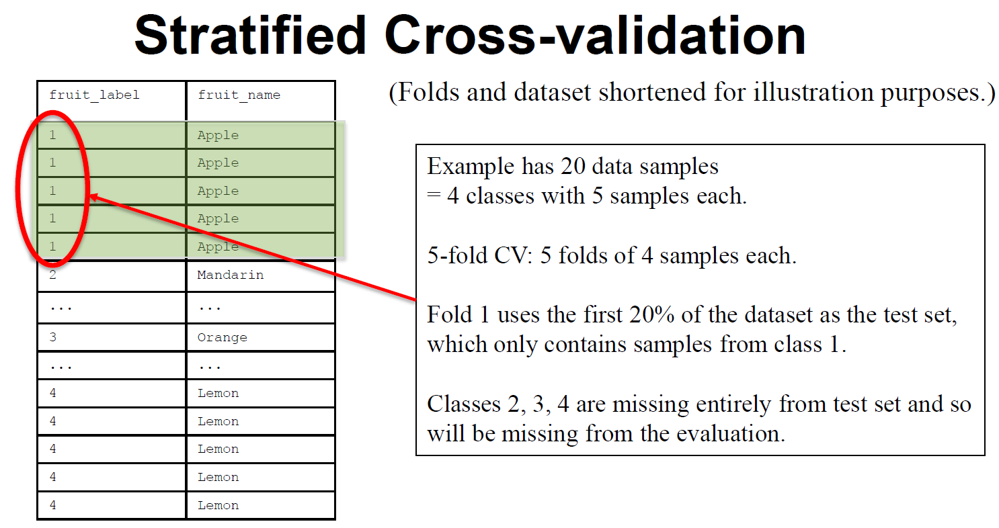

So when you ask scikit-learn to do cross-validation for a classification task, it actually does instead what's called "Stratified K-fold Cross-validation". The Stratified Cross-validation means that when splitting the data, the proportions of classes in each fold are made as close as possible to the actual proportions of the classes in the overall data set as shown here. 

For regression, scikit-learn uses regular k-fold cross-validation since the concept of preserving class proportions isn't something that's really relevant for everyday regression problems. 

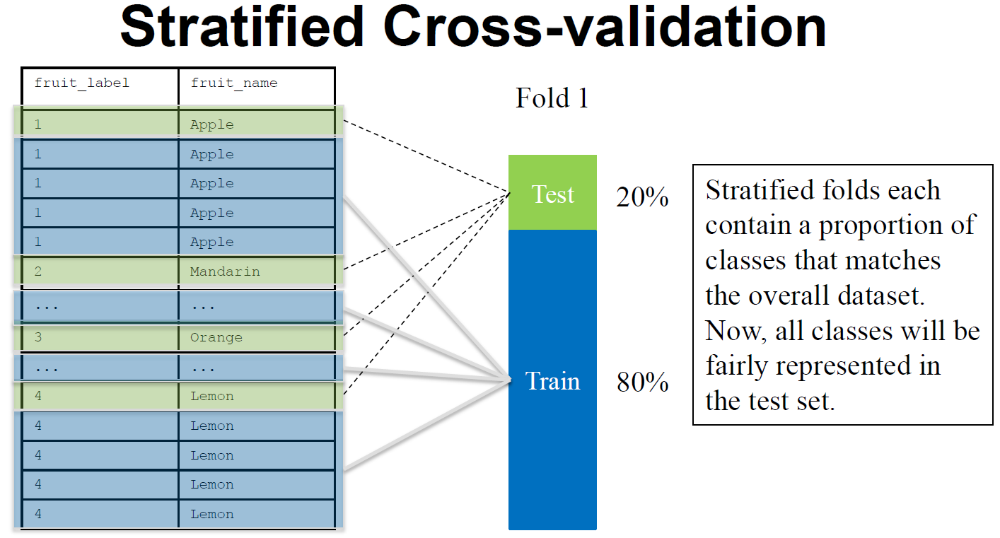

At one extreme we can do something called "Leave-one-out cross-validation", which is just k-fold cross-validation, with K sets to the number of data samples in the data set. In other words, each fold consists of a single sample as the test set and the rest of the data as the training set. Of course this uses even more computation, but for small data sets in particular, it can provide improved proved estimates because it gives the maximum possible amount of training data to a model, and that may help the performance of the model when the training sets are small. 

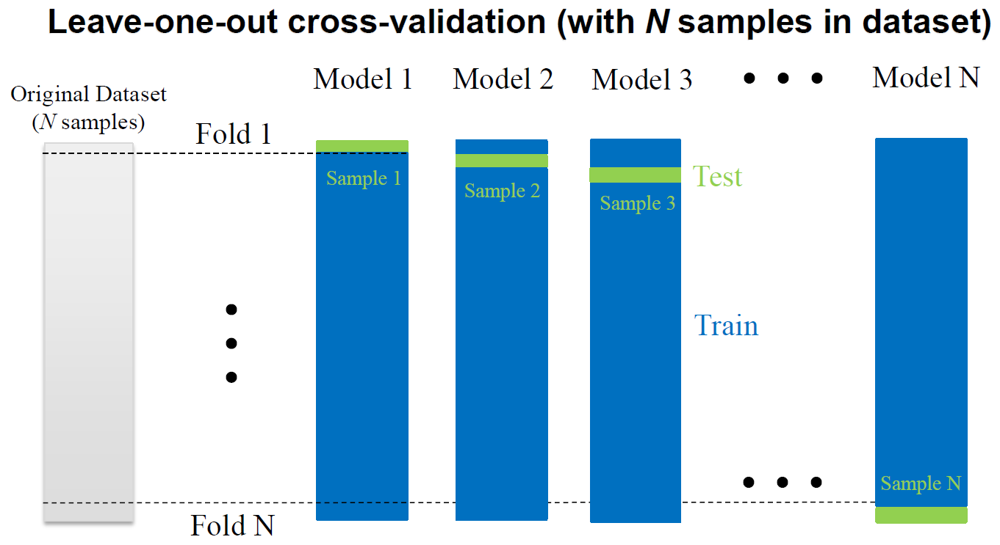

### A note on performing cross-validation for more advanced scenarios.

In some cases (e.g. when feature values have very different ranges), we've seen the need to scale or normalize the training and test sets before use with a classifier. The proper way to do cross-validation when you need to scale the data is *not* to scale the entire dataset with a single transform, since this will indirectly leak information into the training data about the whole dataset, including the test data (see the lecture on data leakage later in the course).  Instead, scaling/normalizing must be computed and applied for each cross-validation fold separately.  To do this, the easiest way in scikit-learn is to use *pipelines*.  While these are beyond the scope of this course, further information is available in the scikit-learn documentation here:

http://scikit-learn.org/stable/modules/generated/sklearn.pipeline.Pipeline.html

or the Pipeline section in the recommended textbook: Introduction to Machine Learning with Python by Andreas C. Müller and Sarah Guido (O'Reilly Media).

## Validation curve example

Sometimes we want to evaluate the effect that an important parameter of a model has on the cross-validation scores. The useful function validation curve makes it easy to run this type of experiment. Like cross-value score, validation curve will do threefold cross-validation by default but you can adjust this with the CV parameter as well. Unlike cross_val_score, you can also specify a classifier, parameter name, and set of parameter values, you want to sweep across. So you first pass in the estimator object, or that is the classifier or regression object to use, followed by the data set samples X and target values Y, the name of the parameter to sweep, and the array of parameter values that that parameter should take on in doing the sweep. Validation curve will return two two-dimensional arrays corresponding to evaluation on the training set and the test set. Each array has one row per parameter value in the sweep, and the number of columns is the number of cross-validation folds that are used. For example, the code shown here will fit three models using a radio basis functions support vector machine on different subsets of the data corresponding to the three different specified values of the kernels gamma parameter. That returns two four-by-three arrays. That is four levels of gamma, times 3 fits per level containing scores for the training and test sets.

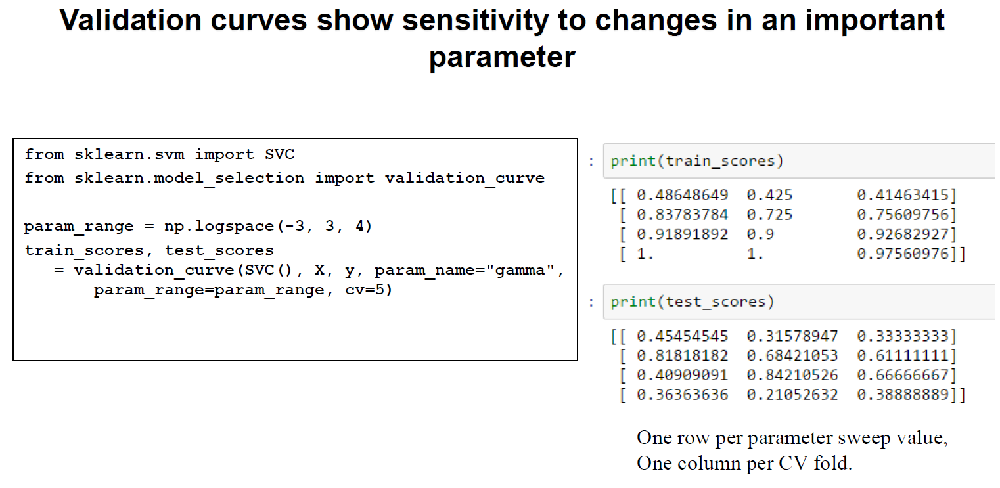

In [69]:
from sklearn.svm import SVC
from sklearn.model_selection import validation_curve

param_range = np.logspace(-3, 3, 4)
train_scores, test_scores = validation_curve(SVC(), X, y,
                                            param_name='gamma',
                                            param_range=param_range, cv=5)

In [70]:
print(train_scores)

[[0.48 0.4  0.4  0.4  0.41]
 [0.83 0.79 0.77 0.77 0.73]
 [0.87 0.89 0.89 0.87 0.86]
 [0.98 1.   0.98 1.   0.98]]


In [71]:
print(test_scores)

[[0.54 0.33 0.33 0.33 0.3 ]
 [0.85 0.67 0.67 0.67 0.8 ]
 [0.46 0.67 0.83 0.83 0.7 ]
 [0.31 0.33 0.25 0.33 0.3 ]]


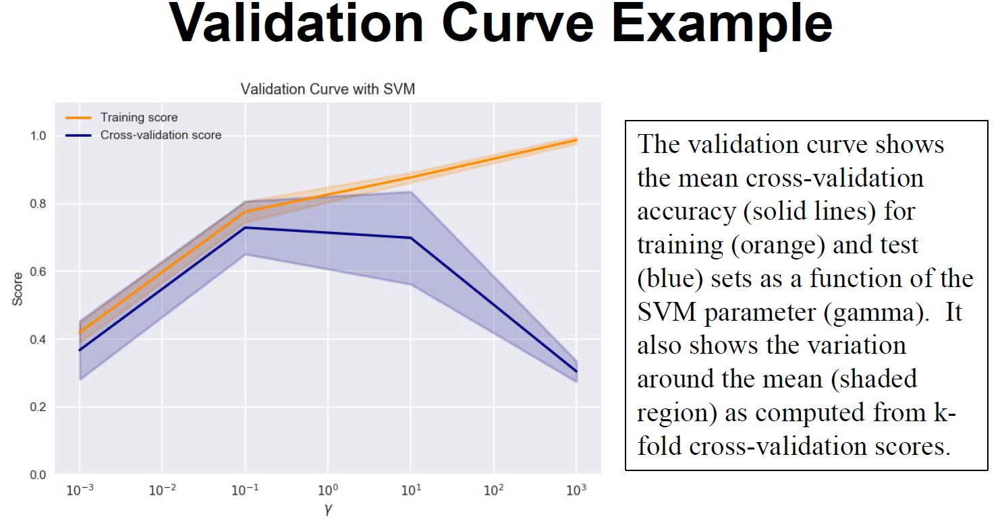

C:\Users\redex\Anaconda3\lib\site-packages\matplotlib\pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


<IPython.core.display.Javascript object>


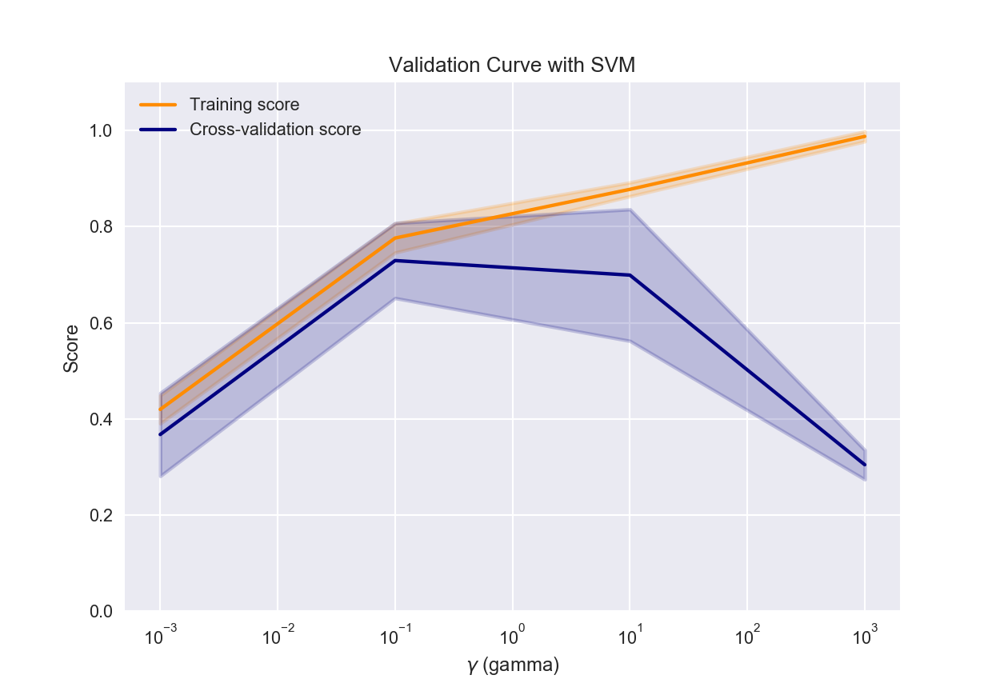

In [72]:
# This code based on scikit-learn validation_plot example
#  See:  http://scikit-learn.org/stable/auto_examples/model_selection/plot_validation_curve.html
plt.figure()

train_scores_mean = np.mean(train_scores, axis=1)
train_scores_std = np.std(train_scores, axis=1)
test_scores_mean = np.mean(test_scores, axis=1)
test_scores_std = np.std(test_scores, axis=1)

plt.title('Validation Curve with SVM')
plt.xlabel('$\gamma$ (gamma)')
plt.ylabel('Score')
plt.ylim(0.0, 1.1)
lw = 2

plt.semilogx(param_range, train_scores_mean, label='Training score',
            color='darkorange', lw=lw)

plt.fill_between(param_range, train_scores_mean - train_scores_std,
                train_scores_mean + train_scores_std, alpha=0.2,
                color='darkorange', lw=lw)

plt.semilogx(param_range, test_scores_mean, label='Cross-validation score',
            color='navy', lw=lw)

plt.fill_between(param_range, test_scores_mean - test_scores_std,
                test_scores_mean + test_scores_std, alpha=0.2,
                color='navy', lw=lw)

plt.legend(loc='best')
plt.show()

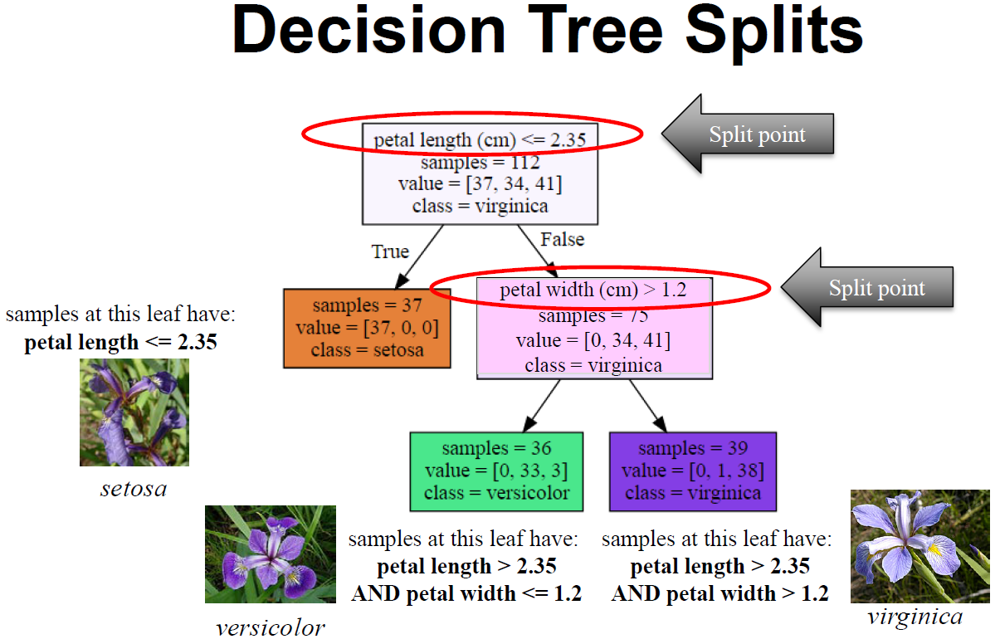

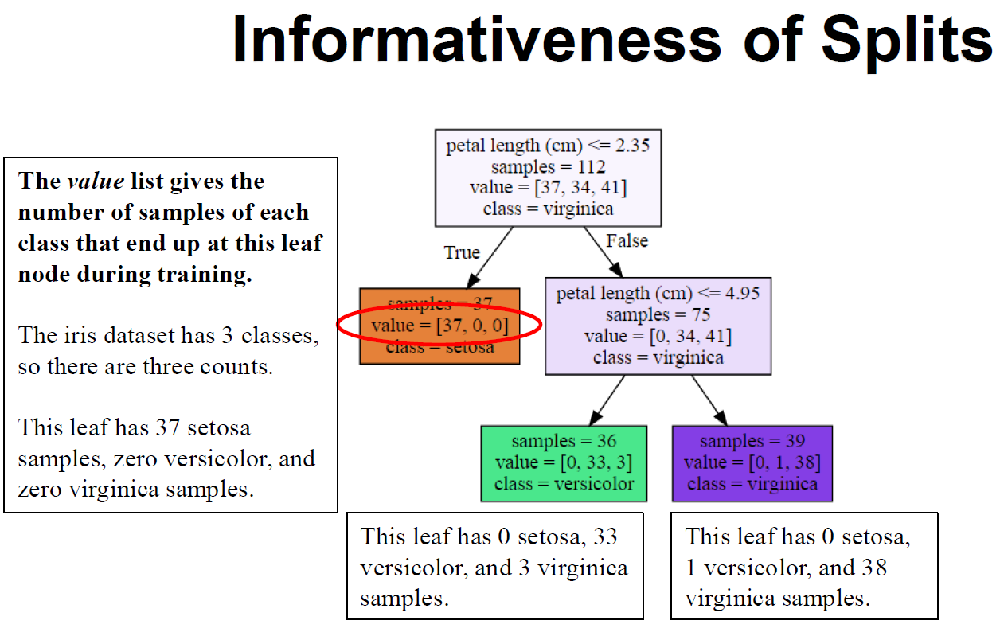

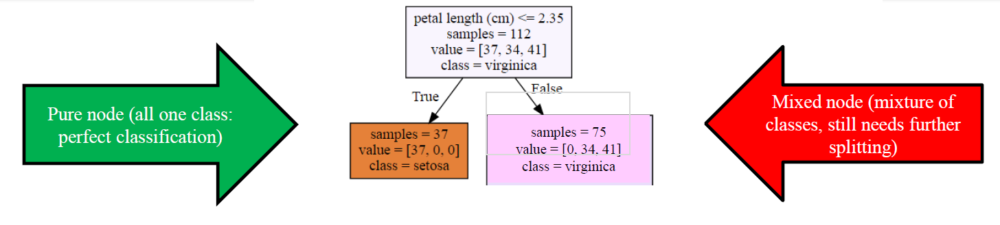

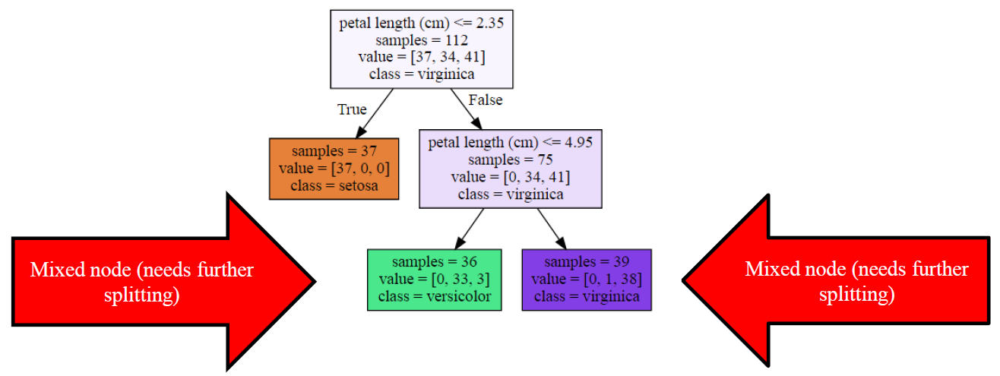

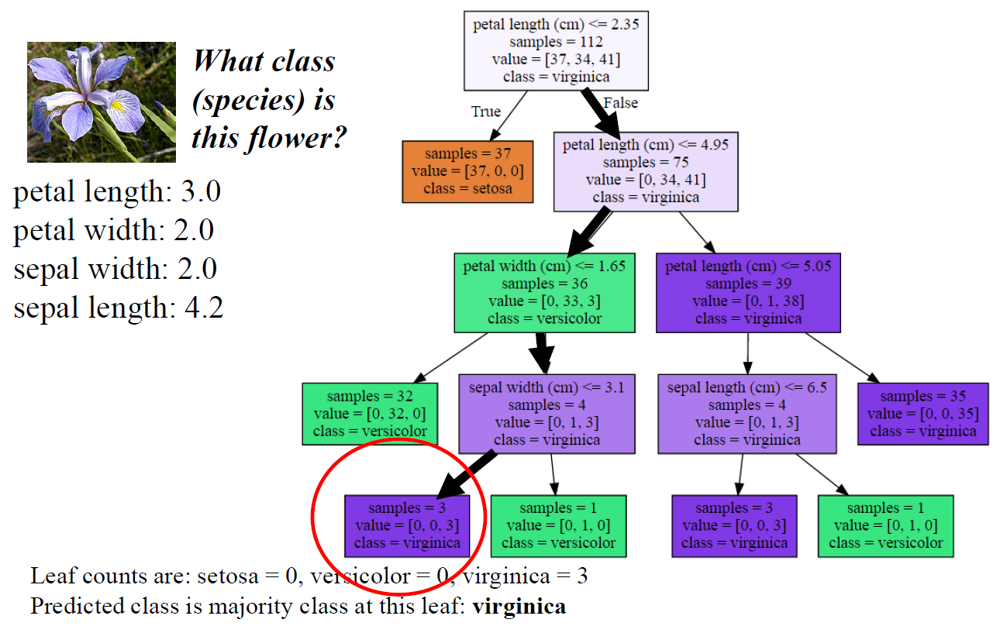

## Decision Trees

Decision trees are a popular supervised learning method that like many other learning methods we've seen, can be used for both regression and classification. Decision trees are easy to use and understand and are often a good exploratory method if you're interested in getting a better idea about what the influential features are in your dataset. Basically, decision trees learn a series of explicit if-then rules on feature values that result in a decision that predicts the target value. Here's a simple example. Suppose we're playing a game where one person is thinking of one of several possible objects so let's say, an automobile, a bus, an airplane, a bird, an elephant and a dog. A second person has to guess the identity of that thing by asking as few yes or no questions as possible up to a limit of no more than say, 10 questions. Suppose the first person secretly thinks of an automobile. So one of the first questions the second person might ask is, "Is it alive?" Intuitively, we know that this type of broad question is much more informative and helps eliminate a larger set of possibilities early on, compared to asking a more specific question right away like, "does it have orange fur with black stripes?" The more specific questions might be useful later once we've narrowed the class of things down to particular animals or vehicles, for example. If we think of the property of being alive as a binary feature of an object and the property of having orange fur with black stripes as another feature, we can say that the "is alive" feature is more informative at an early stage of guessing and thus would appear higher in our tree of questions. When the answer to the first question comes back as "No, it's not alive". A second question might be, "Does it fly?. When that answer comes back, no. We can continue to narrow down the set of possible answers by asking more and more specific questions such as, "Can it carry more than 10 people?". In this way any given object can be categorized as either matching the target object the first person is thinking of or not, according to its features as determined by asking the series of yes or no questions.

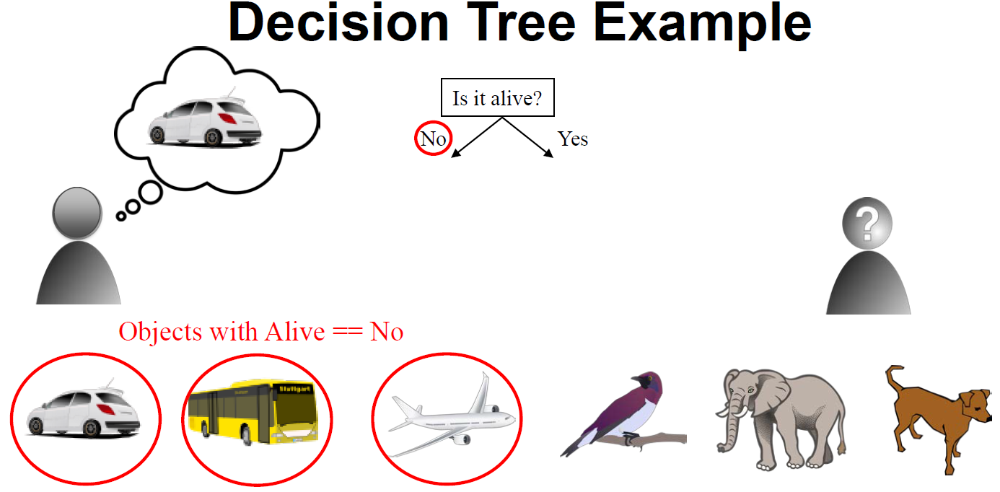

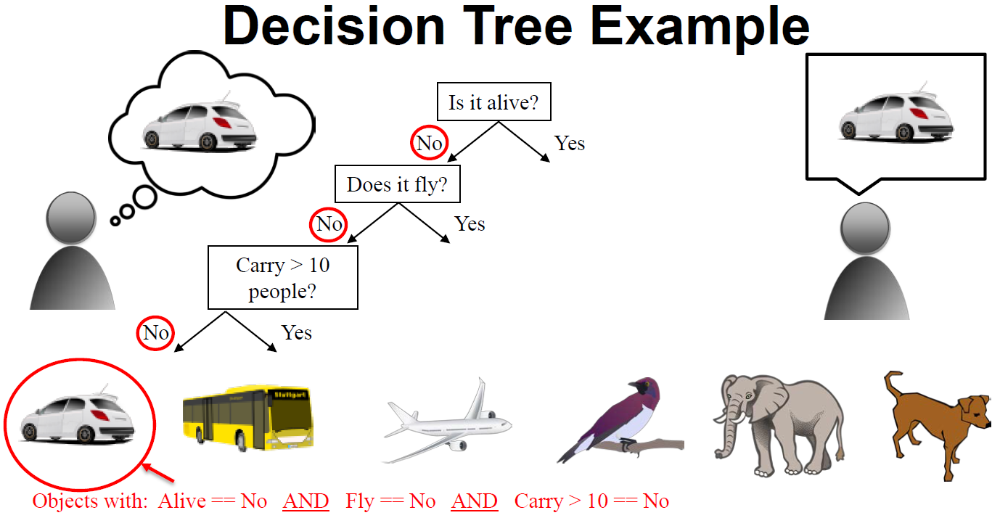

We can form these questions into a tree with a node representing one question and the yes or no possible answers as the left and right branches from that node that connect the node to the next level of the tree. One question being answered at each level. At the bottom of the tree are nodes called leaf nodes that represent actual objects as the possible answers. For any object there's a path from the root of the tree to that object that is determined by the answers to the specific yes or no questions at each level. For example a dog is alive cannot fly and doesn't have a trunk. You can view this as a kind of simple decision tree for predicting the class of an object. 

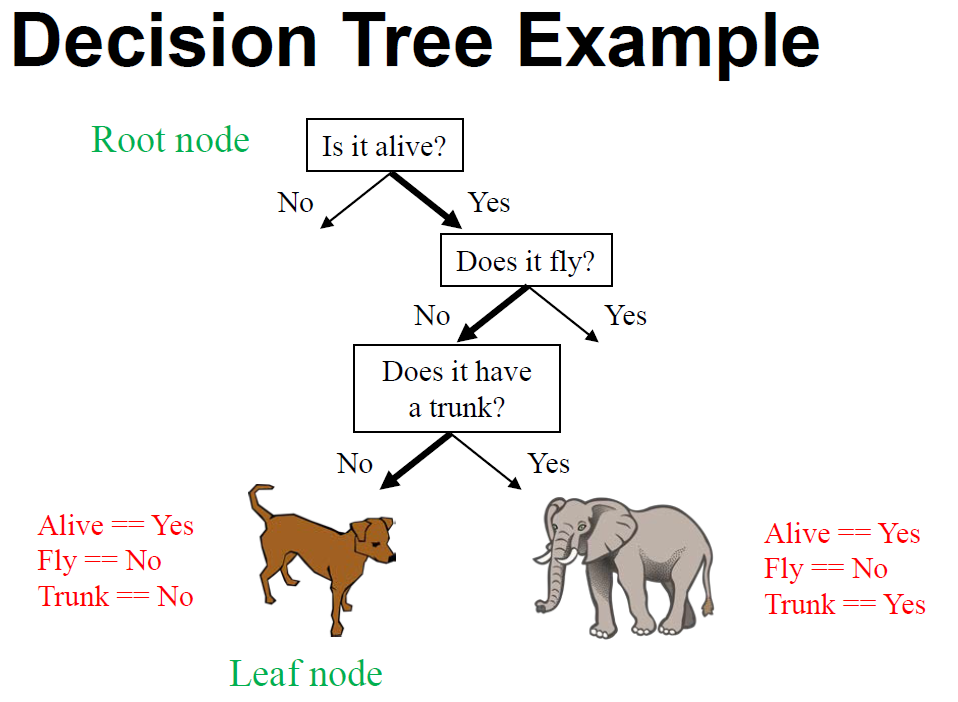

We can generalize this idea of finding a set of rules that can learn to categorize an object into the correct category to many other classification tasks. For example, we're going to look at a classification task next that involves finding rules that can predict what species a particular flower is, based on measurements of certain parts of the flower. Rather than try to figure out these rules manually for every task, there are supervised algorithms that can learn them for us in a way that gets to an accurate decision quickly, which we'll look at now. 

Let's start by looking at a famous dataset in machine learning called the iris dataset. This dataset is included with scikit-learn in the datasets module. Each instance in the dataset represents one of three different species of Iris, a type of flower. There are four attributes or features for each instance, that represent measurements of different parts of the flower. The sepal length in centimeters, the sepal width in centimeters, petal length in centimeters and petal width in centimeters. The three species are called setosa, versicolor, and virginica. 

The data set has measurements for 150 flowers with 50 examples of each species. The classification task is to predict which of the three species and instances given these measurements. Unlike our simple example involving yes or no questions which were binary features of the object, the iris data set features are continuous values. So the rules to be learned will be of the form for example, "Is Petal length greater than 2.3 centimeters?". 

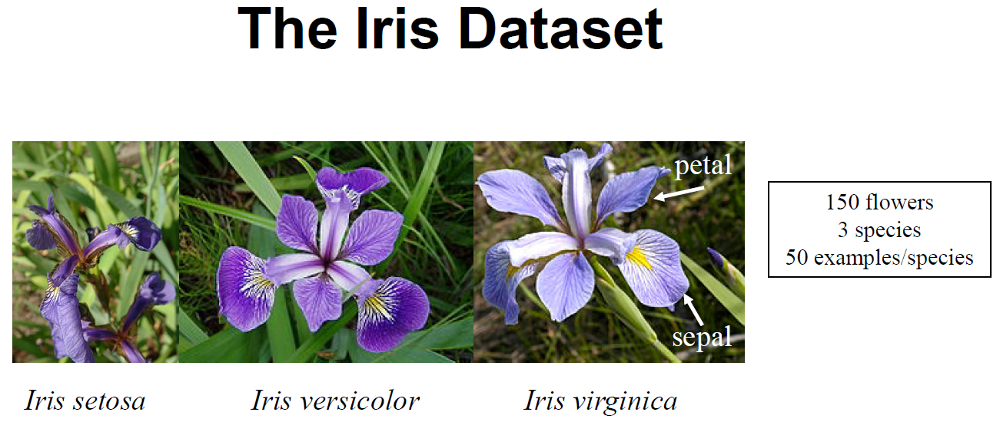

Let's take a look at how a decision tree is built on this data. The goal when building a decision tree is to find the sequence of questions that has the best accuracy at classifying the data in the fewest steps. Looking at a decision tree, each decision splits the data into two branches based on some feature value being above or below a threshold. For example, whether the petal width is greater than one point two centimeters might be an example of a splitting rule that threshold is called a split point.

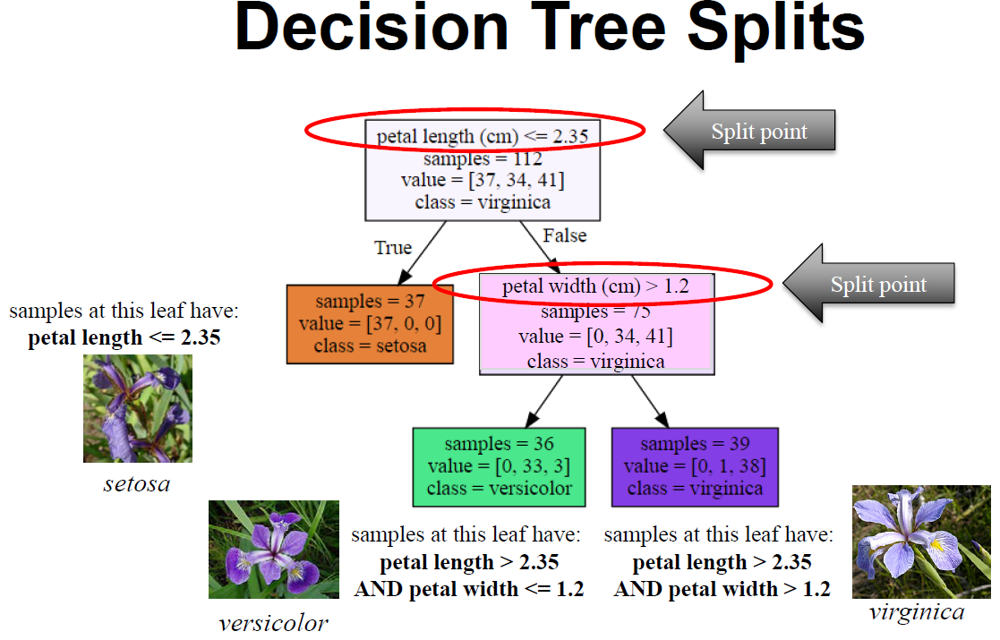

An important concept is how informative a split of the data is. So intuitively an informative split of the data is one that does an excellent job at separating one class from the others. An example of an informative split might be to put all instances of the flowers with petal length less than 2.35 centimeters into one bin and the rest in the other bin. This is an informative split because at least for this training set, using that rule separates the setosa class completely from the others and allows us to predict the setosa class perfectly just based on this one measurement. A less informative split, like a rule like sepal width less than or equal to three centimeters, would not produce as clear a separation of one class from the others. So for the best split, the results should produce as homogeneous a set of classes as possible. 

There are a number of mathematical ways to compute the best split. One criterion that's widely used for decision trees is called information gain, for example. 

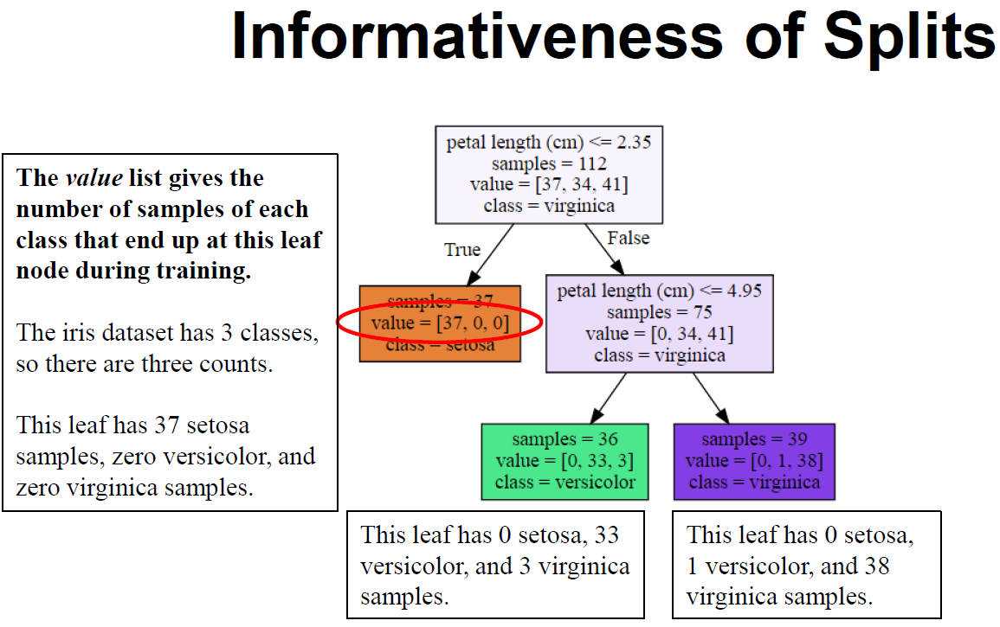

So to build the decision tree, the decision tree building algorithm starts by finding the feature that leads to the most informative split. For any given split of the data on a particular feature value, even for the best split it's likely that some examples will still be incorrectly classified or need further splitting. In the iris data set, if we look at all the flowers with petal length greater than 2.35 centimeters for example. Using that split leaves a pool of instances that are a combination of virginica and versicolor that still need to be distinguished further. 

So we can further improve the accuracy of the classification by continuing this process of finding the best split for the remaining subsets. With the iris dataset, we can further split into flowers that have petal length less than versus greater than 4.95 centimeters for example. This second split is informative because the resulting subsets are more homogeneous that is split did a good job at dividing virginica from versicolor based on the second split test. 

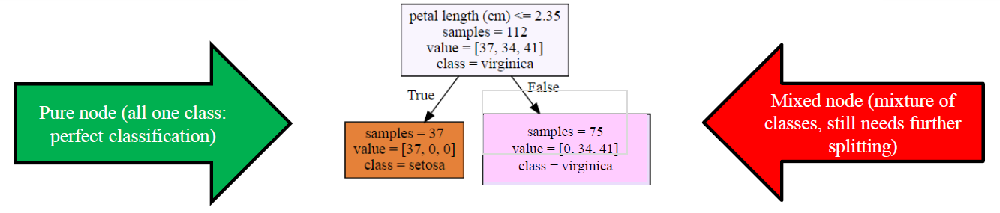

We can continue this process recursively until we're left with leaves in the decision tree that all have the same or at least a predominant majority of a target value. Trees whose leaf nodes each have all the same target value are called pure, as opposed to mixed where the leaf nodes are allowed to contain at least some mixture of the classes. 

To predict the class of a new instance given its feature measurements, using the decision tree we simply start at the root of the decision tree and take the decision at each level based on the appropriate feature measurement until we get to a leafnode. The prediction is then just the majority class of the instances in that leafnode. 

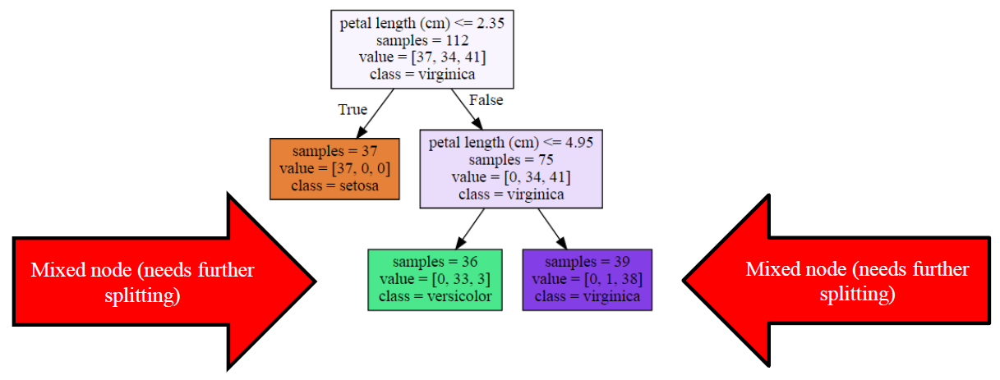

So for the iris data for example, a flower that has a petal length of 3 centimeters, a petal width of 2 centimeters and a sepal width of 2 centimeters would end up at this leafnode, whose instances are all of the virginica class. So the prediction would be virginica. 

Decision trees can also be used for regression using the same process of testing the future values at each node and predicting the target value based on the contents of the leafnode. For regression, the leafnode prediction would be the mean value of the target values for the training points in that leaf. 

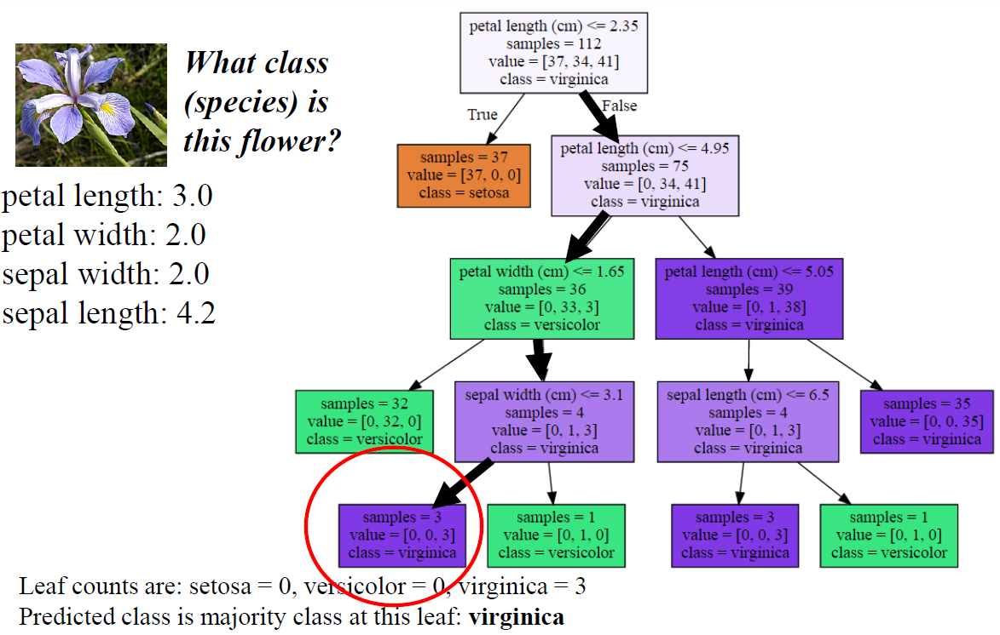

In scikit-learn, to build the decision tree you import the decision tree classifier class from the Sklearn tree module and fit it just as you would any classifier by creating the object and calling the fit method on the training data. This code first loads the iris data set and then computes the training and test accuracy in predicting the three classes. Notice that the training data here is predicted perfectly with an accuracy of 1.0 while the test data is a little bit worse. This is an indication that the tree is likely overfitting and in fact this is a problem with building decision trees in general that keep adding rules until the leafnodes are pure. Typically such trees are overly complex and essentially memorize the training data. So when building decision trees, we need to use some additional strategy to prevent this overfitting. 

In [73]:
from sklearn.datasets import load_iris
from sklearn.tree import DecisionTreeClassifier
from adspy_shared_utilities import plot_decision_tree
from sklearn.model_selection import train_test_split


iris = load_iris()

X_train, X_test, y_train, y_test = train_test_split(iris.data, iris.target, random_state = 3)
clf = DecisionTreeClassifier().fit(X_train, y_train)

print('Accuracy of Decision Tree classifier on training set: {:.2f}'
     .format(clf.score(X_train, y_train)))
print('Accuracy of Decision Tree classifier on test set: {:.2f}'
     .format(clf.score(X_test, y_test)))

Accuracy of Decision Tree classifier on training set: 1.00
Accuracy of Decision Tree classifier on test set: 0.97


One strategy to prevent overfitting is to prevent the tree from becoming really detailed and complex by stopping its growth early. This is called pre-pruning. Another strategy is to build a complete tree with pure leaves but then to prune back the tree into a simpler form. This is called post-pruning or sometimes just pruning. The decision tree implementation in scikit-learn only implements pre-pruning. We can control tree complexity via pruning by limiting either the maximum depth of the tree using the max depth parameter or the maximum number of leafnodes using the max leafnodes parameter. We could also set a threshold on the minimum number of instances that must be in a node to consider splitting it. And this would be using the min samples leaf parameter.

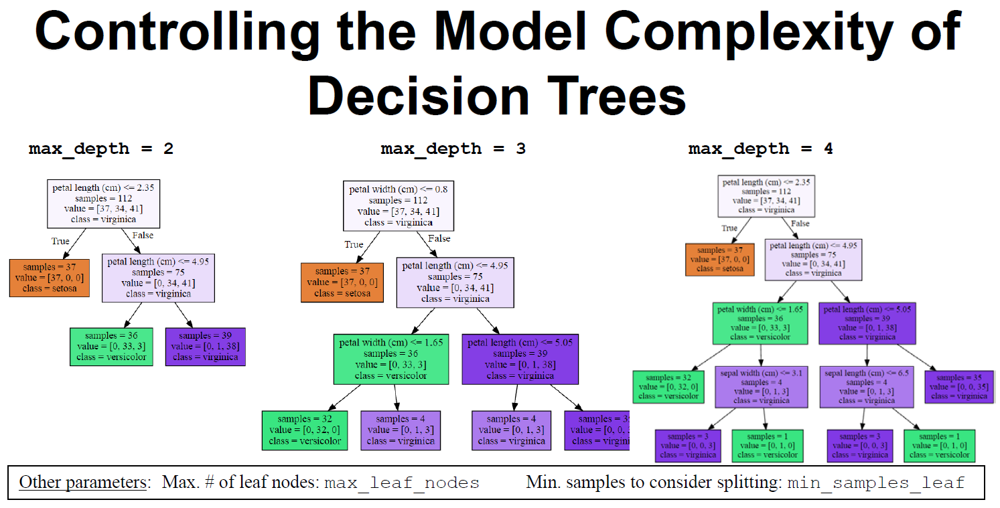

#### Setting max decision tree depth to help avoid overfitting

We can see the effect of pre-pruning by setting max depth to 3 on the iris dataset. Now the accuracy on the training data is slightly worse but the accuracy on the test data is slightly better. One great advantage of decision trees at least when they are not too big, is that they're easy to interpret. Visualizing the entire tree can show you exactly how did the decision tree is making its predictions. 

In [74]:
clf2 = DecisionTreeClassifier(max_depth = 3).fit(X_train, y_train)

print('Accuracy of Decision Tree classifier on training set: {:.2f}'
     .format(clf2.score(X_train, y_train)))
print('Accuracy of Decision Tree classifier on test set: {:.2f}'
     .format(clf2.score(X_test, y_test)))

Accuracy of Decision Tree classifier on training set: 0.98
Accuracy of Decision Tree classifier on test set: 0.97


#### Visualizing decision trees

So let's take a look at an example. In the shared utilities Python code for this course, we've provided a function call named plot_decision_tree, that takes the classifier object, the feature names, and the class names as input. And uses the graphics library to visualize the tree. It works by calling the export graph its function in the scikit-learn tree module to create a dot file which is a text file description of the tree, and then using the graphics library to visualize the dot file creating an image. 

Here's an example of how to call the plot decision tree function using the classifier we learned on the iris dataset. Here's the resulting plot for the unpruned Iris dataset tree. The first line in a node indicates the decision rule being applied for that node. The second line indicates the total number of data instances for that node. The third line shows the class distribution among those instances. And the fourth line shows the majority class of that nodes data instances. For example in the root node the initial pool of data has 37 setosa examples, 34 versicolor examples, and 41 virginica examples. After the first split into subsets that have petal length less than or equal to 2.35 on the left and those that have petal length greater than 2.35 on the right, we have a leafnode on the left that consists entirely of the 37 setosa examples and a decision note on the right that has 34 versicolor and 41 virginica examples. This node on the right then makes a second split based on petal length using a threshold of 4.95 centimeters and that creates two subsets of 36 samples on the left containing 33 versicolor examples and 39 samples on the right, 38 of which are virginica examples. 

We've used an option when plotting the decision tree to fill the nodes with colors that indicate the majority class of the data instances associated with that node. The intensity of the color indicates the strength of the majority count for that class. For larger trees that have say a depth of more than 5 or 10, instead of trying to analyze all the paths in the tree it can be useful to see which paths most of the data takes. This can be done by looking for the largest samples values in the nodes. For example if we follow the largest samples values down this tree, we can see that a significant set of 35 virginica examples are classified perfectly when their petal length is greater than 5.05 centimeters. 

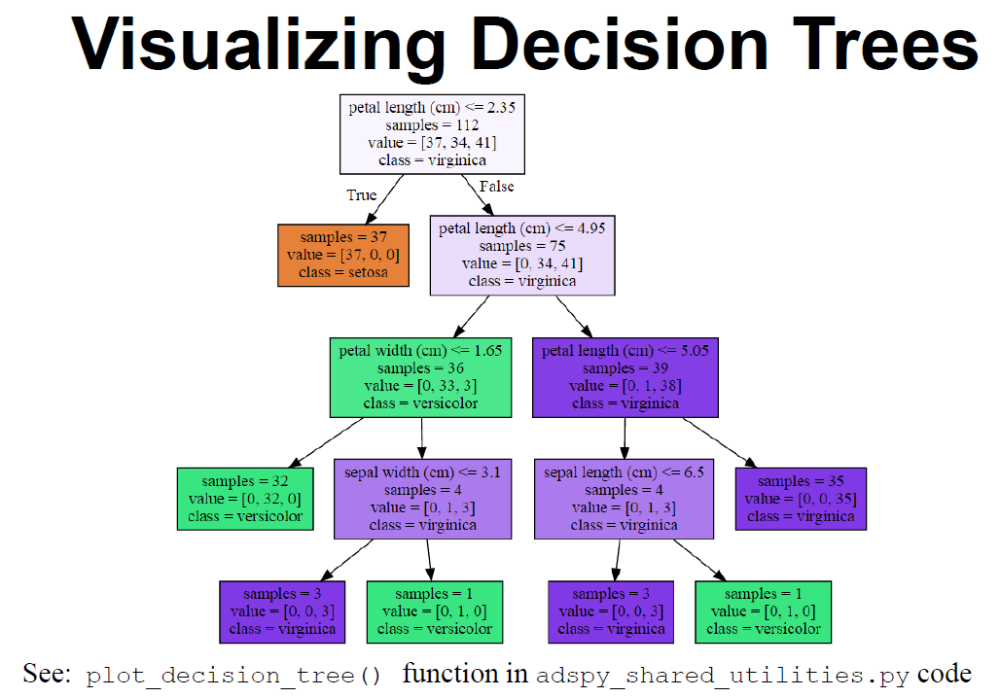

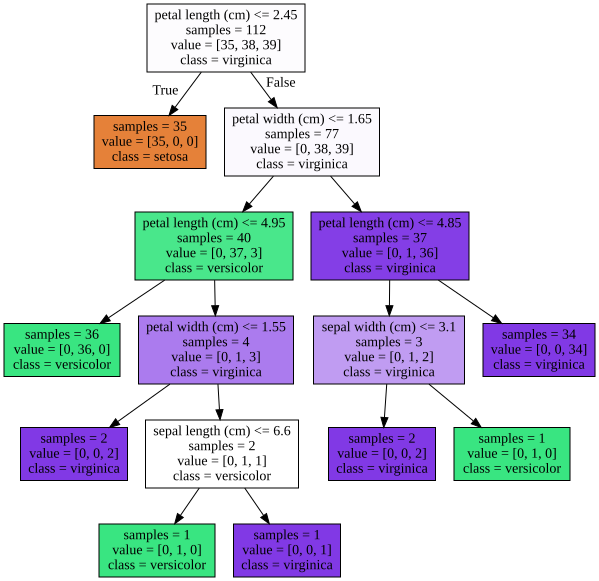

In [75]:
plot_decision_tree(clf, iris.feature_names, iris.target_names)

#### Pre-pruned version (max_depth = 3)

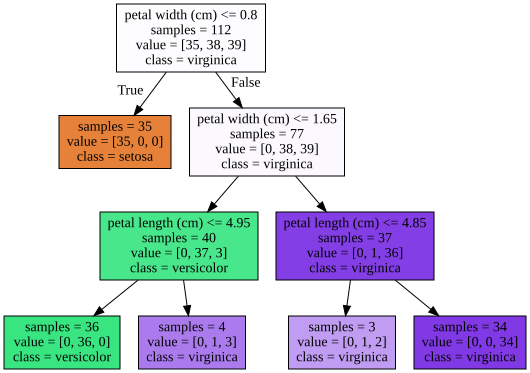

In [76]:
plot_decision_tree(clf2, iris.feature_names, iris.target_names)

#### Feature importance

Another way of analyzing the tree instead of looking at the whole tree at once is to do what's called a feature importance calculation. And this is one of the most useful and widely used types of summary analysis you can perform on a supervised learning model. Feature importance is typically a number between 0 and 1 that's assigned to an individual feature. It indicates how important that feature is to the overall prediction accuracy. A feature importance of 0 means that the feature is not used at all in the prediction. A feature importance of 1, means the feature perfectly predicts the target. Typically, feature importance numbers are always positive and they're normalized so they sum to one. 

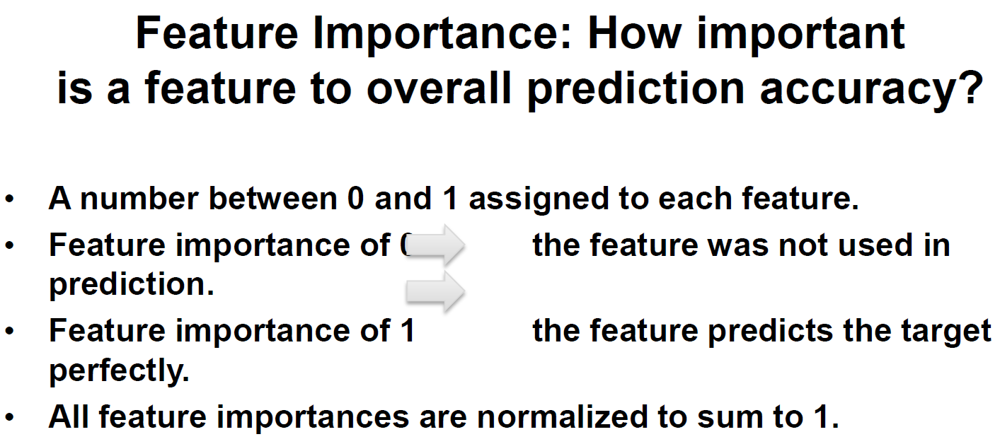

In scikit-learn, feature importance values are stored as a list in an estimated property called feature_importances_. And note the underscore at the end of the name which indicates it's a property of the object that's set as a result of fitting the model and not as a user defined property. The shared utilities python file contains a function called plot_feature_importances, that you can import and use to visualize feature importance. It plots a horizontal bar chart with the features listed along the y axis by name and feature importance along the x axis. 

C:\Users\redex\Anaconda3\lib\site-packages\matplotlib\pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


<IPython.core.display.Javascript object>


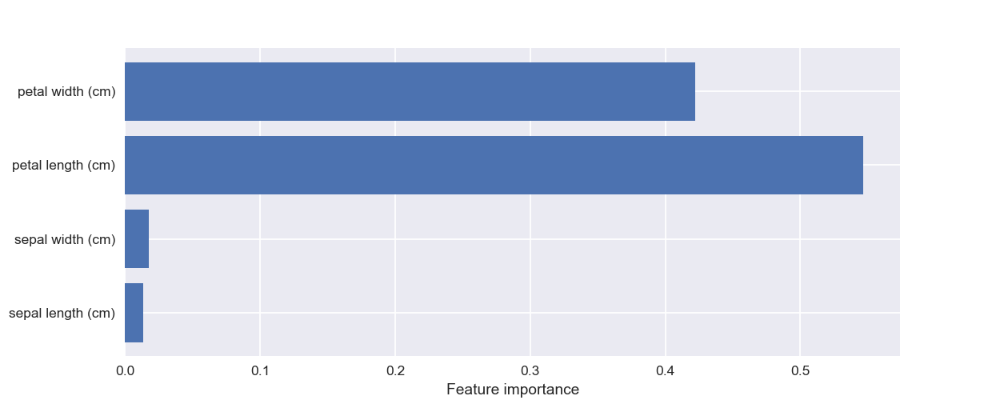

Feature importances: [0.01 0.02 0.55 0.42]


In [77]:
from adspy_shared_utilities import plot_feature_importances

plt.figure(figsize=(10,4), dpi=80)
plot_feature_importances(clf, iris.feature_names)
plt.show()

print('Feature importances: {}'.format(clf.feature_importances_))

Here's the feature importance chart for the iris decision tree and this example for this particular train/test split of the iris data set. The pedal length feature easily has the largest feature importance weight. We can confirm this by looking at the decision tree that this is indeed corresponds to that features position at the top of the decision tree, showing that this first level just using the petal length feature does a good job splitting the turning data into separate classes. Note that if a feature has a low feature importance value, that doesn't necessarily mean that the feature is not important for prediction. It simply means that the particular feature wasn't chosen at an early level of the tree and this could be because the feature may be identical or highly correlated with another informative feature and so doesn't provide any new additional signal for prediction. 

Feature importance values don't tell us which specific classes a feature might be especially predictive for, and they also don't indicate more complex relationships between features that may influence prediction. Even so the feature importance values provide an easy to understand summary that can give useful insight about individual features in the learning model. Because feature importance can vary depending on the specific model learned for a particular train/test split for example, it's common when computing feature importance to use an average over multiple train/test splits. For example when performing cross-validation. 

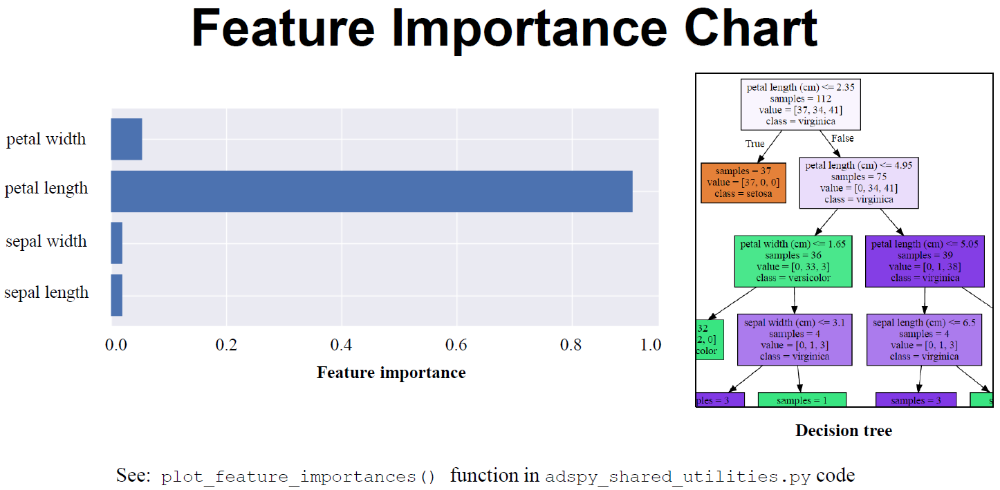

C:\Users\redex\Anaconda3\lib\site-packages\matplotlib\pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


<IPython.core.display.Javascript object>


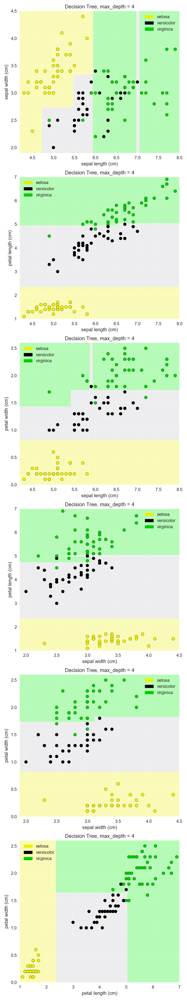

In [78]:
from sklearn.tree import DecisionTreeClassifier
from adspy_shared_utilities import plot_class_regions_for_classifier_subplot

X_train, X_test, y_train, y_test = train_test_split(iris.data, iris.target, random_state = 0)
fig, subaxes = plt.subplots(6, 1, figsize=(6, 32))

pair_list = [[0,1], [0,2], [0,3], [1,2], [1,3], [2,3]]
tree_max_depth = 4

for pair, axis in zip(pair_list, subaxes):
    X = X_train[:, pair]
    y = y_train
    
    clf = DecisionTreeClassifier(max_depth=tree_max_depth).fit(X, y)
    title = 'Decision Tree, max_depth = {:d}'.format(tree_max_depth)
    plot_class_regions_for_classifier_subplot(clf, X, y, None,
                                             None, title, axis,
                                             iris.target_names)
    
    axis.set_xlabel(iris.feature_names[pair[0]])
    axis.set_ylabel(iris.feature_names[pair[1]])
    
plt.tight_layout()
plt.show()

#### Decision Trees on a real-world dataset

Finally let's apply decision trees to the breast cancer data set that we've been using across multiple supervised learning algorithms. Here we're controlling the model complexity by setting the max depth and min samples leaf parameters. And we've included the visualization of the resulting tree here followed by a feature importance plot. As an exercise, try removing these two parameters to just use the default settings to see the effect on test set accuracy and the increase in overfitting that occurs. For this training set, the mean concave points feature gives the most informative initial split, followed by the worst area parameter.

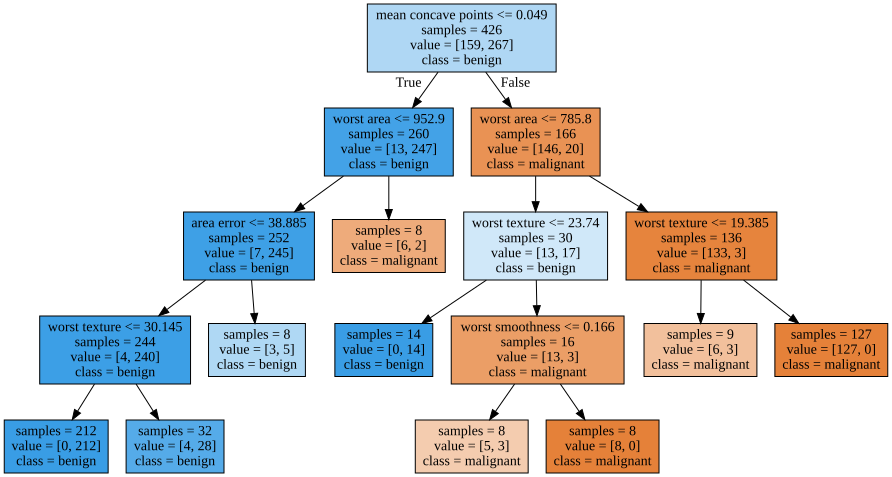

In [79]:
from sklearn.tree import DecisionTreeClassifier
from adspy_shared_utilities import plot_decision_tree
from adspy_shared_utilities import plot_feature_importances

X_train, X_test, y_train, y_test = train_test_split(X_cancer, y_cancer, random_state = 0)

clf = DecisionTreeClassifier(max_depth = 4, min_samples_leaf = 8,
                            random_state = 0).fit(X_train, y_train)

plot_decision_tree(clf, cancer.feature_names, cancer.target_names)

Breast cancer dataset: decision tree
Accuracy of DT classifier on training set: 0.96
Accuracy of DT classifier on test set: 0.94


C:\Users\redex\Anaconda3\lib\site-packages\matplotlib\pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


<IPython.core.display.Javascript object>


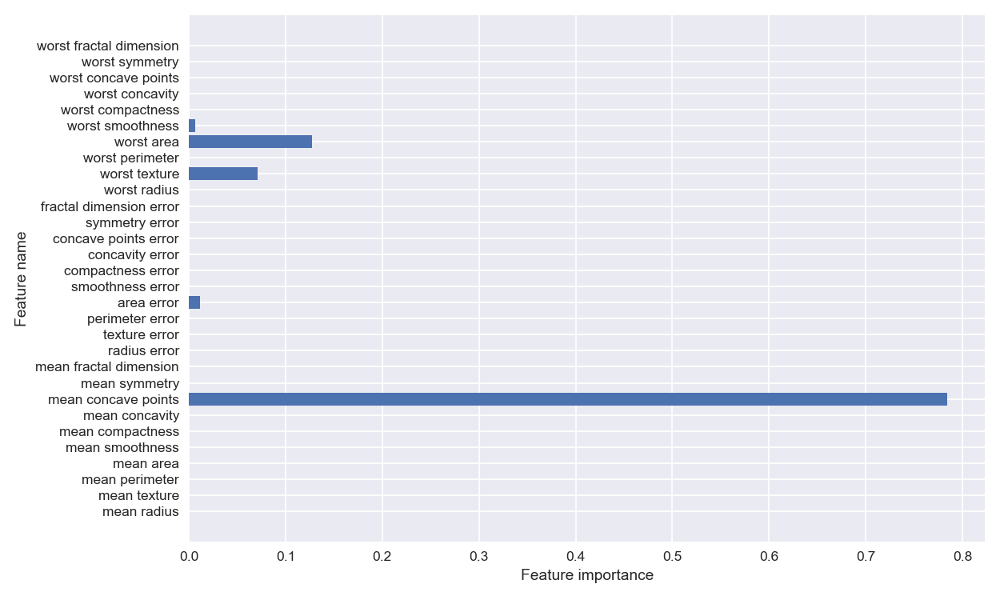

In [80]:
print('Breast cancer dataset: decision tree')
print('Accuracy of DT classifier on training set: {:.2f}'
     .format(clf.score(X_train, y_train)))
print('Accuracy of DT classifier on test set: {:.2f}'
     .format(clf.score(X_test, y_test)))

plt.figure(figsize=(10,6),dpi=80)
plot_feature_importances(clf, cancer.feature_names)
plt.tight_layout()

plt.show()

One of the major advantages of decision trees as a supervised learning method, is that the decision rules are easily visualized and interpreted by people including users without machine learning expertise. This makes decision trees a useful choice for getting an initial understanding of what some of the more important features are likely to be for a particular prediction task. 

Another advantage of decision trees is that you can use them without having to do feature pre-processing or normalization. Since each feature is processed independently and the splitting of the data doesn't depend on the absolute scale of the feature, the decision algorithm can operate on the original training data pretty much as is. So decision trees tend to work well with data sets that have a mixture of feature types-- binary, categorical or continuous and with features that are on very different scales. 

One drawback of decision trees is that despite the use of pruning they can still overfit all or parts of the data and may not achieve the best generalization performance compared to other methods. One way to overcome that problem is to create what's called an ensemble of decision trees which combines multiple decision trees to make a prediction and will look at ensembles of decision trees in the following lecture. 

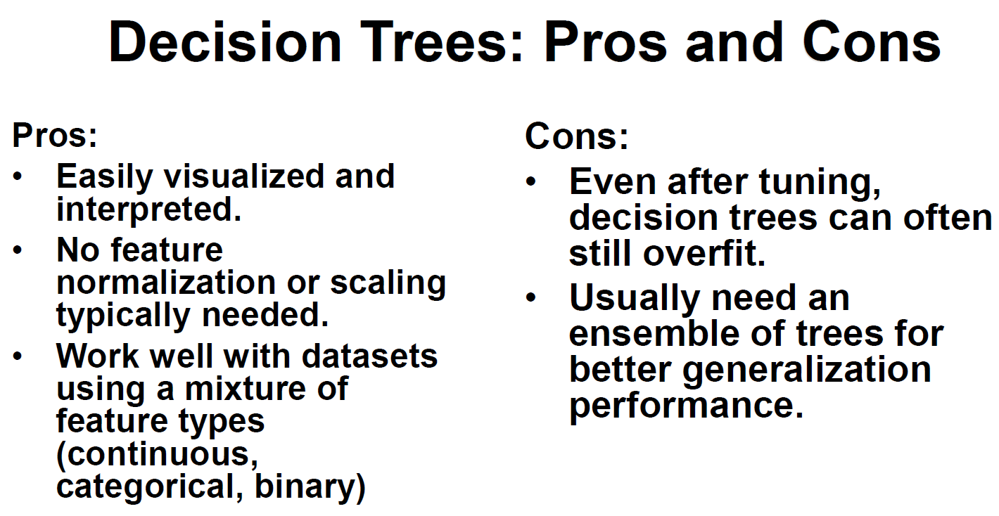

So to recap, scikit-learn enables you to control the model complexity of your decision trees with three key parameters. 

First, max depth controls the maximum depth or the number of split points the decision can have and it's probably the most common parameter used to reduce tree complexity and thus reduce overfitting. 

The min samples leaf parameter is the threshold that controls what the minimum number of data instances has to be in a leaf to avoid splitting it further. This setting also reduces tree complexity. 

Finally, max leaf nodes limits the total number of nodes that are leaves of the tree. In effect, setting this parameter will indirectly influence the other two parameters and vice versa. 

So in practice, adjusting only one of these three is typically enough to control most overfitting. Although even with the most optimized parameter settings, individual decision trees will still tend to overfit.

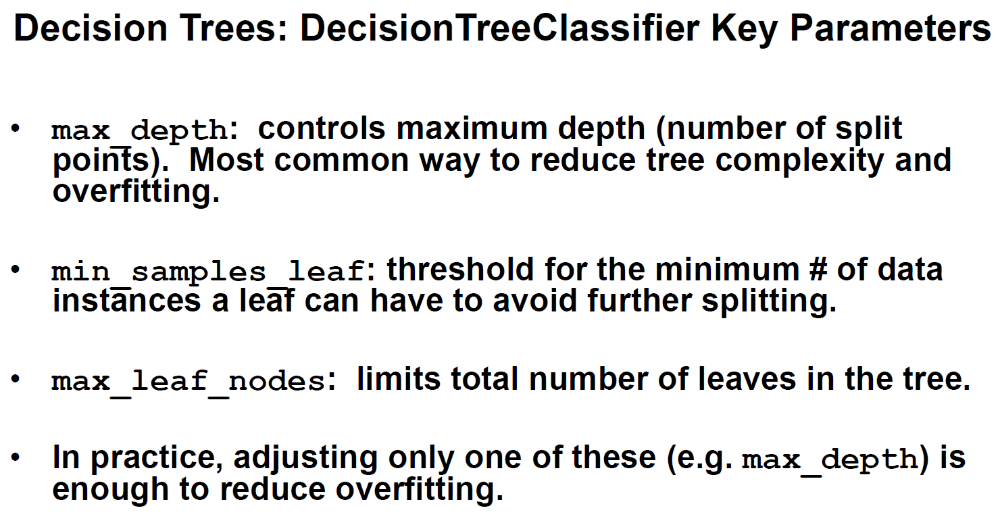